# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [3]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [4]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [5]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [6]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [7]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [8]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm - 1)**2)
    #### END CODE HERE ####
    return penalty

In [9]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -1. * torch.mean(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [11]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [12]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda * gp
    #### END CODE HERE ####
    return crit_loss

In [13]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.08923943084198982, critic loss: 1.8937322450280185


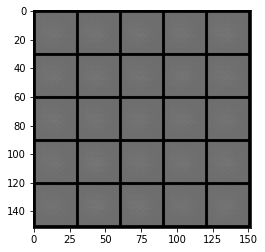

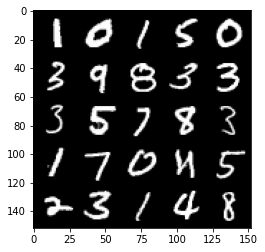

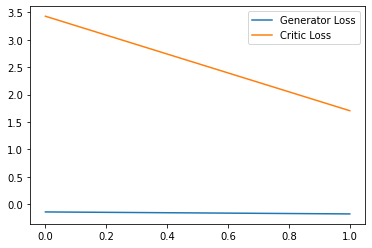

Step 100: Generator loss: 0.9444117869436741, critic loss: -1.89357088252902


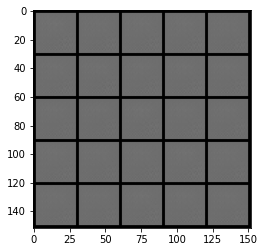

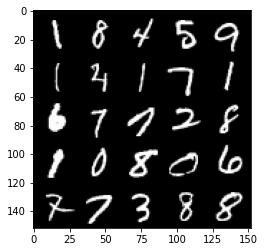

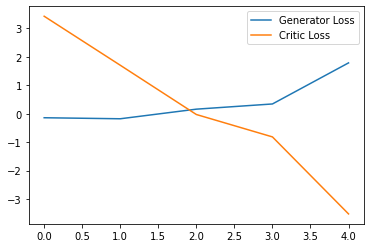

Step 150: Generator loss: 2.518451669216156, critic loss: -10.9574544506073


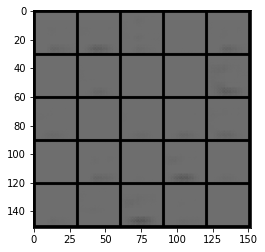

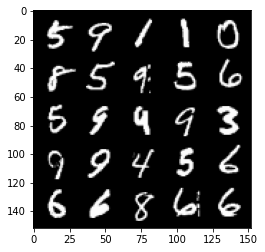

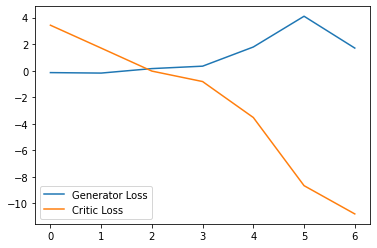

Step 200: Generator loss: -0.3773805313557386, critic loss: -26.484831314086914


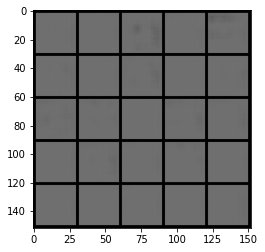

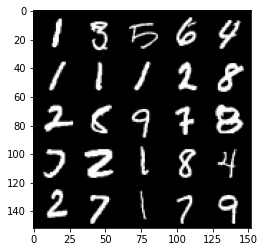

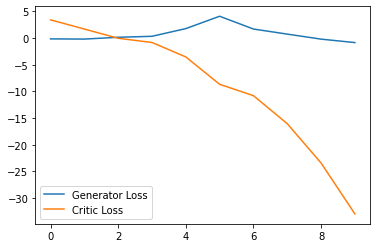

Step 250: Generator loss: -0.9248851612210274, critic loss: -55.362457931518556


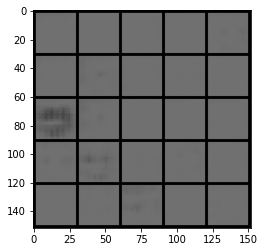

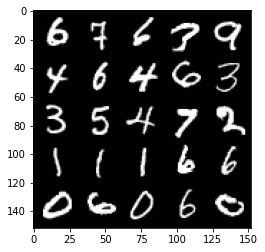

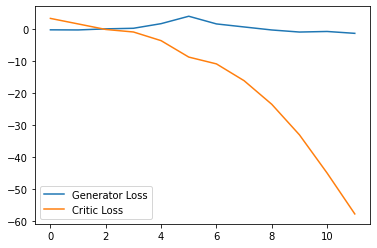

Step 300: Generator loss: 0.6271858036518096, critic loss: -94.7006792755127


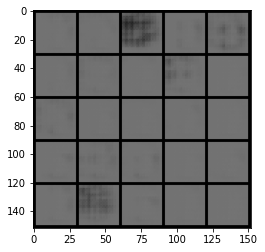

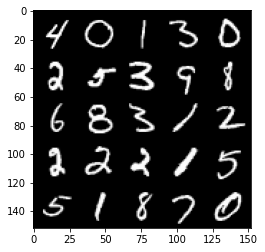

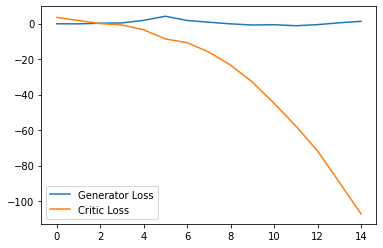

Step 350: Generator loss: 3.5240769529342653, critic loss: -141.68458605957028


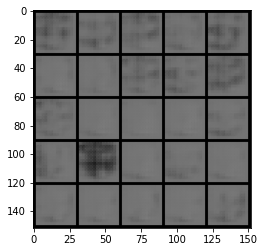

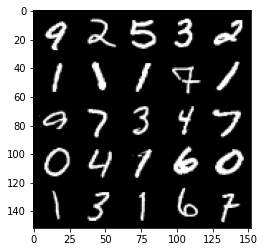

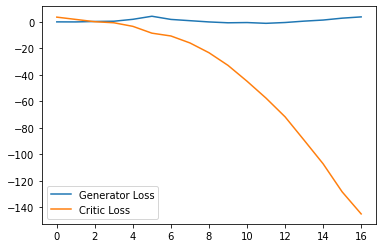

Step 400: Generator loss: 7.004288969039917, critic loss: -193.39630957031252


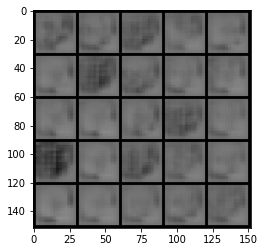

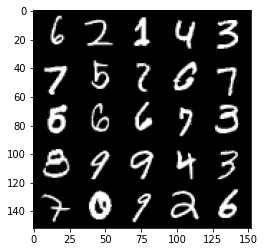

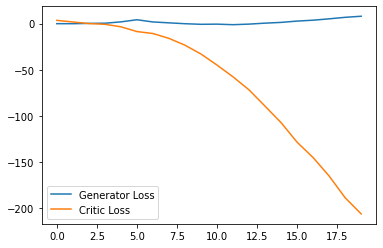

Step 450: Generator loss: 9.979863328933716, critic loss: -232.67480947875978


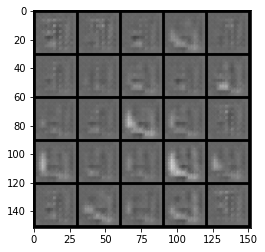

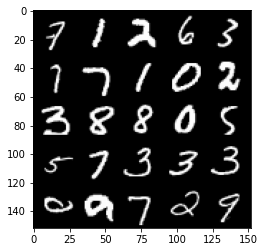

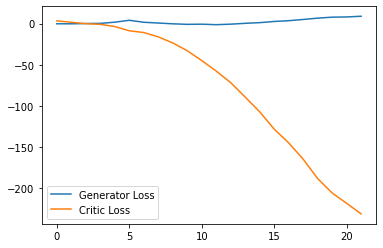

Step 500: Generator loss: 13.680456590652465, critic loss: -280.2795356445313


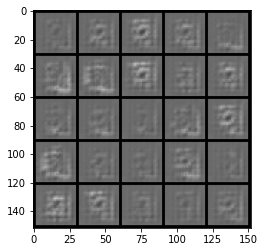

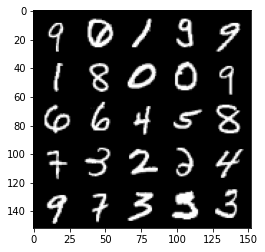

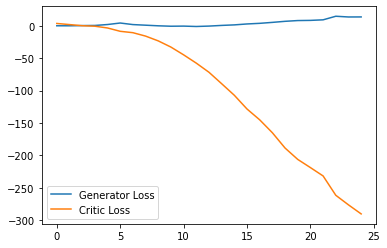

Step 550: Generator loss: 4.328188514709472, critic loss: -301.6762299194336


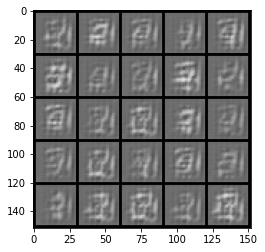

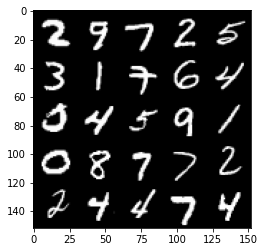

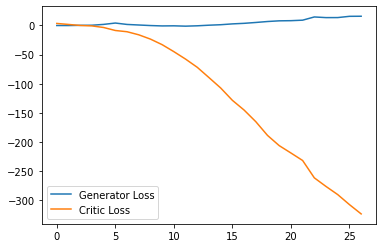

Step 600: Generator loss: -16.420334129333497, critic loss: -239.78319827270514


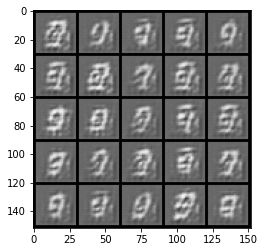

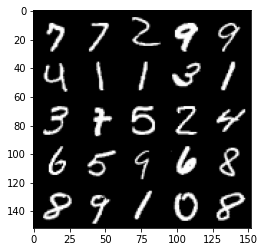

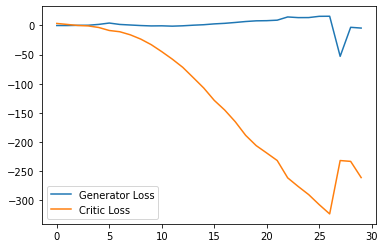

Step 650: Generator loss: 35.043690991401675, critic loss: -334.39834573364254


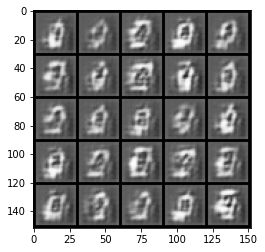

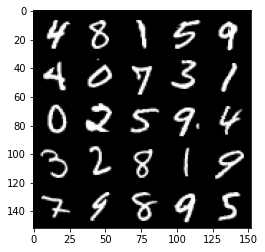

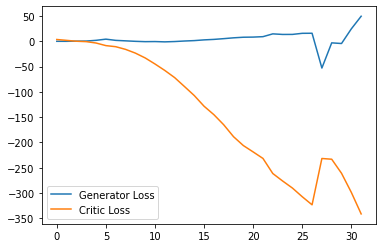

Step 700: Generator loss: -1.962338526546955, critic loss: -294.0921524047852


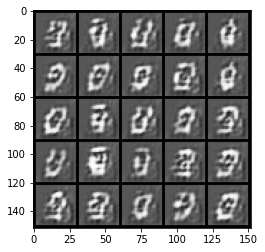

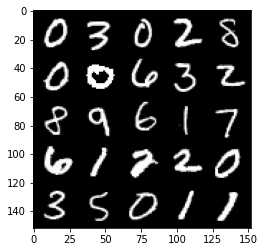

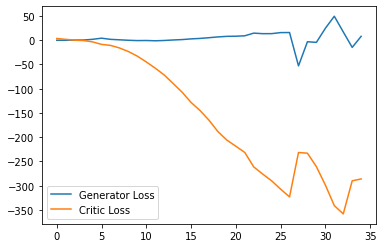

Step 750: Generator loss: -13.814829149246215, critic loss: -236.15859704589838


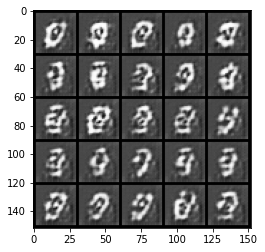

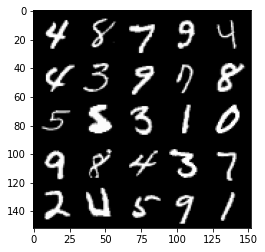

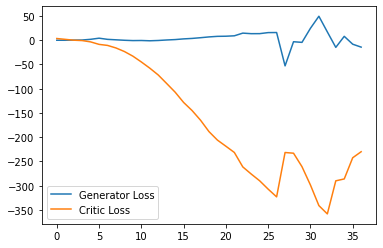

Step 800: Generator loss: -44.15774229347706, critic loss: -166.16319546508788


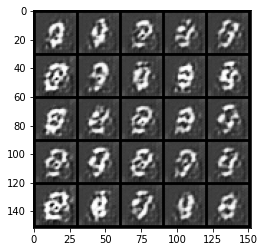

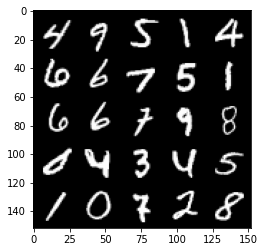

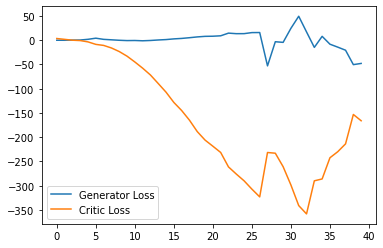

Step 850: Generator loss: -23.945124549865724, critic loss: -84.41608267211913


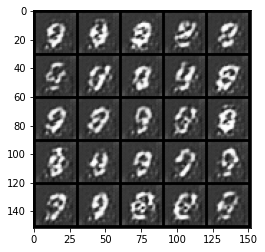

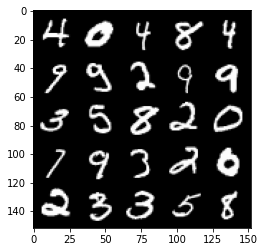

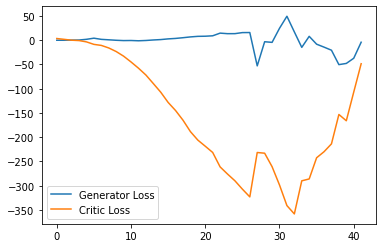

Step 900: Generator loss: -43.308278042078015, critic loss: -105.91055390167236


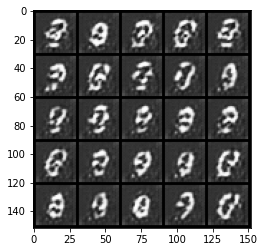

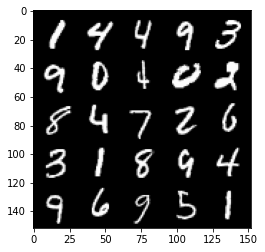

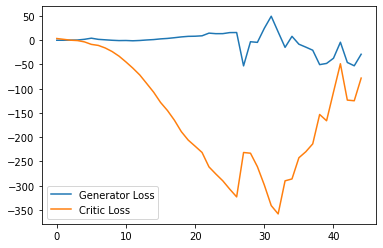

Step 950: Generator loss: -36.89309782981873, critic loss: -79.82215297698974


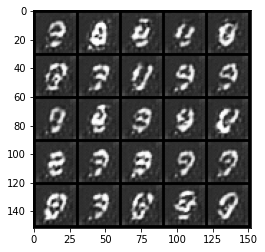

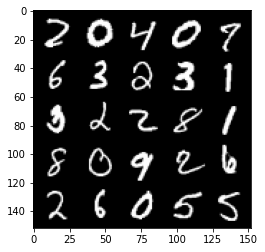

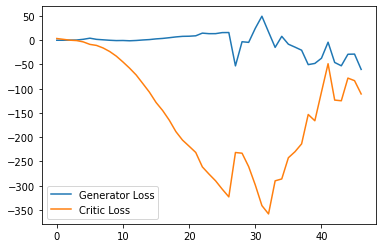

Step 1000: Generator loss: -39.8734965801239, critic loss: -100.3773419494629


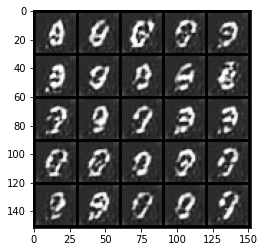

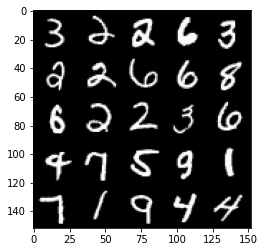

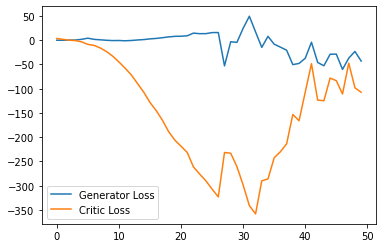

Step 1050: Generator loss: 6.475450611114502, critic loss: -9.439373962402339


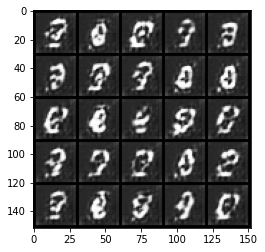

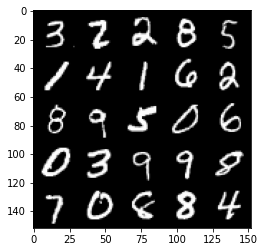

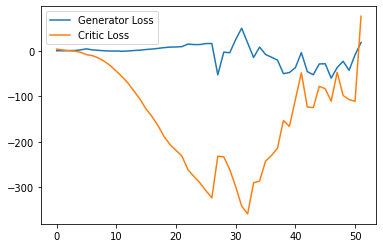

Step 1100: Generator loss: 7.903887119293213, critic loss: 3.396334810256958


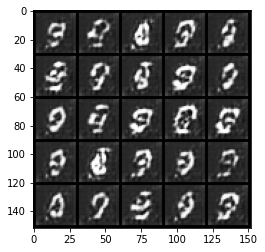

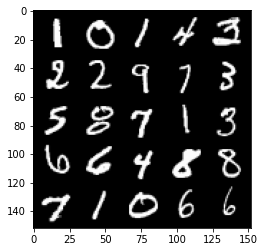

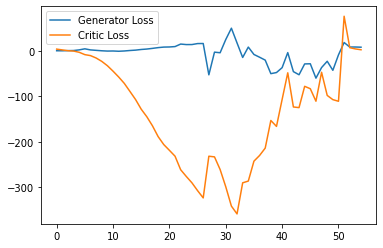

Step 1150: Generator loss: 5.851739292144775, critic loss: 3.1032199783325187


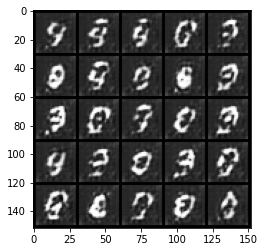

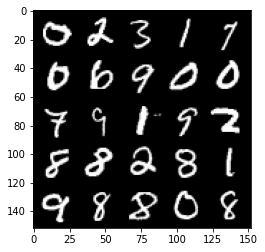

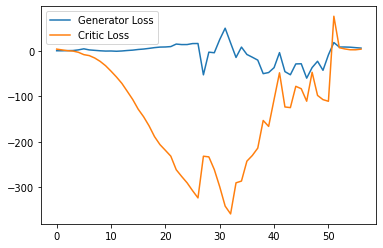

Step 1200: Generator loss: 3.4750054836273194, critic loss: 7.413862182617184


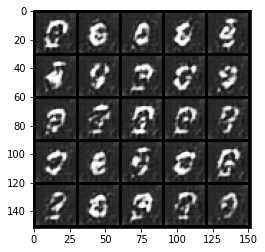

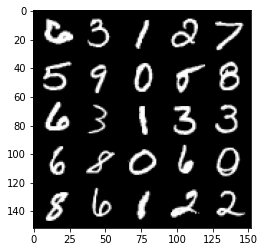

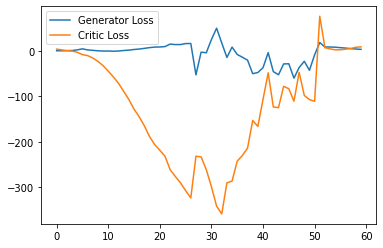

Step 1250: Generator loss: 2.778665773868561, critic loss: 6.51421559715271


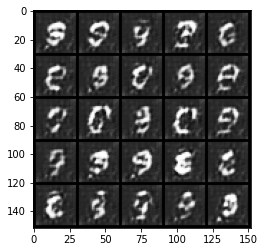

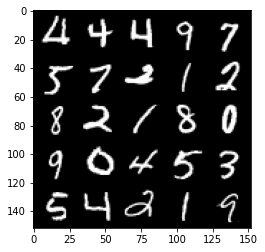

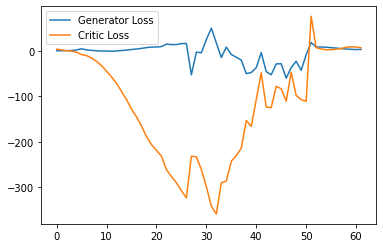

Step 1300: Generator loss: 3.726376385688782, critic loss: 4.1873983325958255


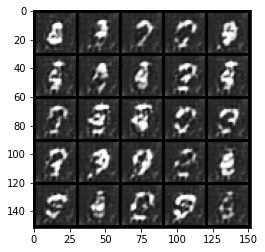

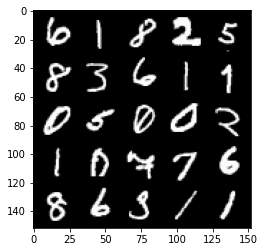

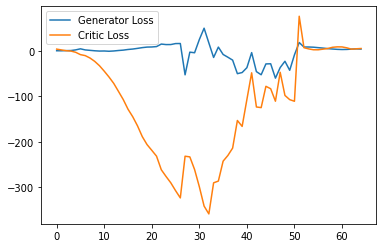

Step 1350: Generator loss: 2.8139557361602785, critic loss: 4.911097620010377


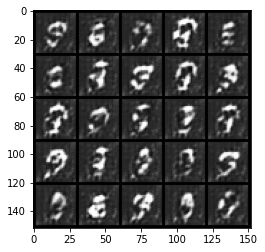

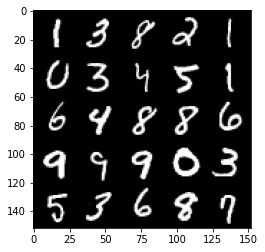

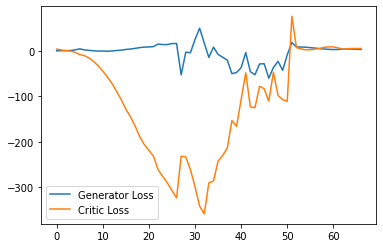

Step 1400: Generator loss: 1.954295666217804, critic loss: 4.75504172039032


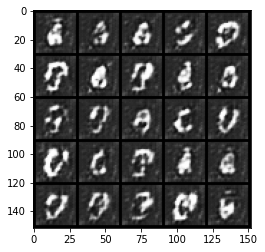

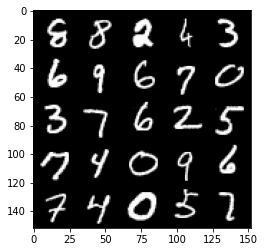

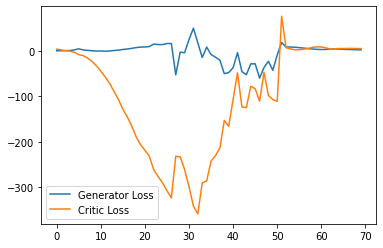

Step 1450: Generator loss: 1.359567821621895, critic loss: 8.563135908126831


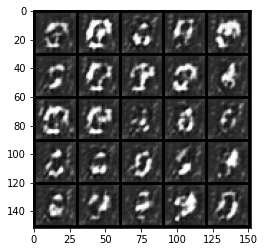

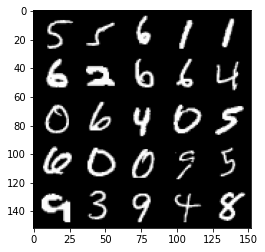

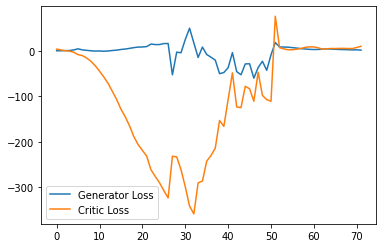

Step 1500: Generator loss: -0.8898802226781846, critic loss: 6.062120915412903


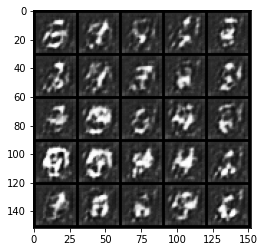

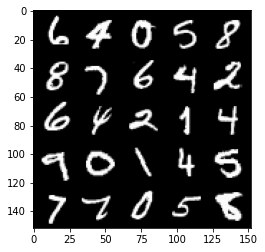

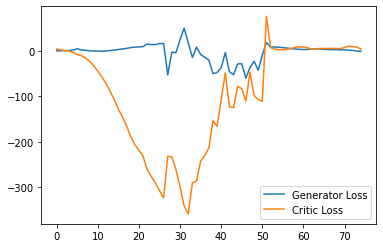

Step 1550: Generator loss: -2.272621924877167, critic loss: 0.23323297882080063


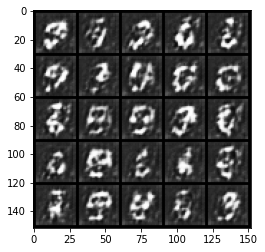

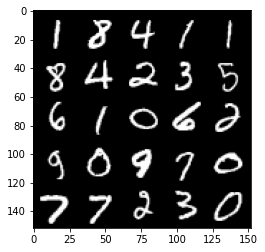

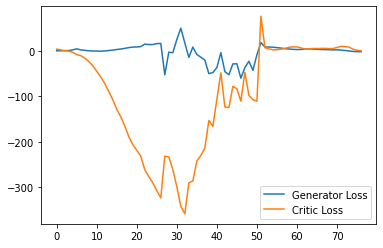

Step 1600: Generator loss: -2.9921129655838015, critic loss: -1.3110812015533444


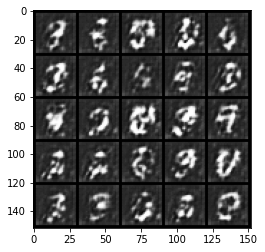

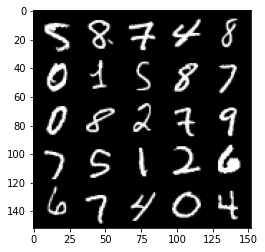

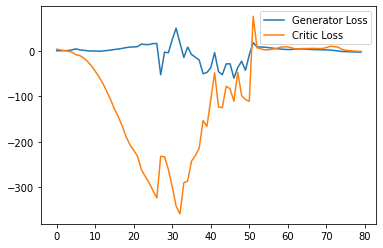

Step 1650: Generator loss: -2.7798126411437987, critic loss: -3.302457689285278


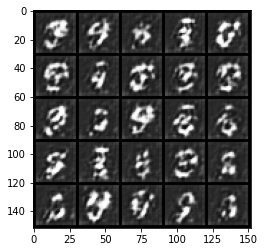

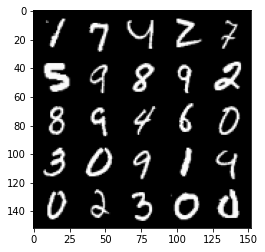

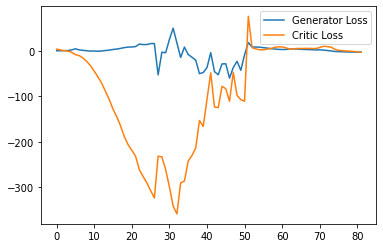

Step 1700: Generator loss: -2.1565325558185577, critic loss: -6.336973503112794


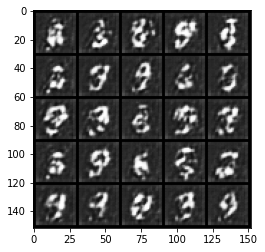

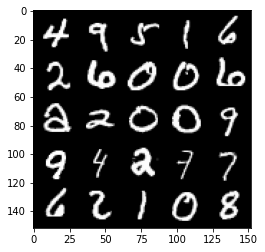

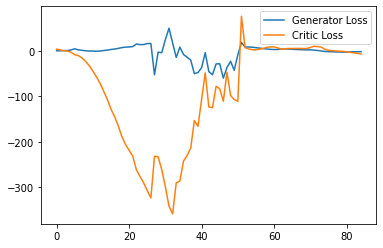

Step 1750: Generator loss: -1.3387772339582442, critic loss: -7.833652927398682


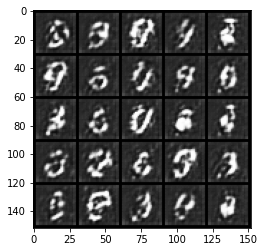

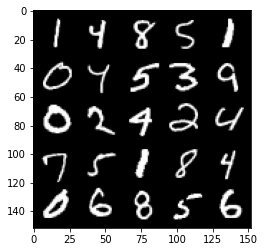

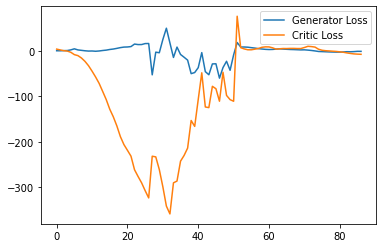

Step 1800: Generator loss: 0.22465721532702446, critic loss: -9.920124288558961


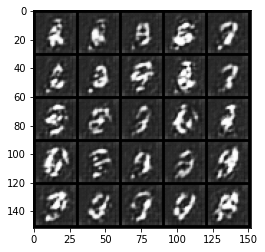

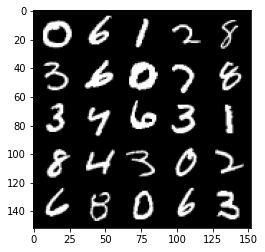

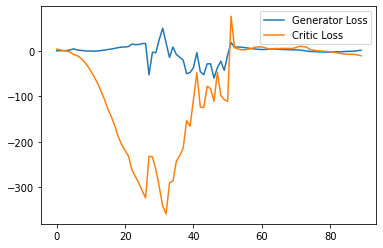

Step 1850: Generator loss: 0.6967402848601342, critic loss: -14.94339577293396


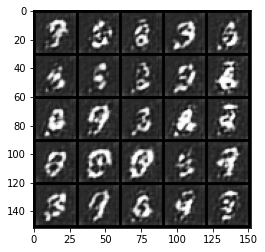

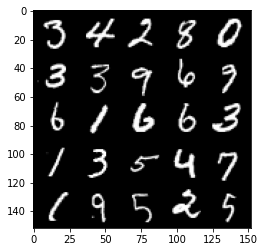

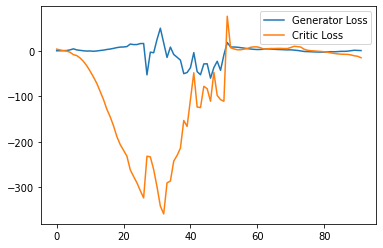

Step 1900: Generator loss: 3.742545702457428, critic loss: -20.704636466979977


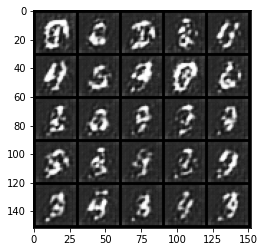

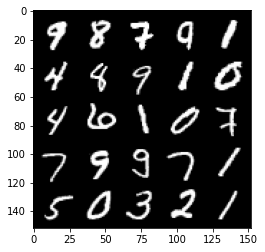

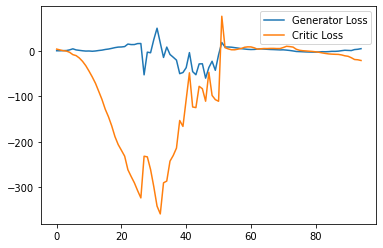

Step 1950: Generator loss: 6.826471219062805, critic loss: -24.314472209930422


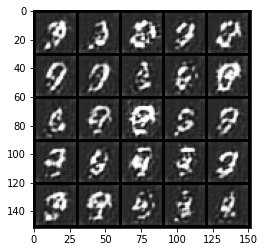

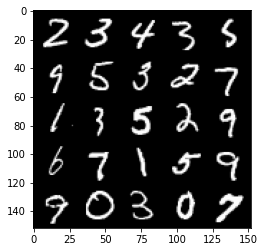

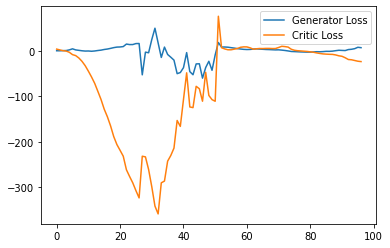

Step 2000: Generator loss: 8.584516212940215, critic loss: -27.02562508773804


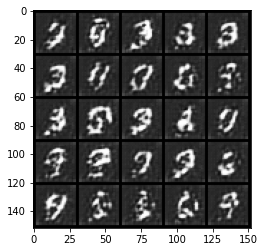

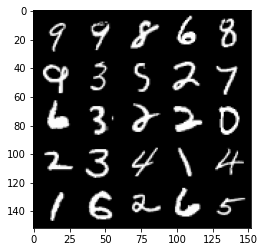

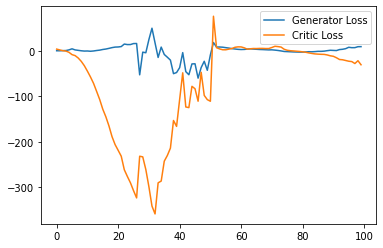

Step 2050: Generator loss: 10.171410531997681, critic loss: -33.33805408096314


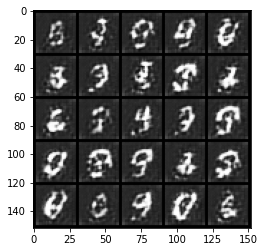

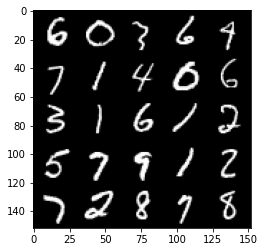

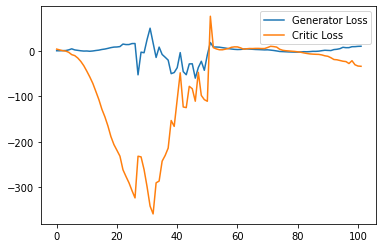

Step 2100: Generator loss: 11.785373840332031, critic loss: -36.42086659240722


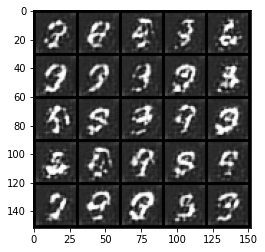

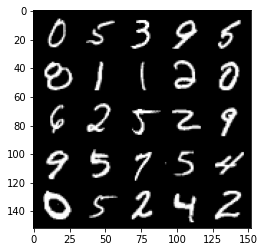

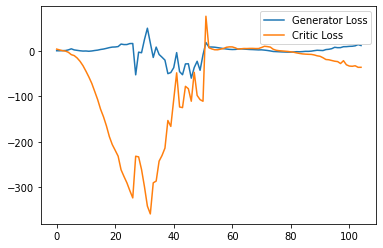

Step 2150: Generator loss: 11.360459764003753, critic loss: -36.25655995178222


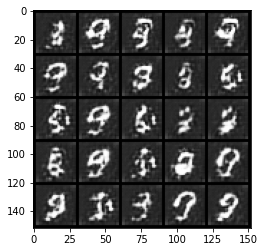

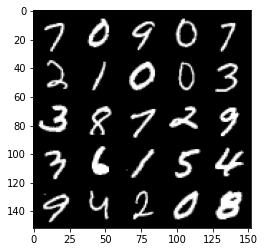

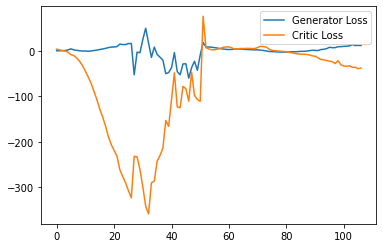

Step 2200: Generator loss: 9.741110489368438, critic loss: -43.19176240158081


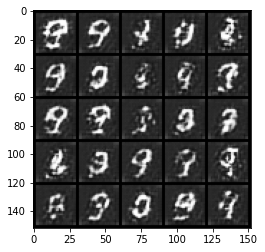

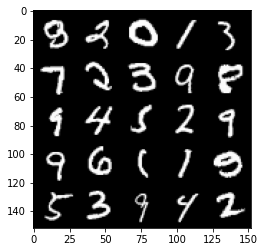

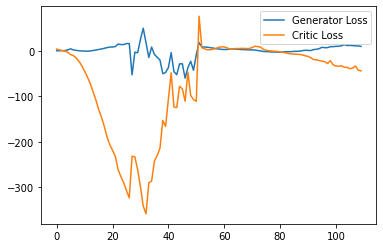

Step 2250: Generator loss: 9.221174762248992, critic loss: -42.17227590179443


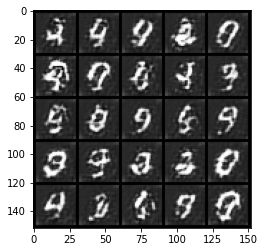

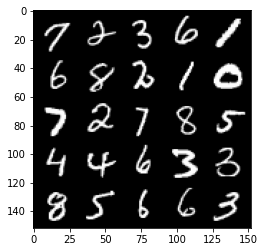

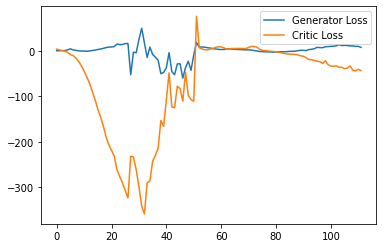

Step 2300: Generator loss: 10.035632574558258, critic loss: -42.177819646835324


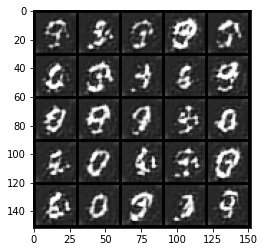

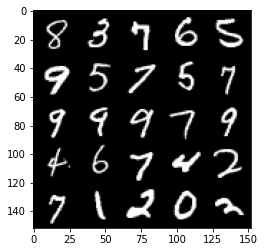

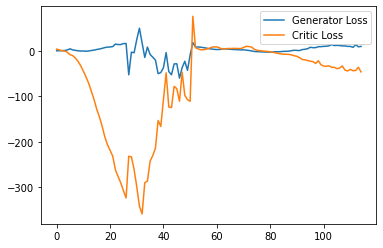

Step 2350: Generator loss: 6.909465340971947, critic loss: -46.933547649383534


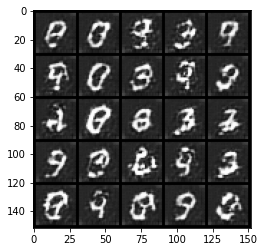

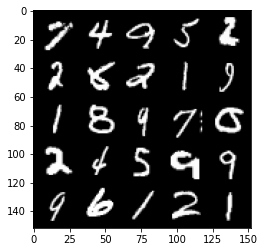

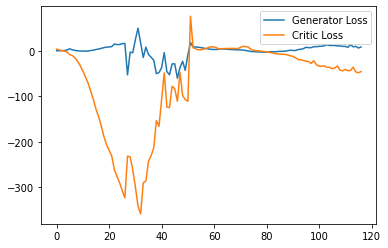

Step 2400: Generator loss: 6.993123397678136, critic loss: -45.65116519546508


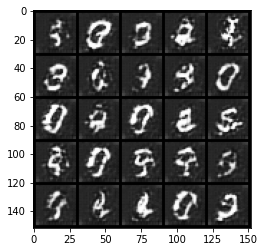

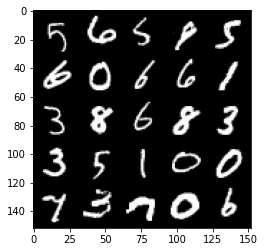

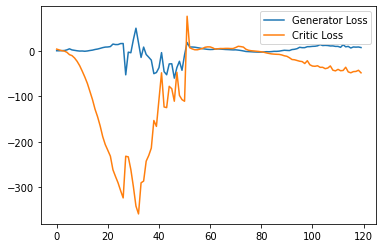

Step 2450: Generator loss: 2.0234571266174317, critic loss: -46.942770191192615


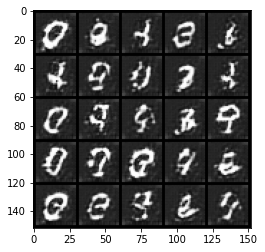

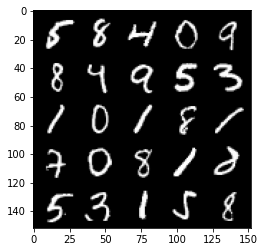

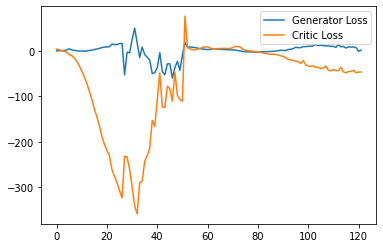

Step 2500: Generator loss: 3.808423333391547, critic loss: -49.837281654357895


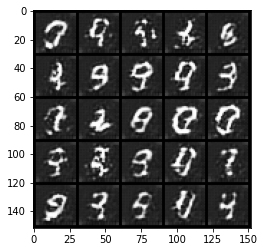

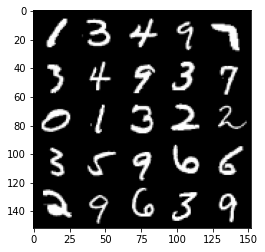

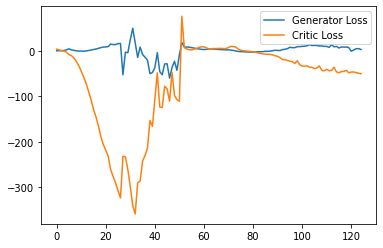

Step 2550: Generator loss: 1.9747357416152953, critic loss: -45.663413139343284


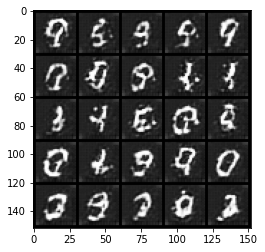

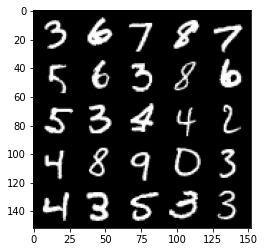

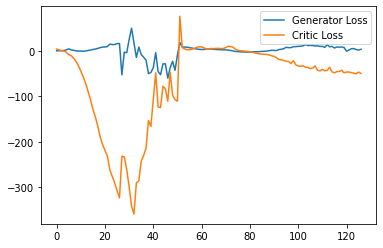

Step 2600: Generator loss: 0.4148277980089188, critic loss: -43.673832118988045


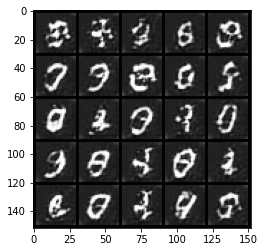

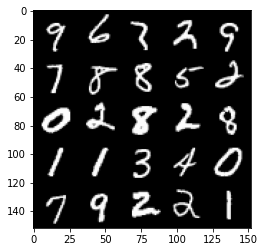

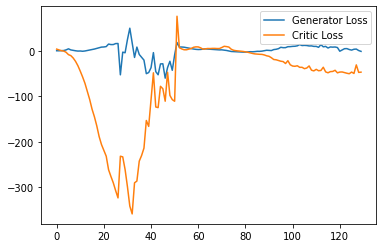

Step 2650: Generator loss: 1.0248140373826027, critic loss: -43.60970712280273


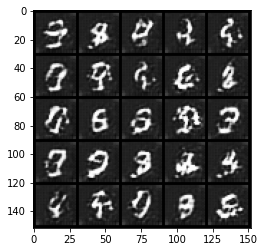

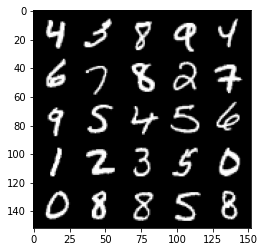

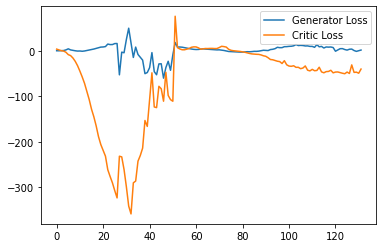

Step 2700: Generator loss: -1.1671941697597503, critic loss: -39.930249388694754


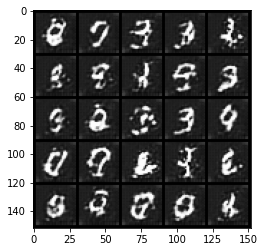

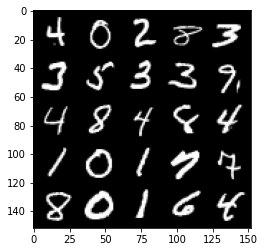

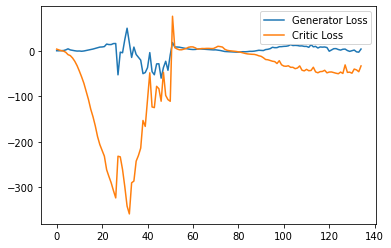

Step 2750: Generator loss: 1.6084434509277343, critic loss: -25.05490773010253


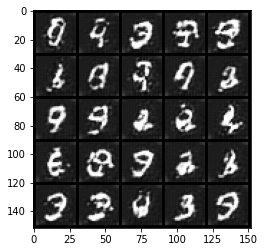

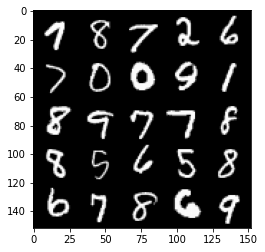

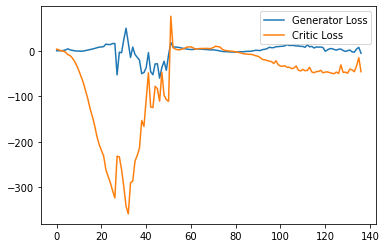

Step 2800: Generator loss: 6.3536640071868895, critic loss: -2.8247894067764276


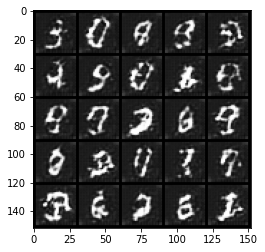

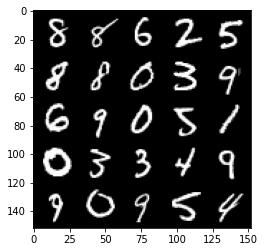

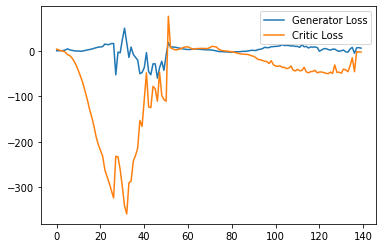

Step 2850: Generator loss: 0.21146412074565887, critic loss: -9.182024052619935


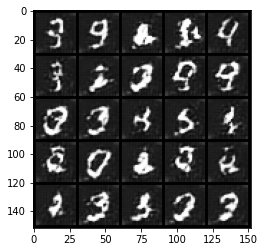

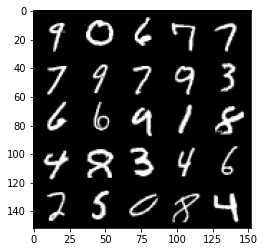

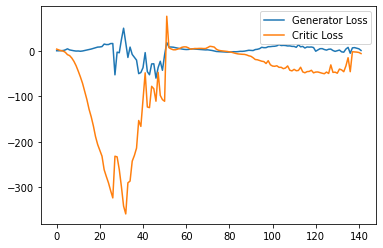

Step 2900: Generator loss: -4.487382010221482, critic loss: -22.857121355056766


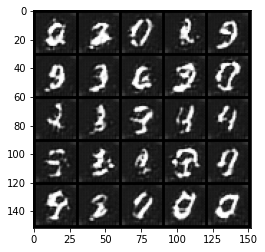

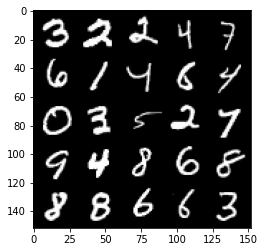

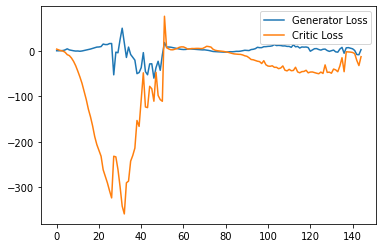

Step 2950: Generator loss: -3.9991736936569215, critic loss: -31.572954002380374


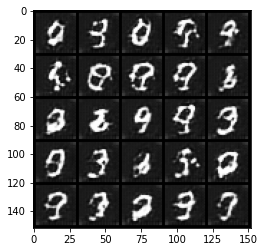

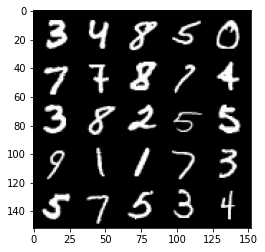

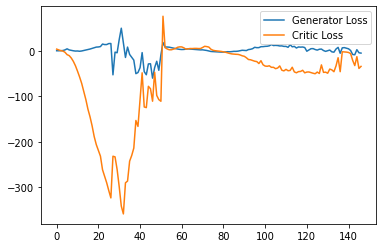

Step 3000: Generator loss: -3.9399652591347696, critic loss: -25.82011075496675


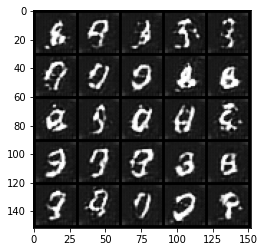

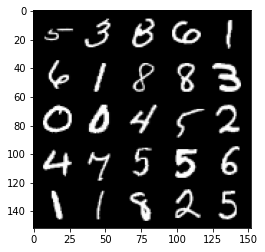

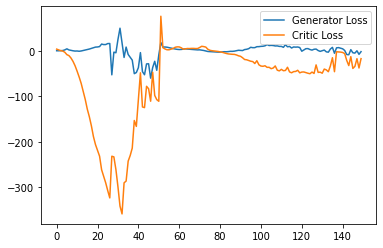

Step 3050: Generator loss: 7.029138832092285, critic loss: -2.7868644618988037


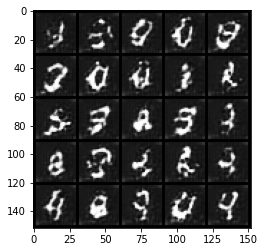

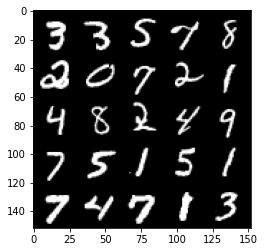

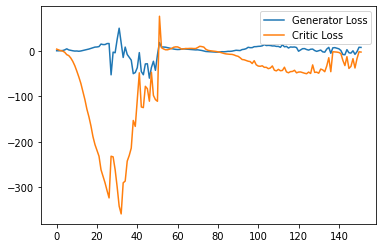

Step 3100: Generator loss: -5.456327258348465, critic loss: -14.997952263832094


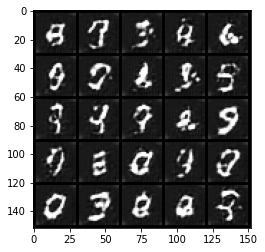

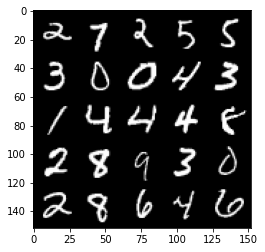

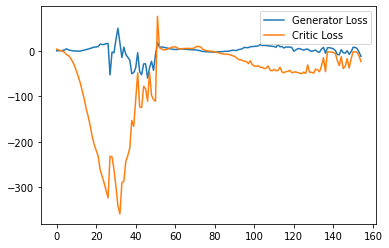

Step 3150: Generator loss: -1.3231996041536331, critic loss: -8.050490804672236


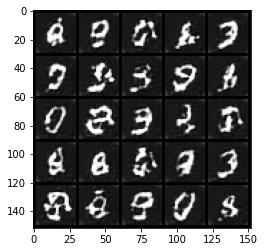

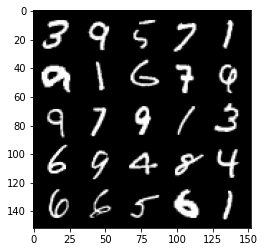

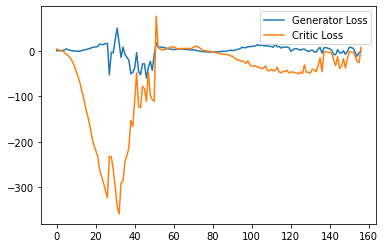

Step 3200: Generator loss: 4.8867328119277955, critic loss: -1.869990341186523


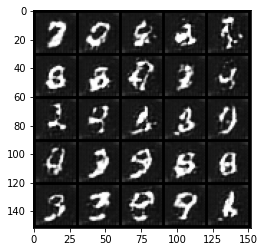

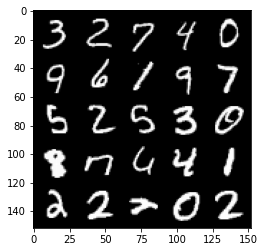

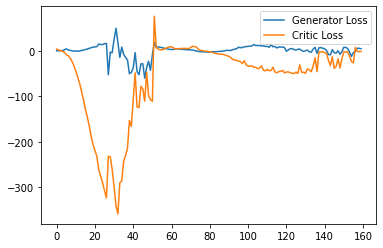

Step 3250: Generator loss: 2.7443889570236206, critic loss: -2.086906910419464


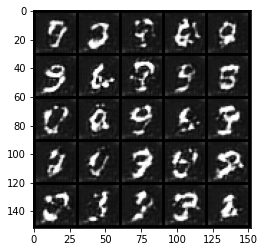

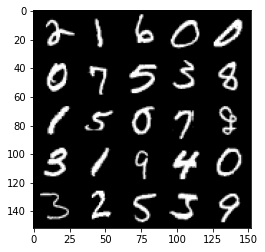

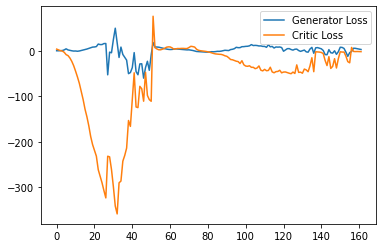

Step 3300: Generator loss: -0.09057799465954304, critic loss: -2.4542356948852544


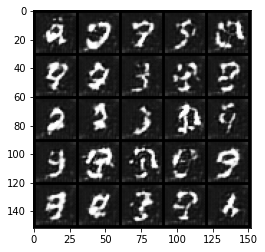

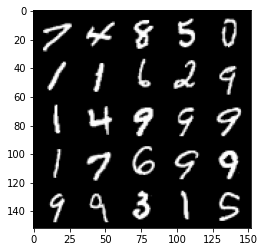

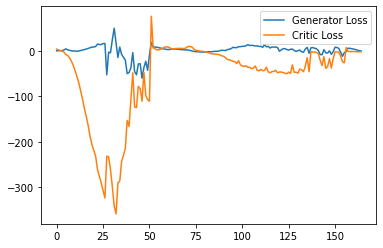

Step 3350: Generator loss: -1.3385608518123626, critic loss: -2.9061583909988404


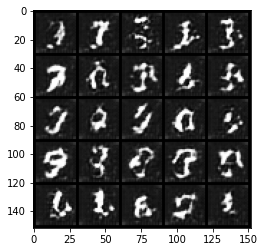

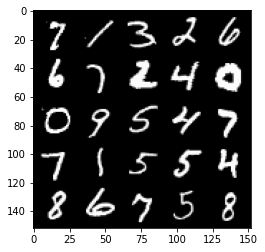

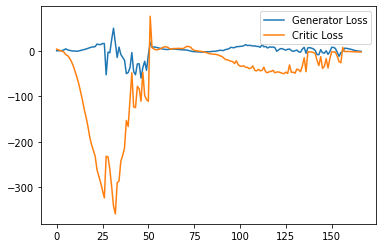

Step 3400: Generator loss: -2.444897422194481, critic loss: -5.547084142684935


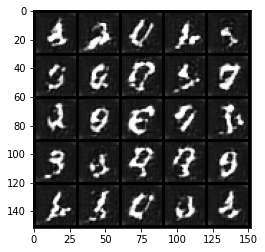

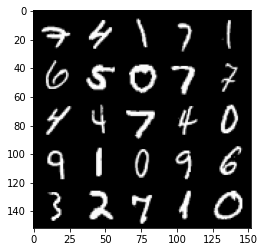

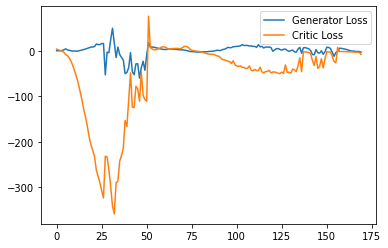

Step 3450: Generator loss: -5.716583194732666, critic loss: -6.476914436817168


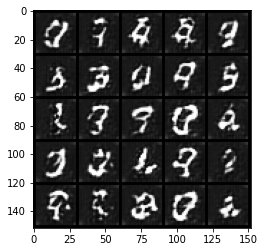

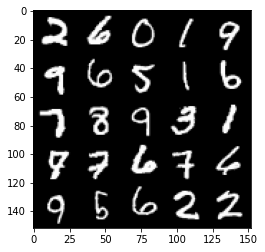

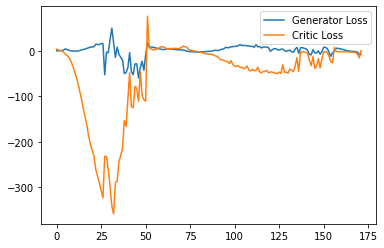

Step 3500: Generator loss: 3.7239860677719117, critic loss: -2.2175356688499455


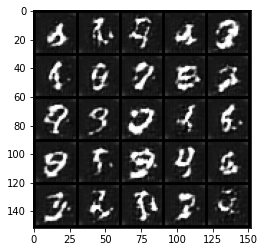

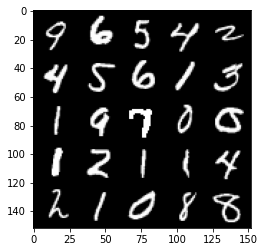

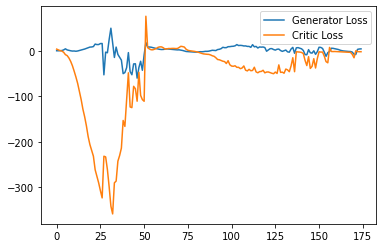

Step 3550: Generator loss: 2.4874454402923583, critic loss: -2.145495791912079


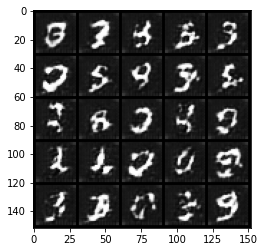

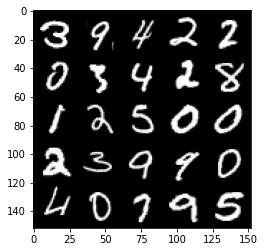

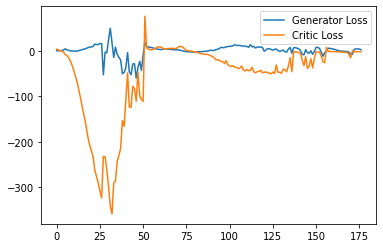

Step 3600: Generator loss: -0.4960229763388634, critic loss: -2.9289408860206594


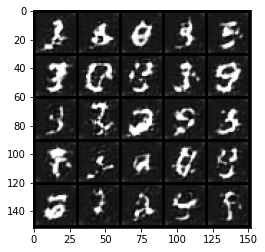

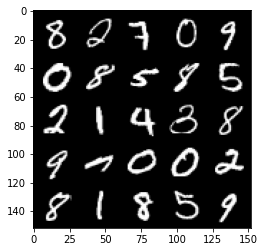

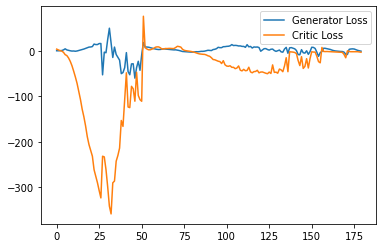

Step 3650: Generator loss: -4.8255305051803585, critic loss: -10.663270253181457


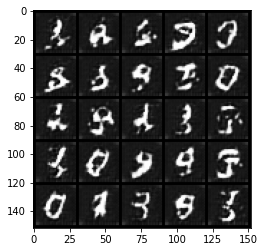

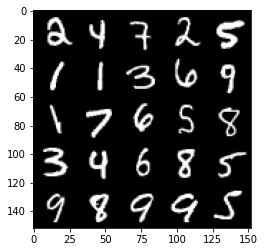

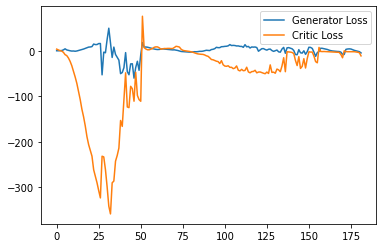

Step 3700: Generator loss: -0.08024945259094238, critic loss: -2.2193392772674563


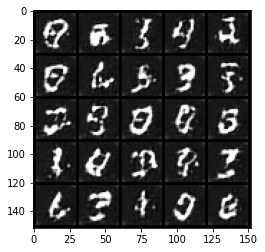

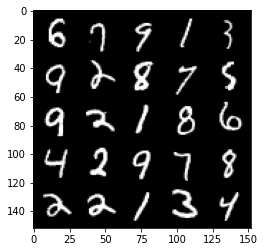

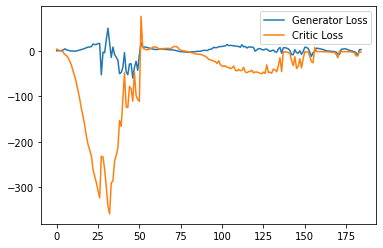

Step 3750: Generator loss: 0.2010250873863697, critic loss: -5.080263675689698


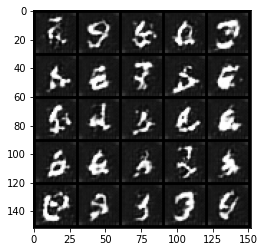

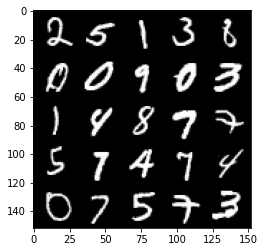

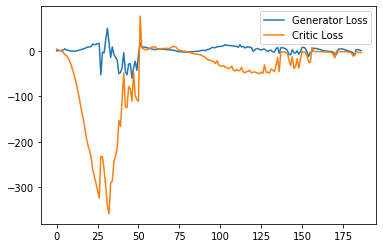

Step 3800: Generator loss: -9.296667991876602, critic loss: -17.40930184650421


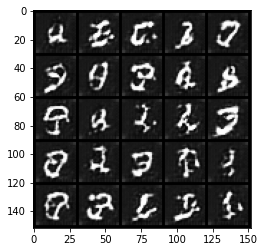

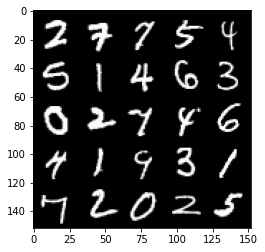

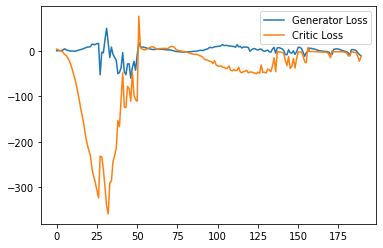

Step 3850: Generator loss: -3.840424473285675, critic loss: -16.22136523914337


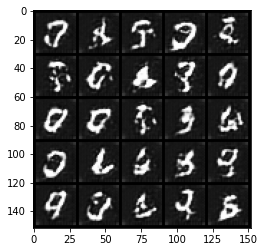

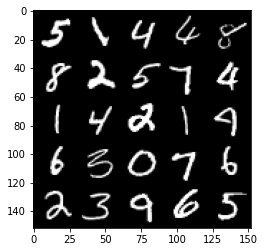

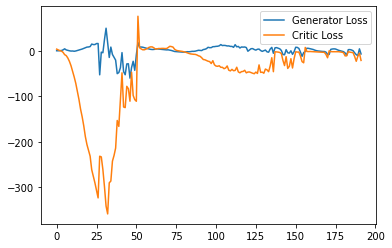

Step 3900: Generator loss: -7.611839508712292, critic loss: -22.817808942794798


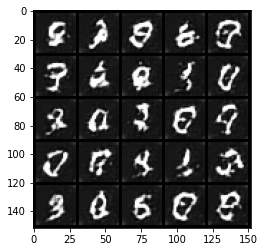

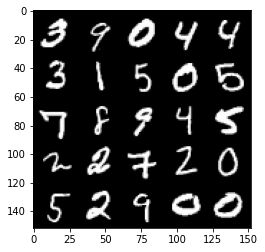

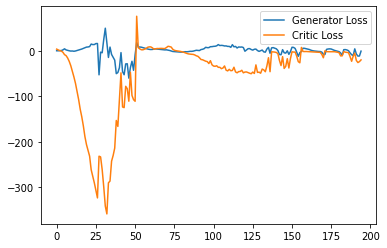

Step 3950: Generator loss: -7.047847474962473, critic loss: -11.918863012313846


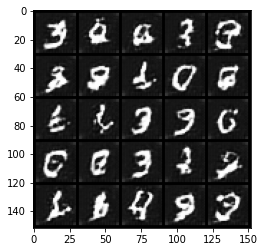

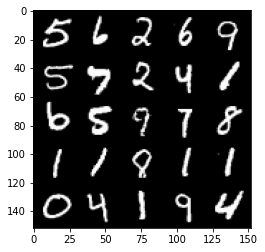

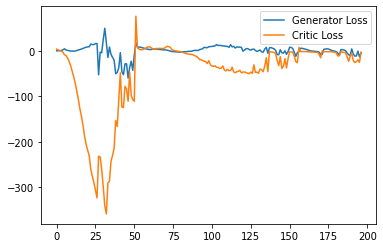

Step 4000: Generator loss: -3.1810254745185373, critic loss: -5.203169582366943


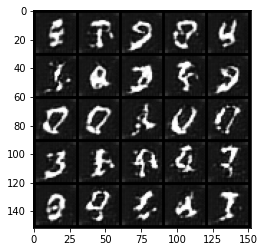

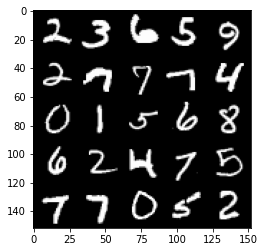

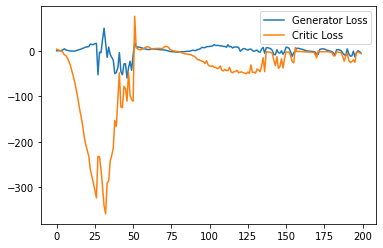

Step 4050: Generator loss: -13.49083632826805, critic loss: -23.11873546218872


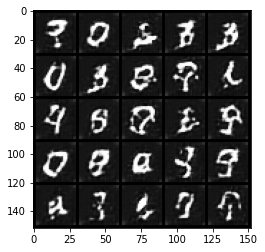

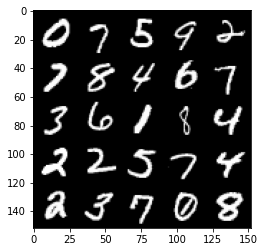

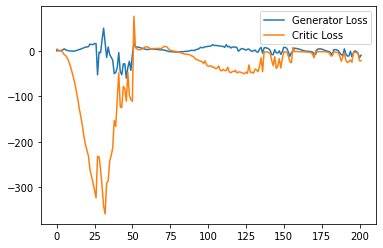

Step 4100: Generator loss: -14.437161450386048, critic loss: -17.711468891620644


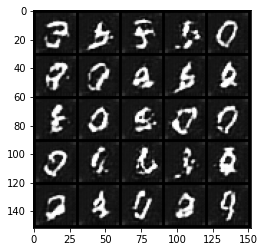

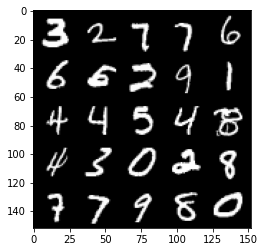

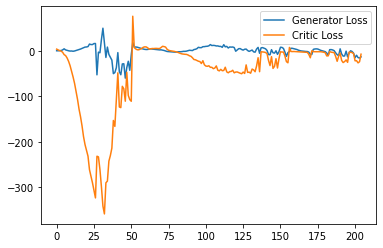

Step 4150: Generator loss: -1.582376103401184, critic loss: -3.409518262863159


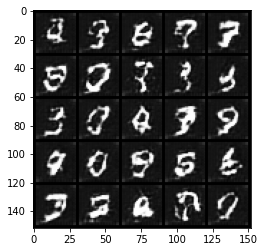

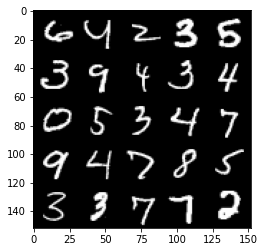

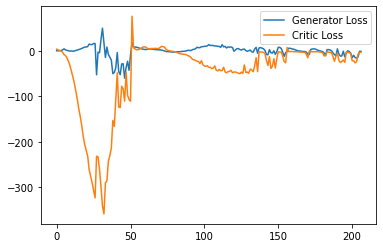

Step 4200: Generator loss: -6.494279561042785, critic loss: -5.31391680431366


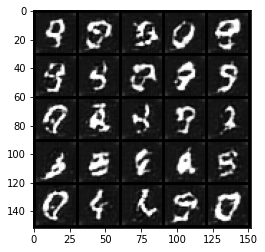

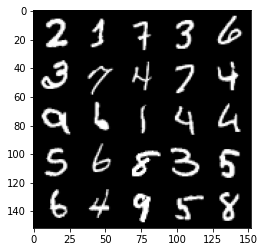

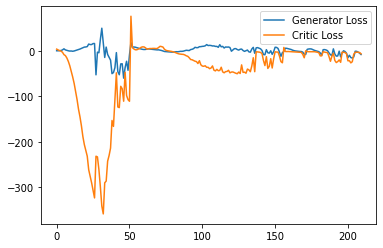

Step 4250: Generator loss: -15.046434803009033, critic loss: -19.39792843532562


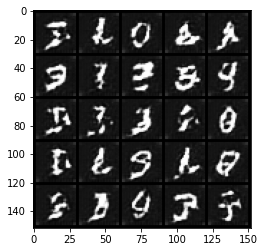

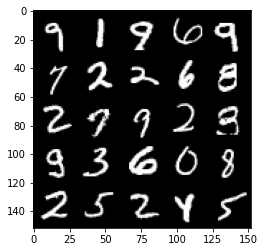

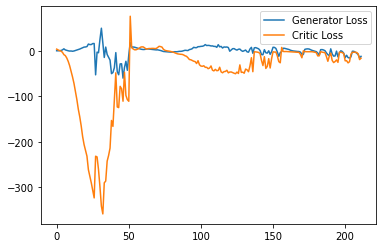

Step 4300: Generator loss: -15.80229585841298, critic loss: -23.5309445362091


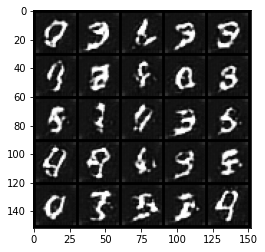

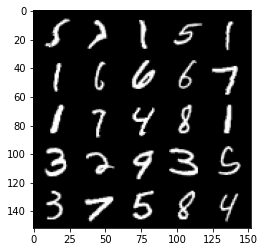

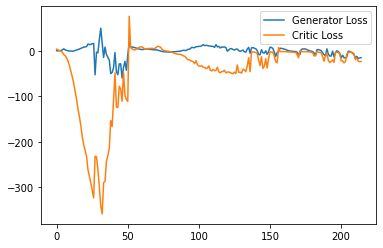

Step 4350: Generator loss: -10.084611718654633, critic loss: -6.9975139503479


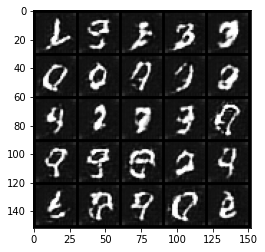

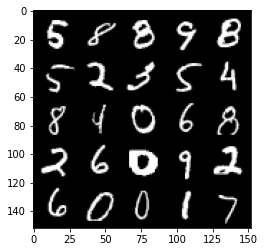

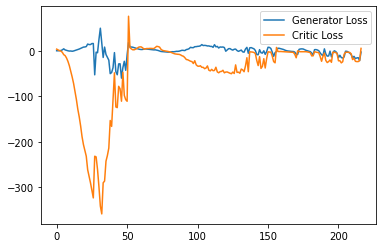

Step 4400: Generator loss: -10.00340847492218, critic loss: -9.080301652908325


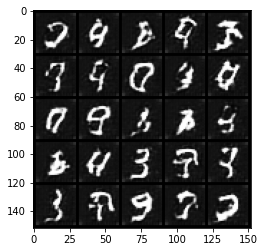

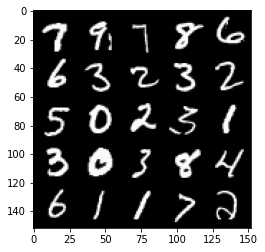

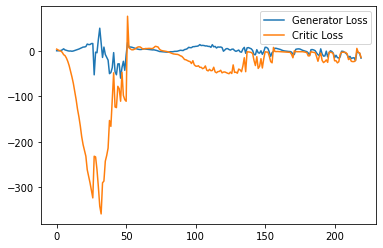

Step 4450: Generator loss: -18.74728587150574, critic loss: -22.18178472518921


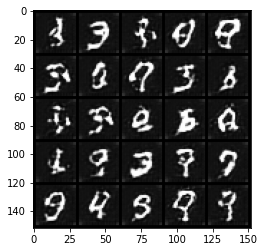

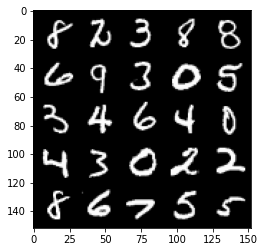

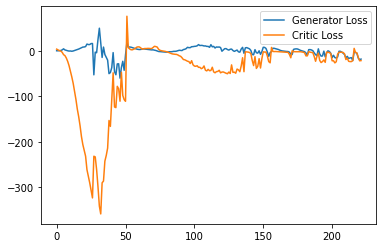

Step 4500: Generator loss: -17.314337274730207, critic loss: -17.021774971008302


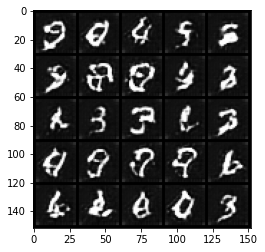

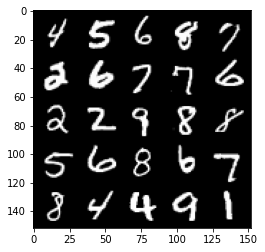

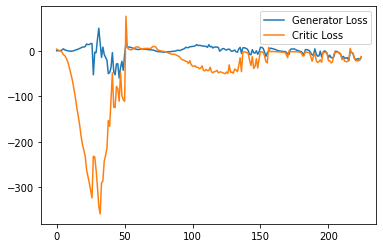

Step 4550: Generator loss: -19.743245992660523, critic loss: -23.396990095138552


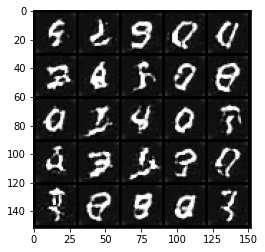

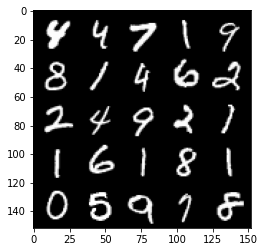

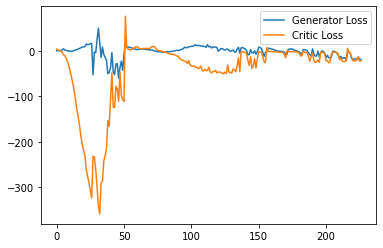

Step 4600: Generator loss: -22.849221782684324, critic loss: -24.116402355194097


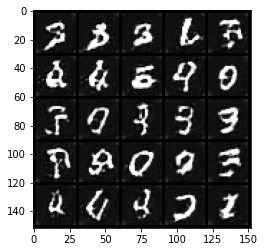

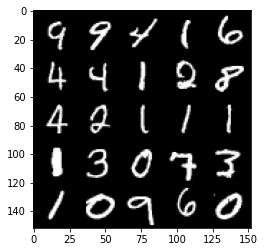

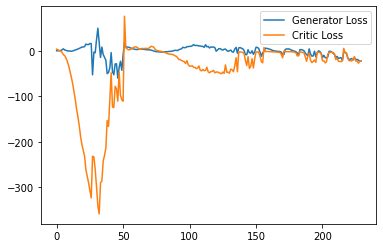

Step 4650: Generator loss: -13.652337169647216, critic loss: 3.228455829620359


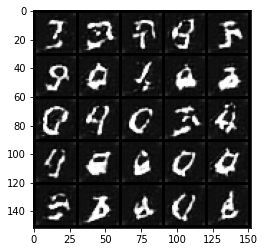

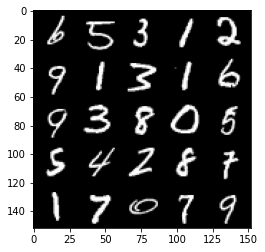

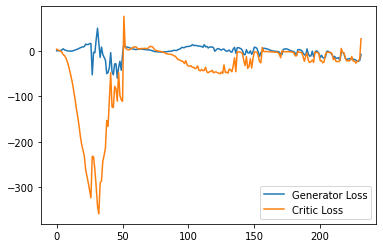

Step 4700: Generator loss: -11.703798904418946, critic loss: -2.928572393417358


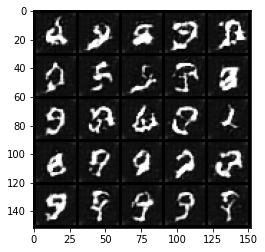

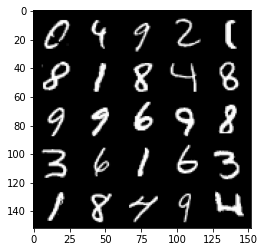

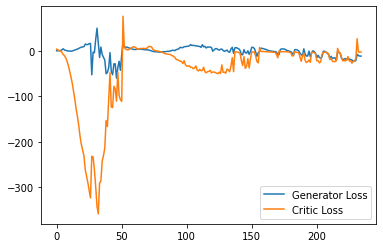

Step 4750: Generator loss: -12.91808177947998, critic loss: -2.900349587440491


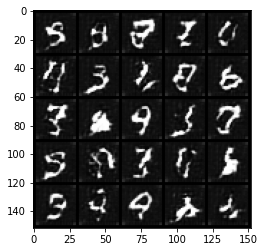

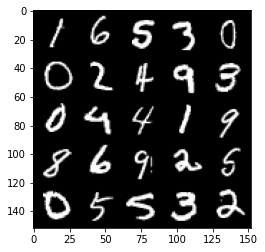

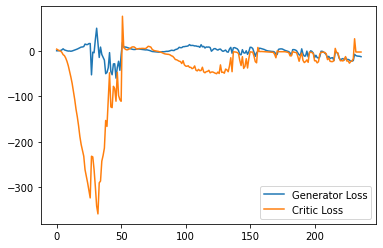

Step 4800: Generator loss: -13.583916606903076, critic loss: -3.0970627603530883


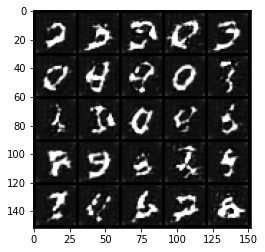

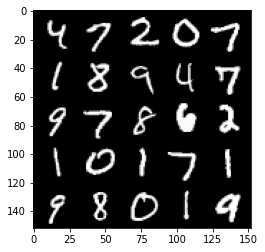

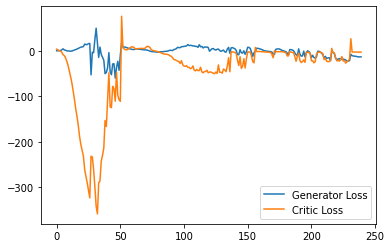

Step 4850: Generator loss: -13.941197052001954, critic loss: -3.455817339897156


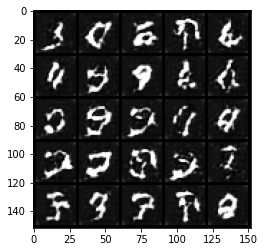

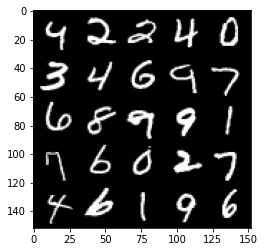

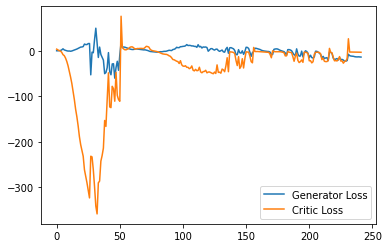

Step 4900: Generator loss: -15.310518016815186, critic loss: -5.203615039825438


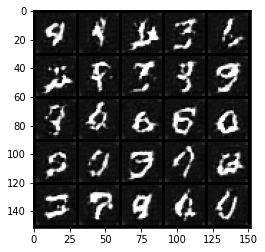

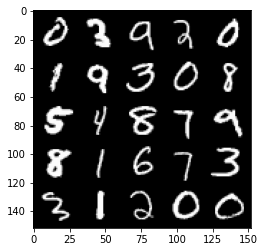

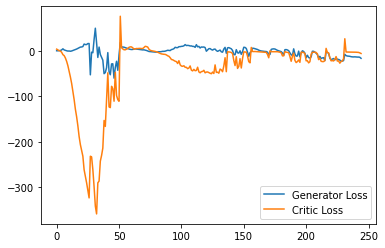

Step 4950: Generator loss: -18.518693828582762, critic loss: -14.838083044052121


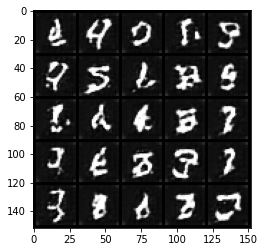

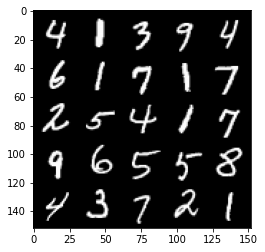

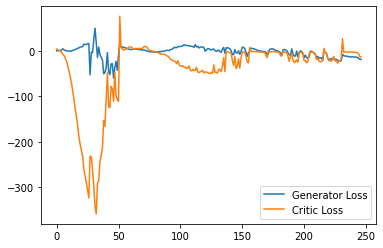

Step 5000: Generator loss: -20.23000535964966, critic loss: -18.28283156967164


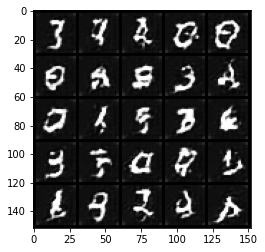

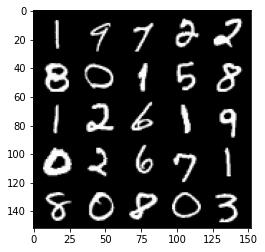

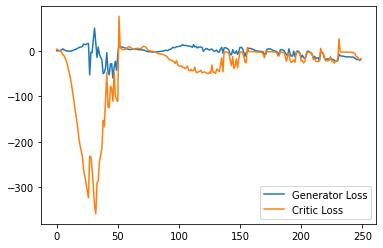

Step 5050: Generator loss: -13.601757515668869, critic loss: 0.7601000823974615


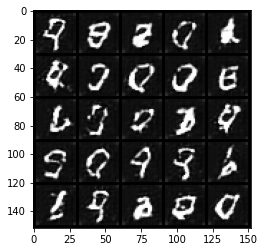

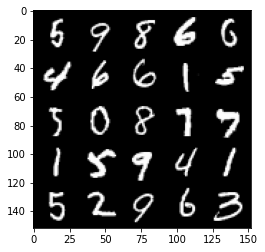

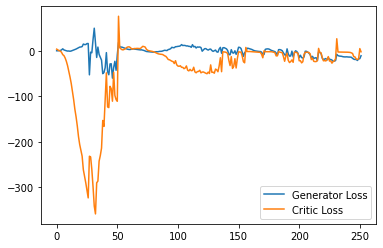

Step 5100: Generator loss: -12.052389678955079, critic loss: -2.615744330406189


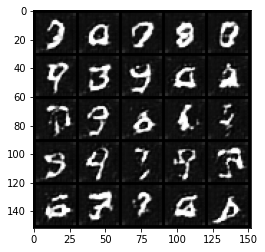

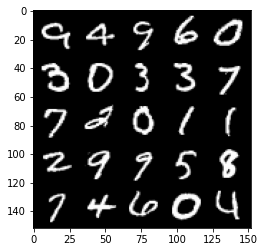

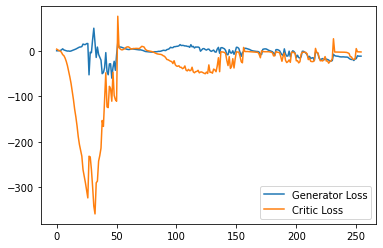

Step 5150: Generator loss: -12.366411266326905, critic loss: -3.065006099700928


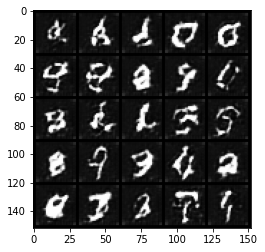

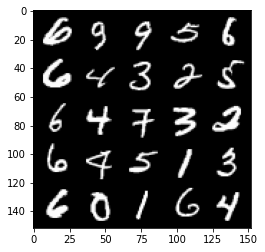

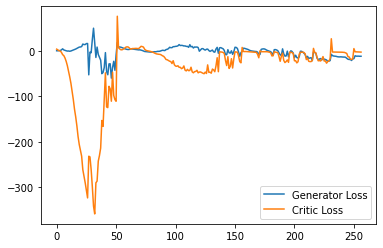

Step 5200: Generator loss: -13.335693359375, critic loss: -3.5054702205657957


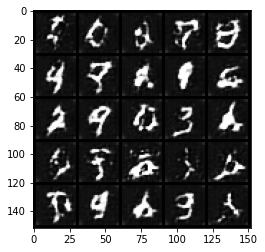

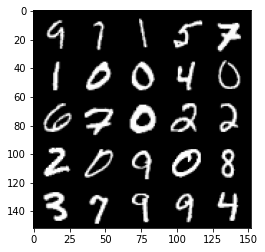

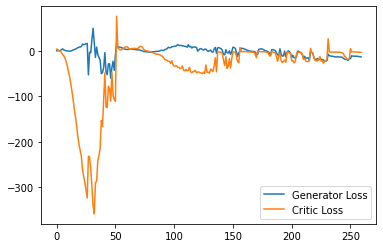

Step 5250: Generator loss: -17.806975688934326, critic loss: -9.015073600769043


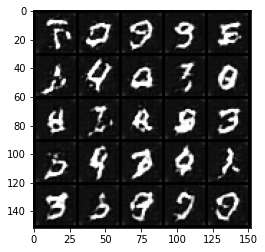

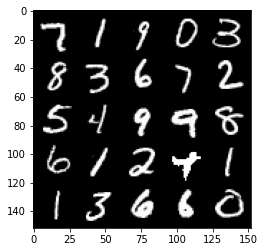

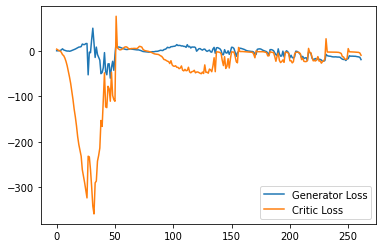

Step 5300: Generator loss: -21.393209202289583, critic loss: -16.464802293777463


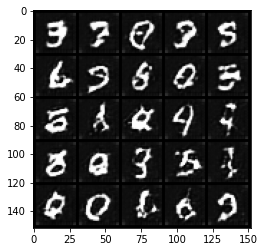

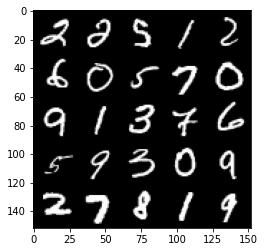

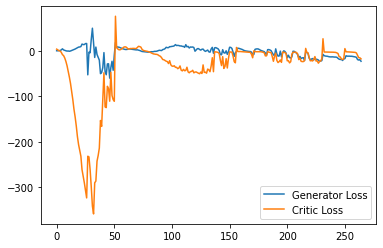

Step 5350: Generator loss: -19.214483526945113, critic loss: -15.764545665740963


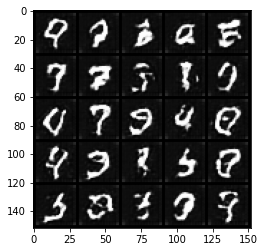

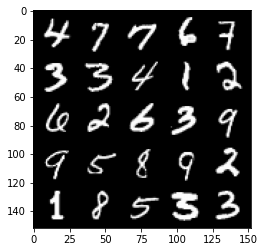

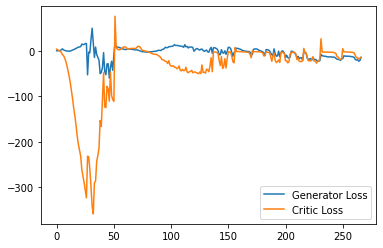

Step 5400: Generator loss: -21.315786008834838, critic loss: -18.056215579986564


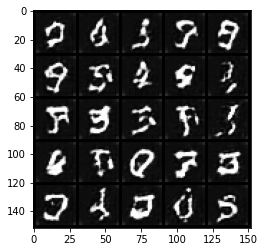

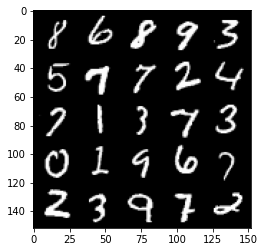

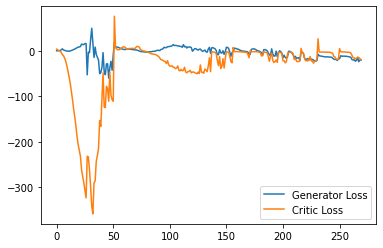

Step 5450: Generator loss: -21.166315487623216, critic loss: -20.08838665676117


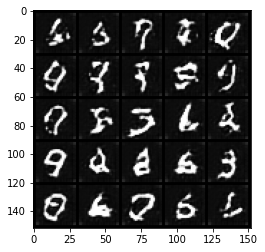

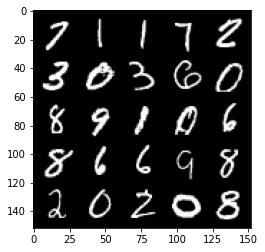

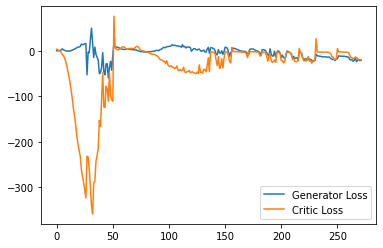

Step 5500: Generator loss: -19.36967753916979, critic loss: -12.813215968132017


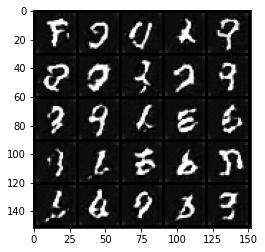

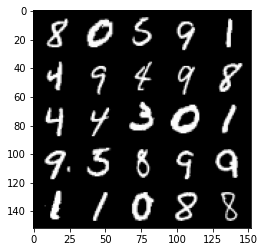

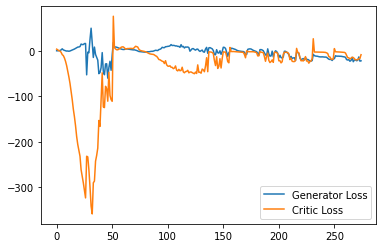

Step 5550: Generator loss: -8.300223665237427, critic loss: -4.204544013023376


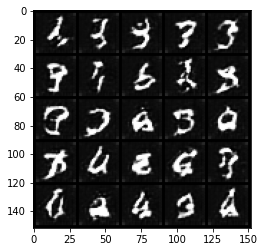

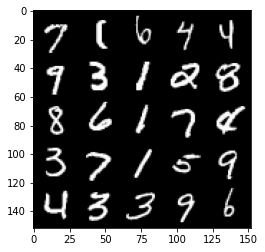

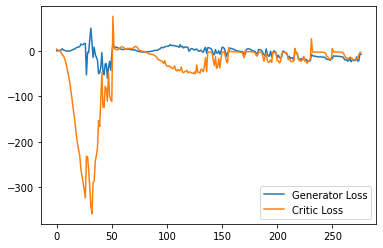

Step 5600: Generator loss: -21.139628372192384, critic loss: -17.490062599182128


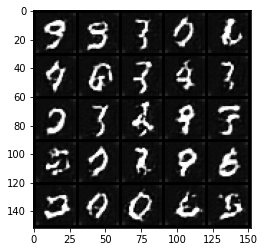

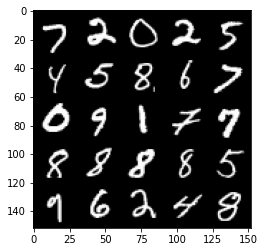

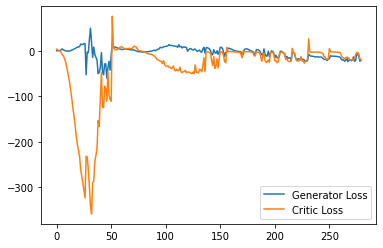

Step 5650: Generator loss: -19.023729734420776, critic loss: -16.010391901016234


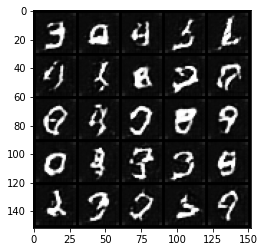

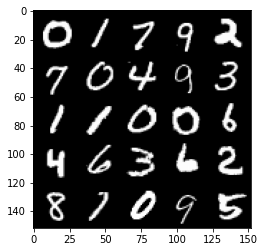

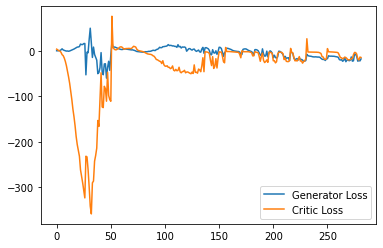

Step 5700: Generator loss: -22.75815710067749, critic loss: -19.073628564834593


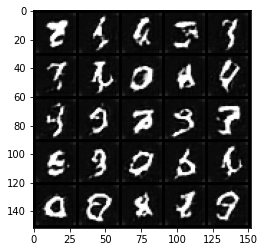

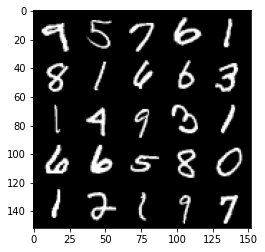

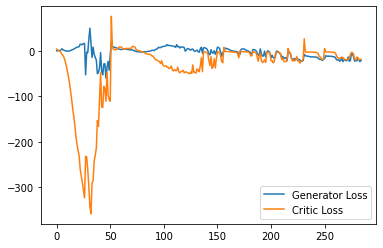

Step 5750: Generator loss: -21.709006419181822, critic loss: -18.10011167526245


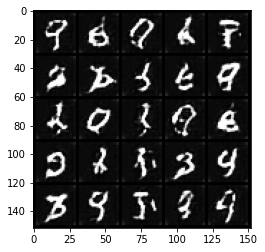

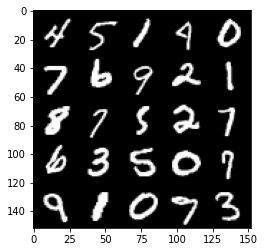

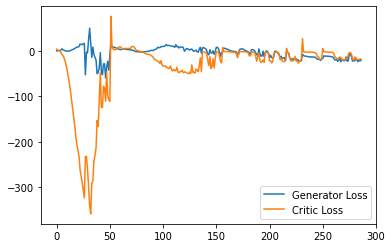

Step 5800: Generator loss: -17.172375915050505, critic loss: -18.225495454788206


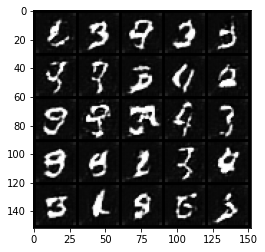

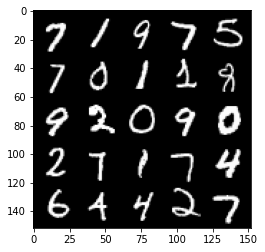

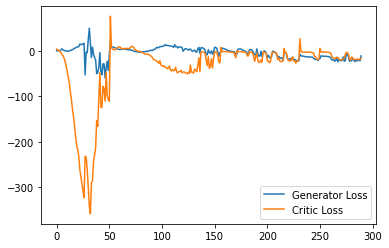

Step 5850: Generator loss: -20.58931206703186, critic loss: -15.955863080978395


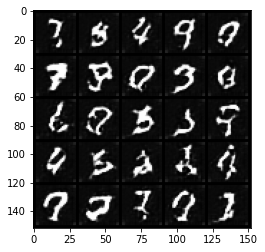

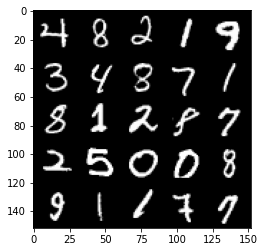

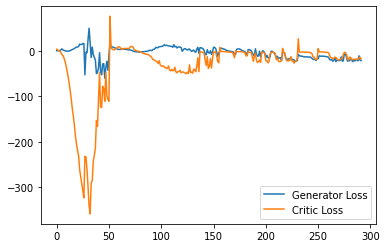

Step 5900: Generator loss: -18.855439019203185, critic loss: -10.381884183883672


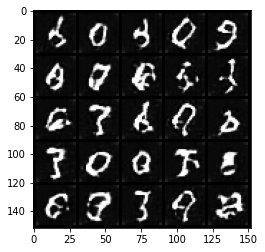

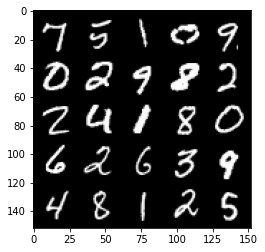

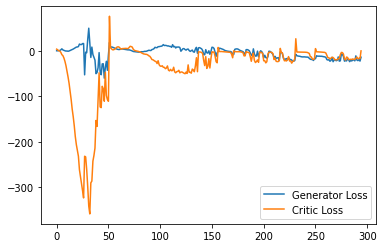

Step 5950: Generator loss: -11.043713703155518, critic loss: -3.6090766172409063


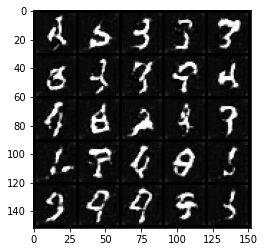

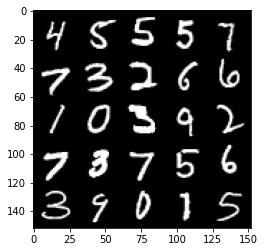

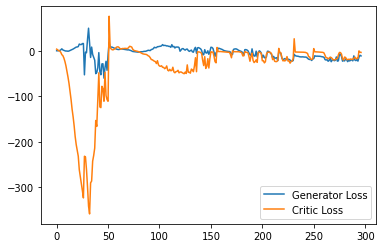

Step 6000: Generator loss: -13.05848180770874, critic loss: -5.056612317085266


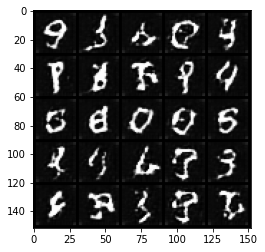

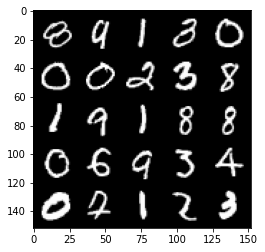

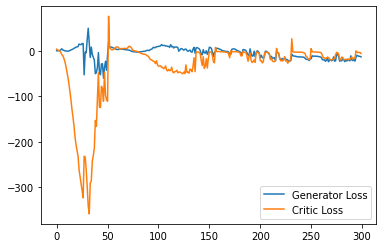

Step 6050: Generator loss: -23.741032466888427, critic loss: -17.943747949600223


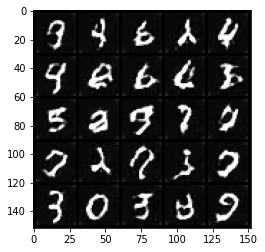

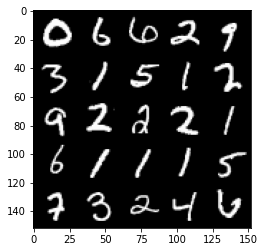

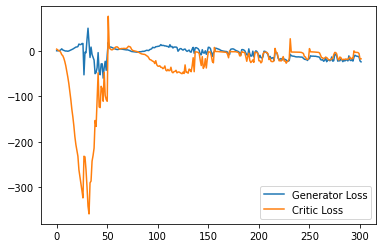

Step 6100: Generator loss: -12.976416428685189, critic loss: 2.644975368499757


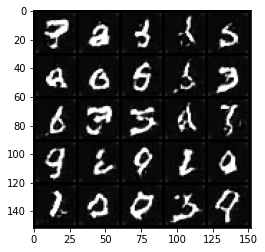

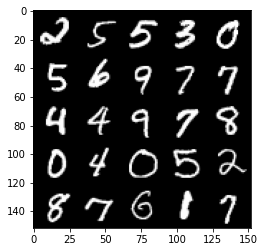

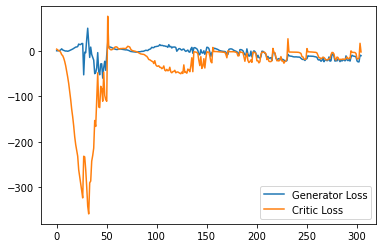

Step 6150: Generator loss: -12.913187370300292, critic loss: -3.208450140953064


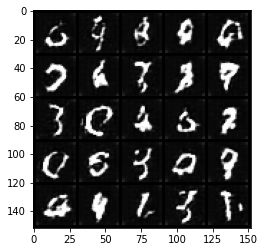

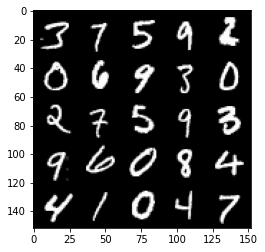

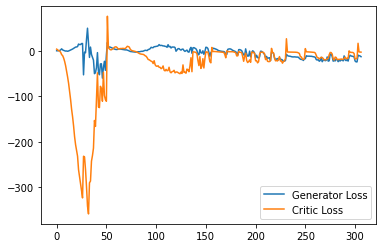

Step 6200: Generator loss: -18.80280994415283, critic loss: -5.358732927322386


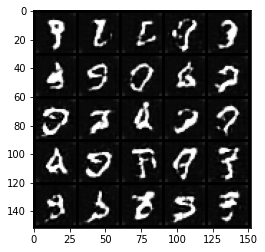

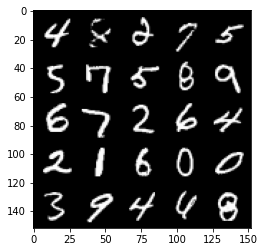

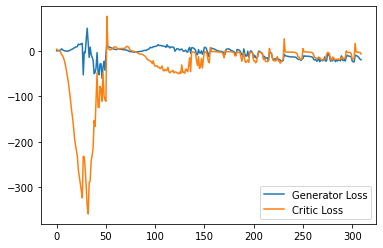

Step 6250: Generator loss: -24.89072862625122, critic loss: -13.960412436485287


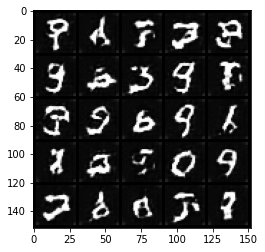

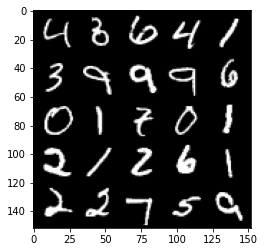

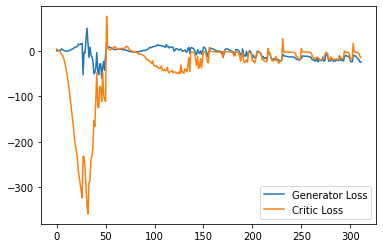

Step 6300: Generator loss: -24.70813184738159, critic loss: -16.92713132762909


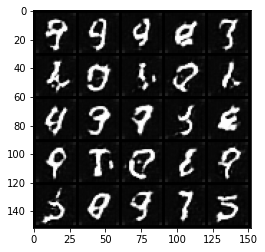

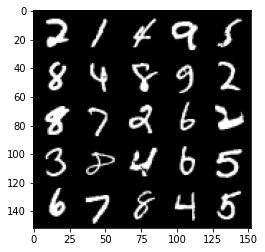

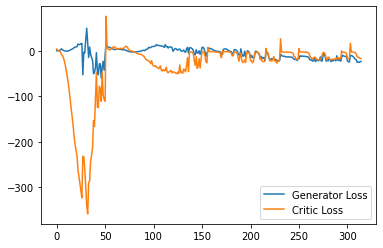

Step 6350: Generator loss: -23.09443335533142, critic loss: -16.497461980819704


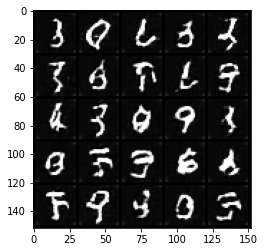

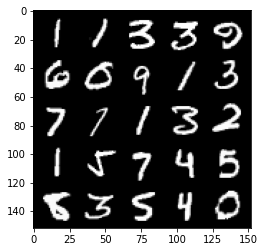

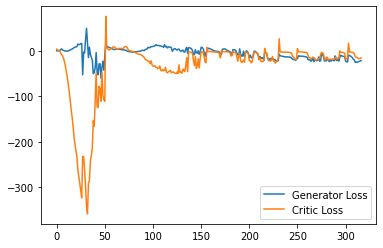

Step 6400: Generator loss: -19.00489047765732, critic loss: -16.669984867095945


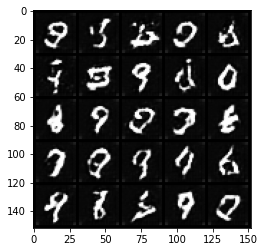

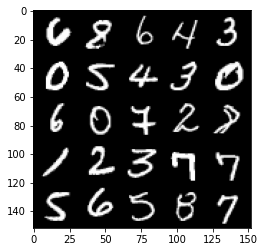

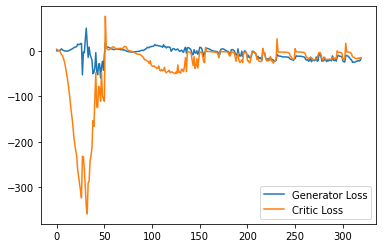

Step 6450: Generator loss: -22.26514208972454, critic loss: -8.542124520301815


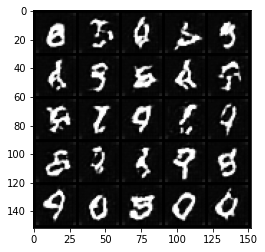

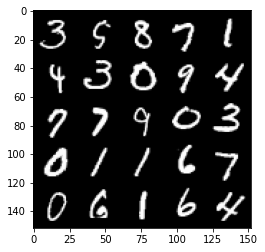

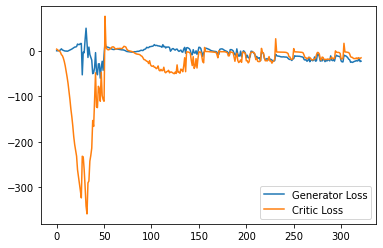

Step 6500: Generator loss: -13.175266799926758, critic loss: -4.386149110794067


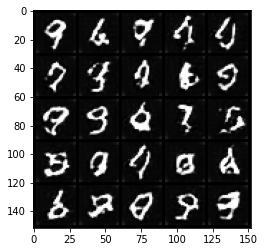

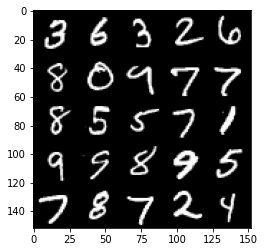

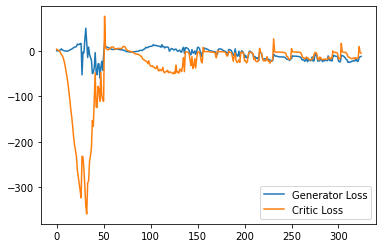

Step 6550: Generator loss: -16.302771207094192, critic loss: -10.02479164981842


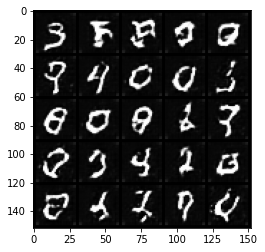

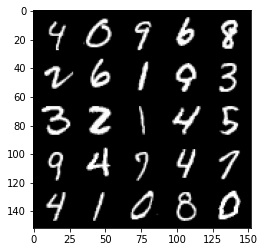

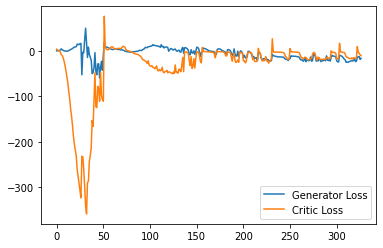

Step 6600: Generator loss: -22.452682123184204, critic loss: -17.000441000938416


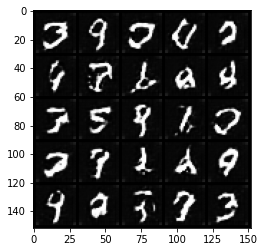

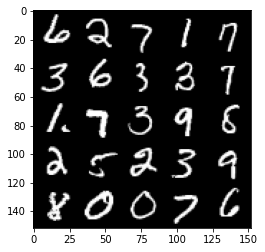

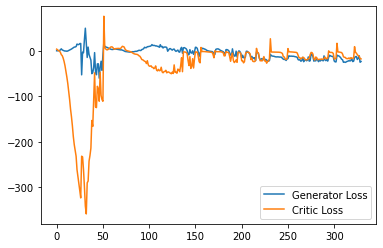

Step 6650: Generator loss: -12.135692682266235, critic loss: -10.78312075710297


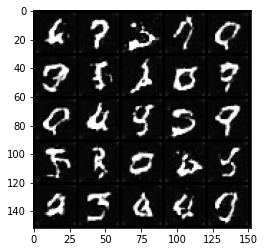

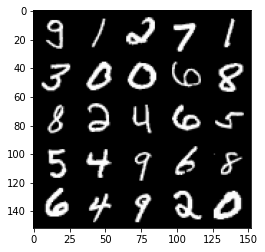

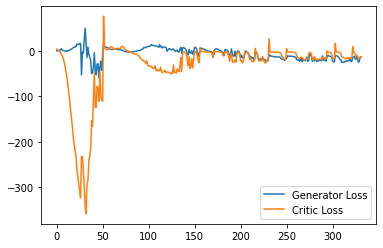

Step 6700: Generator loss: -16.606368244886397, critic loss: -12.97146723270416


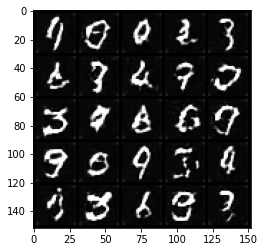

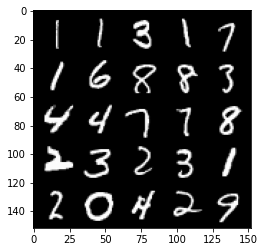

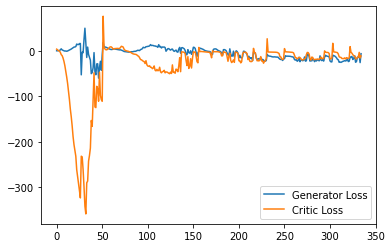

Step 6750: Generator loss: -19.674514875411987, critic loss: -10.23271923828125


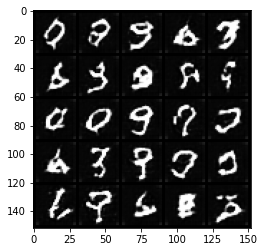

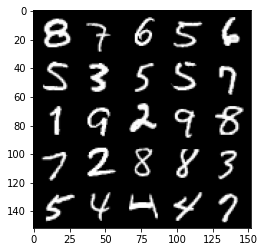

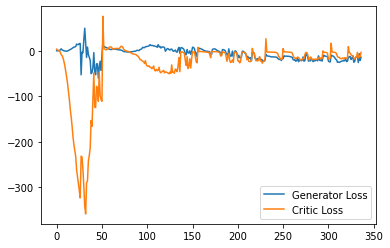

Step 6800: Generator loss: -21.655355198383333, critic loss: -15.138211594104769


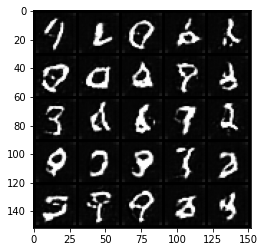

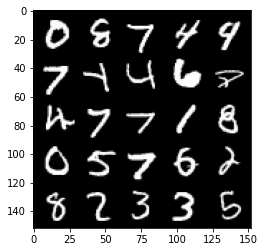

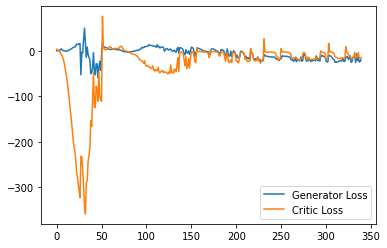

Step 6850: Generator loss: -18.392030625343324, critic loss: -14.454999914646153


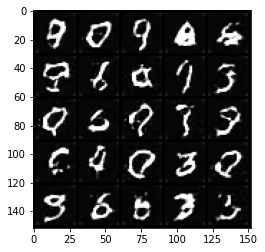

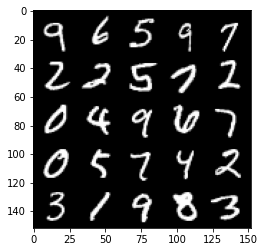

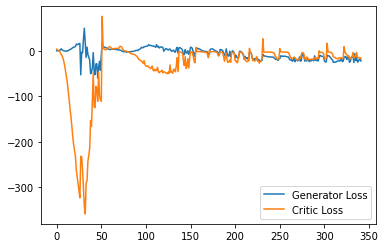

Step 6900: Generator loss: -19.150479612350463, critic loss: -14.927390233039857


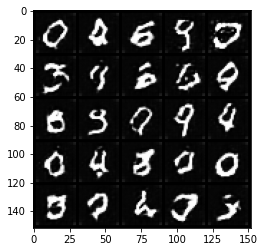

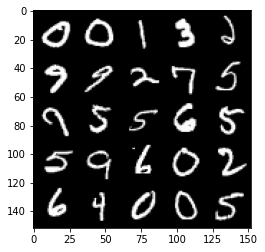

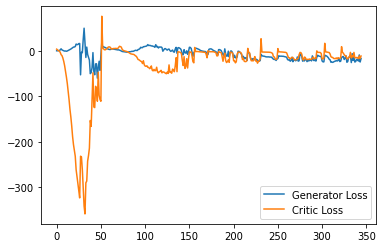

Step 6950: Generator loss: -15.463208498954772, critic loss: -11.50273952102661


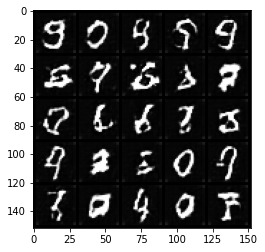

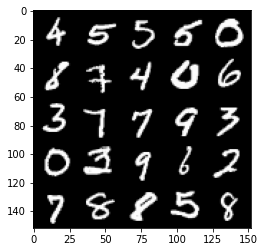

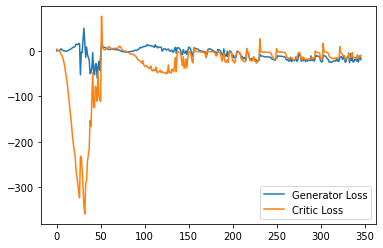

Step 7000: Generator loss: -20.44428896665573, critic loss: -15.77512362575531


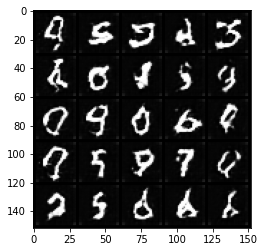

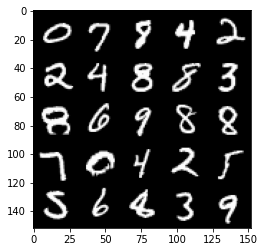

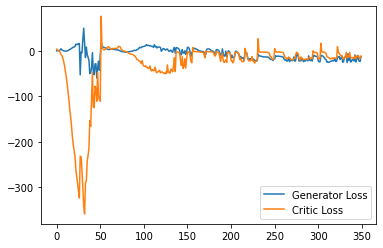

Step 7050: Generator loss: -20.652136249542238, critic loss: -9.103428212165829


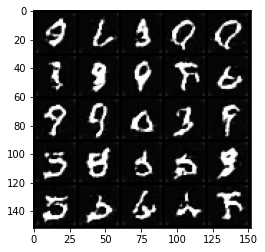

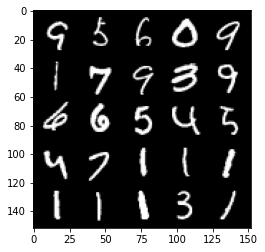

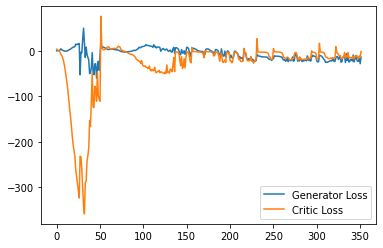

Step 7100: Generator loss: -25.93714922428131, critic loss: -15.754187156200407


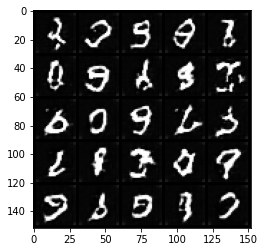

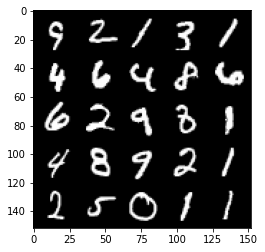

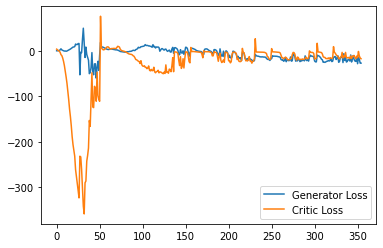

Step 7150: Generator loss: -23.011021099090577, critic loss: -15.262083519935613


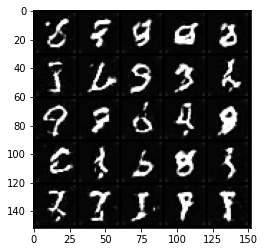

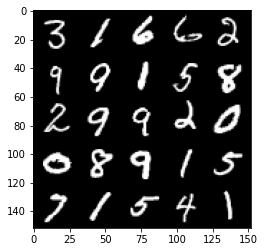

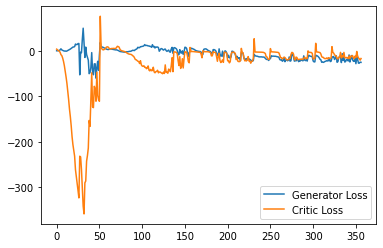

Step 7200: Generator loss: -19.073429034948347, critic loss: -15.249429133892058


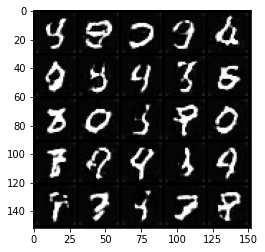

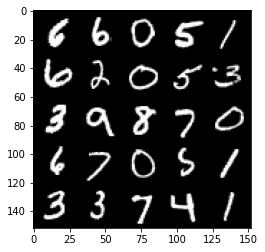

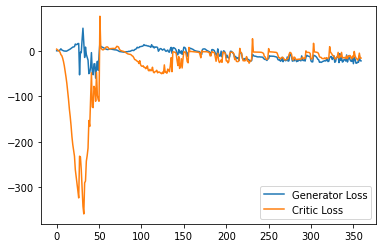

Step 7250: Generator loss: -16.81422017335892, critic loss: -3.0749833893775933


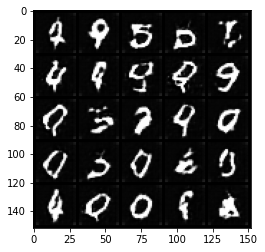

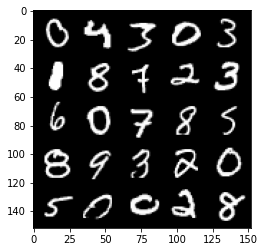

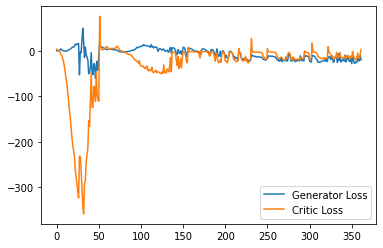

Step 7300: Generator loss: -21.466917037963867, critic loss: -7.100532551050184


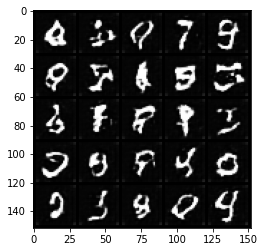

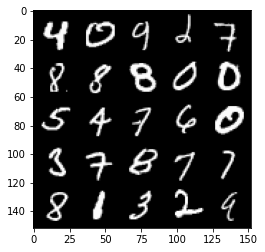

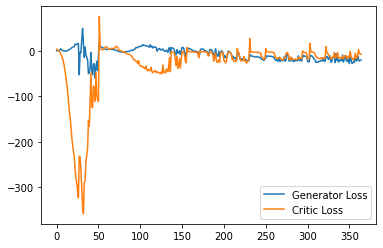

Step 7350: Generator loss: -25.791642932891847, critic loss: -15.57285858678818


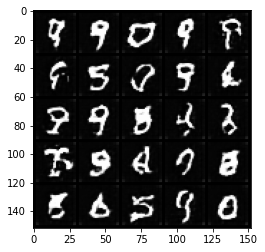

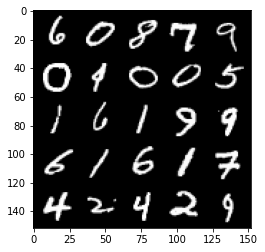

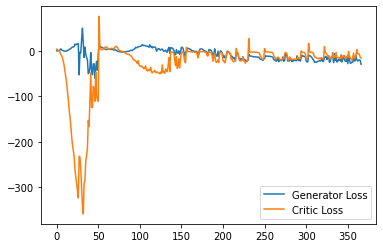

Step 7400: Generator loss: -29.336586713790894, critic loss: -17.56616846179962


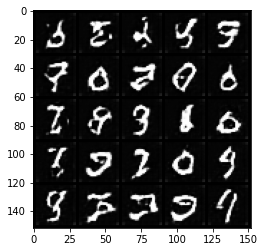

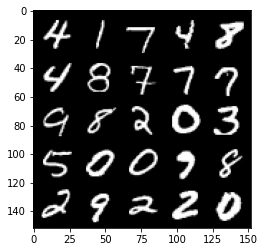

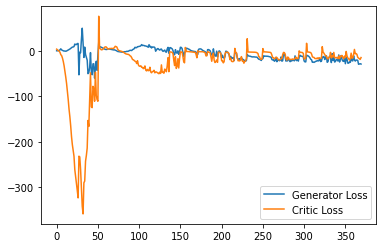

Step 7450: Generator loss: -18.99930288389325, critic loss: -7.7656544170379656


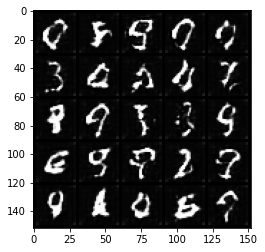

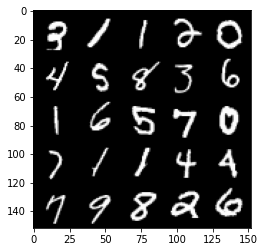

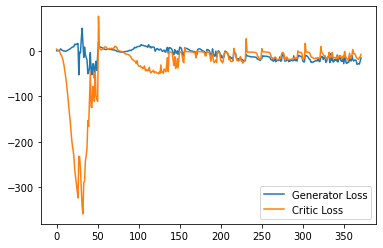

Step 7500: Generator loss: -24.718028831481934, critic loss: 0.28645338201522835


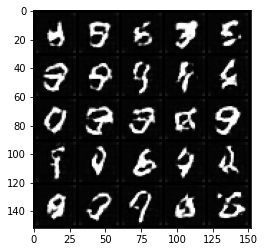

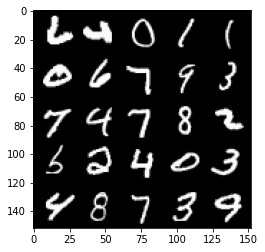

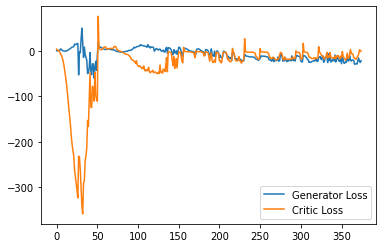

Step 7550: Generator loss: -18.408211421966552, critic loss: -4.3050363545417785


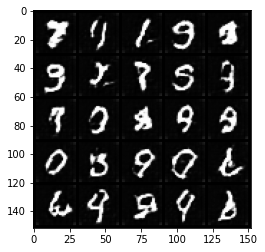

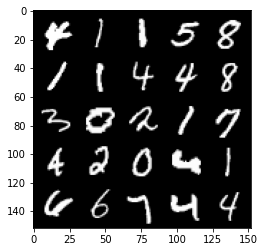

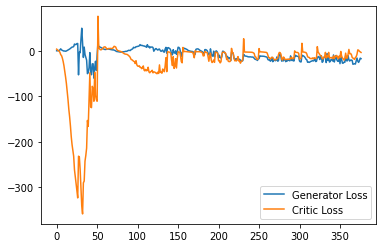

Step 7600: Generator loss: -21.91786947250366, critic loss: -11.70121883058548


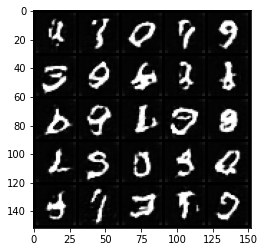

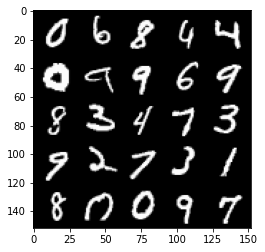

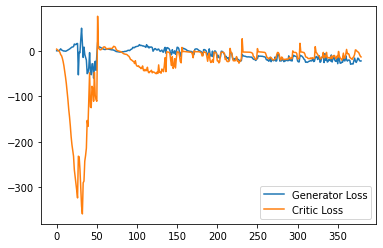

Step 7650: Generator loss: -20.42372027873993, critic loss: -11.531625198841095


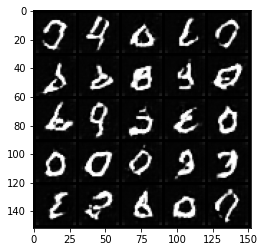

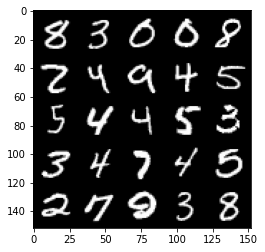

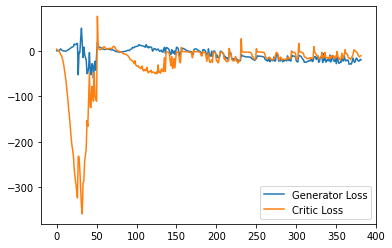

Step 7700: Generator loss: -23.312368178367613, critic loss: -14.105461333751682


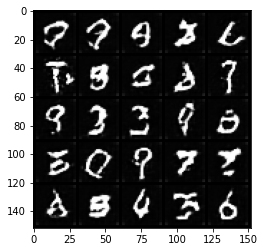

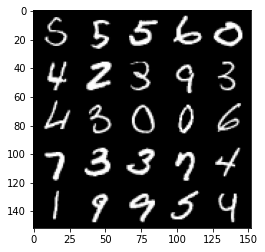

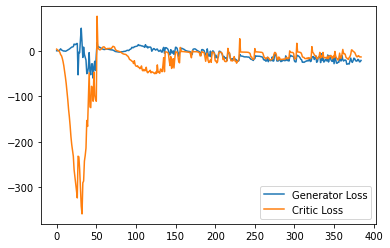

Step 7750: Generator loss: -21.30277316093445, critic loss: -11.628543171405793


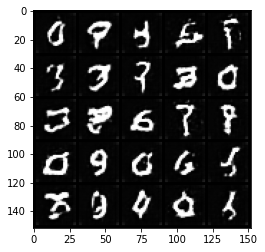

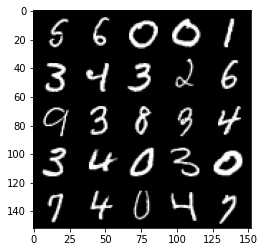

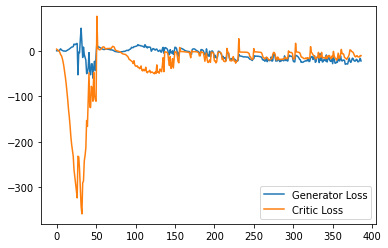

Step 7800: Generator loss: -19.957877155542374, critic loss: -10.360443587064742


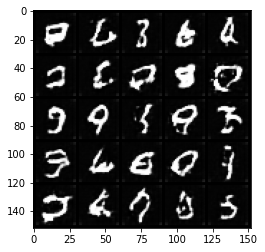

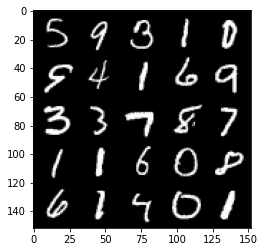

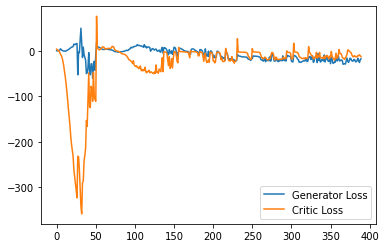

Step 7850: Generator loss: -19.487242022752763, critic loss: -7.681129343986514


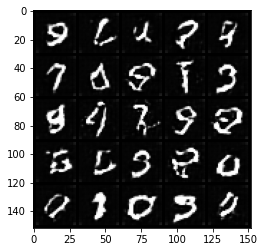

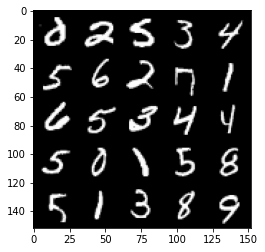

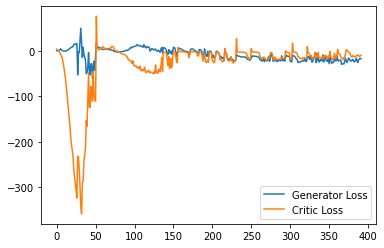

Step 7900: Generator loss: -21.680860691070556, critic loss: -2.249439400672912


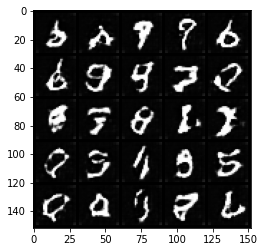

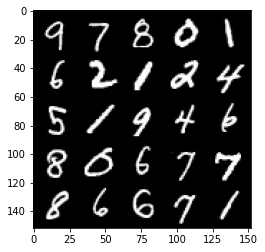

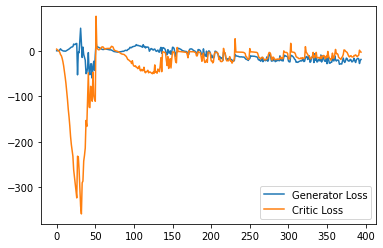

Step 7950: Generator loss: -20.322084732055664, critic loss: -6.142856082439424


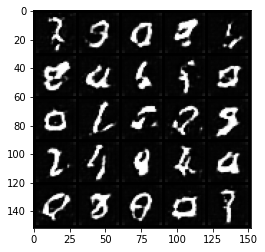

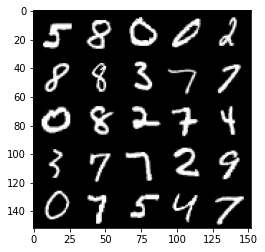

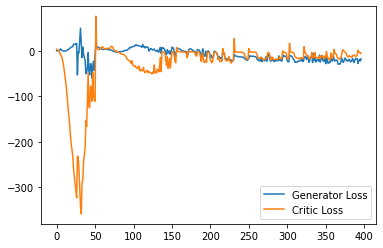

Step 8000: Generator loss: -22.50398356437683, critic loss: -9.120413522720337


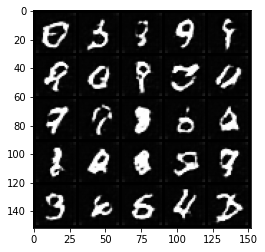

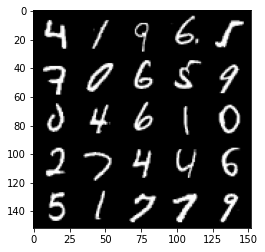

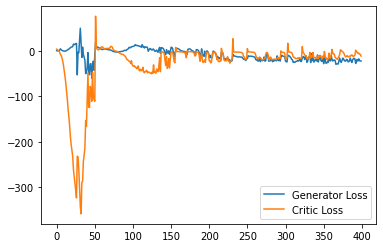

Step 8050: Generator loss: -20.497812452316285, critic loss: -12.906475596427919


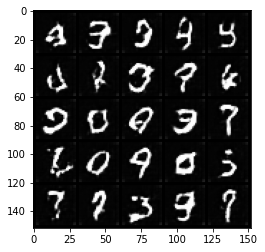

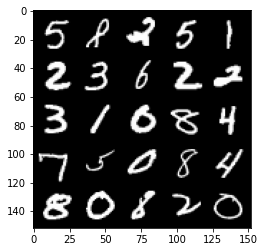

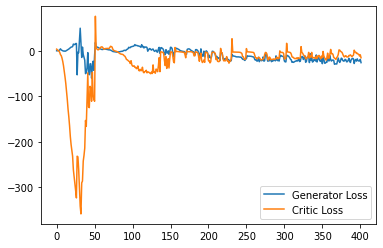

Step 8100: Generator loss: -23.425518074035644, critic loss: -8.245510513305662


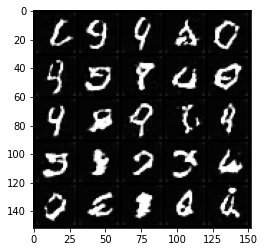

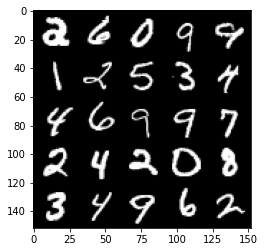

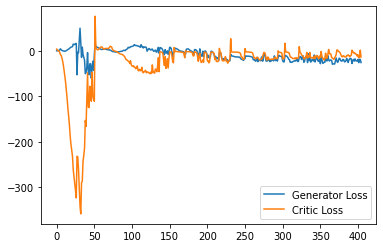

Step 8150: Generator loss: -23.14575436592102, critic loss: -13.861722006320953


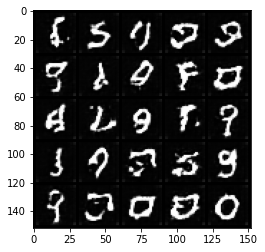

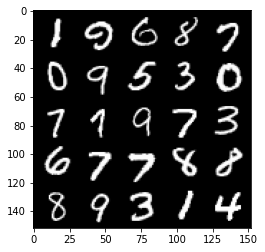

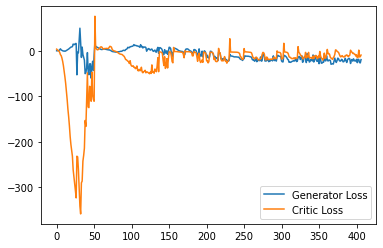

Step 8200: Generator loss: -21.451324586868285, critic loss: -11.907618673324585


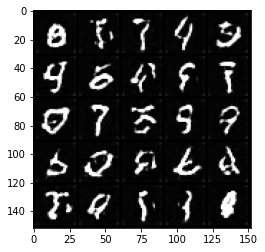

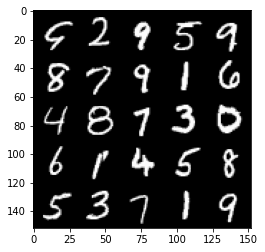

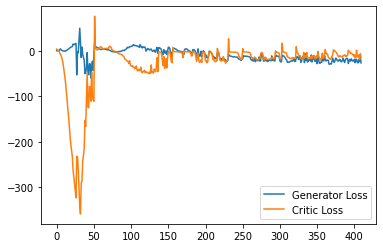

Step 8250: Generator loss: -23.800631561279296, critic loss: -14.732216191291807


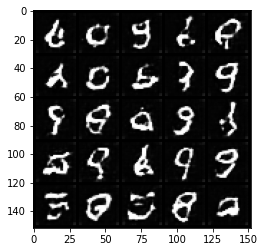

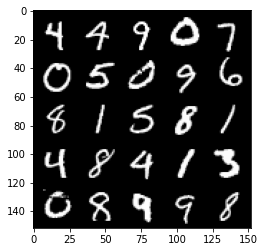

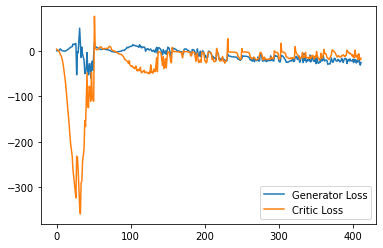

Step 8300: Generator loss: -27.876921672821044, critic loss: -16.511543994426727


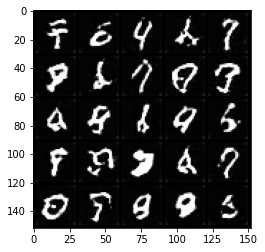

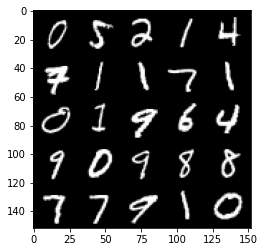

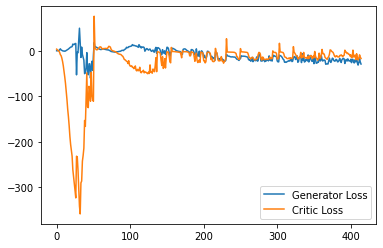

Step 8350: Generator loss: -22.58930006891489, critic loss: -15.231761103153229


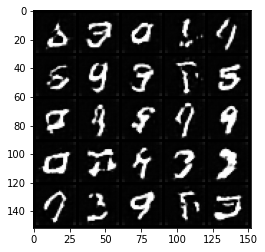

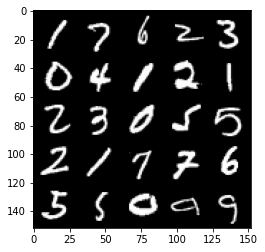

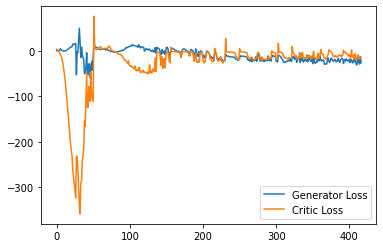

Step 8400: Generator loss: -25.01139555692673, critic loss: -16.114854524612426


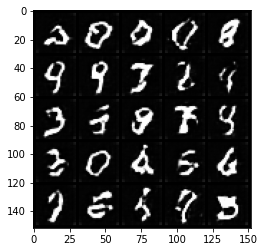

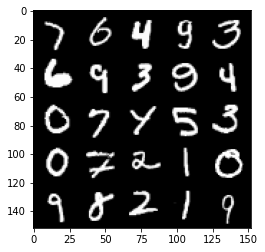

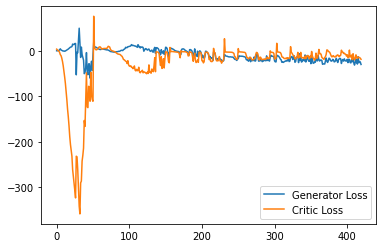

Step 8450: Generator loss: -26.9588720703125, critic loss: -12.863033620834353


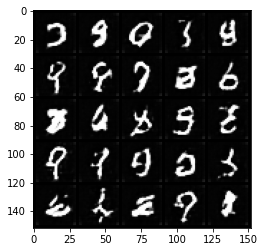

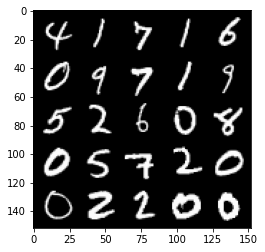

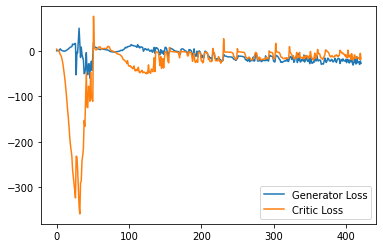

Step 8500: Generator loss: -21.9899285697937, critic loss: -14.06290683746338


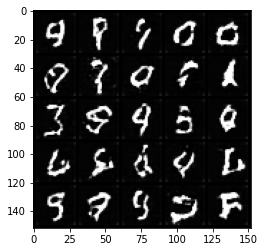

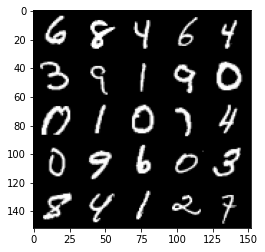

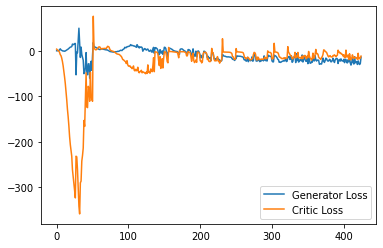

Step 8550: Generator loss: -23.402507457733154, critic loss: -12.011631663799287


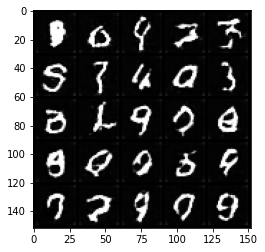

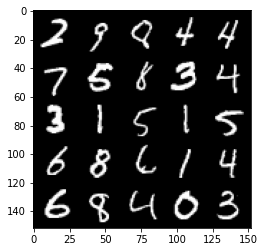

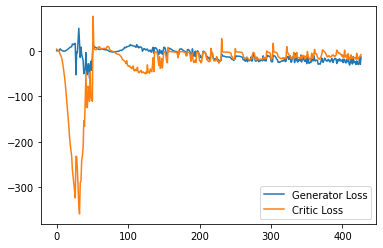

Step 8600: Generator loss: -21.408784165382386, critic loss: -13.269676888942717


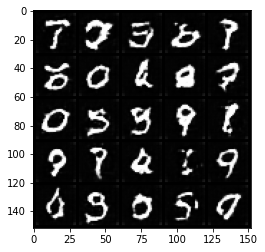

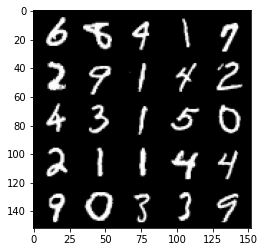

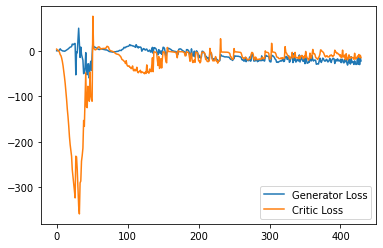

Step 8650: Generator loss: -23.681845133304595, critic loss: -15.109083950042725


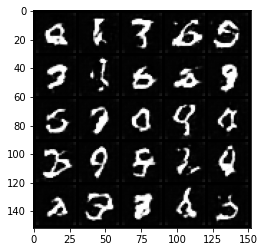

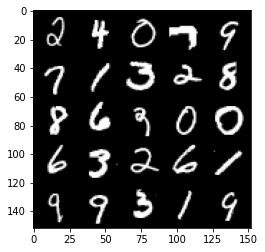

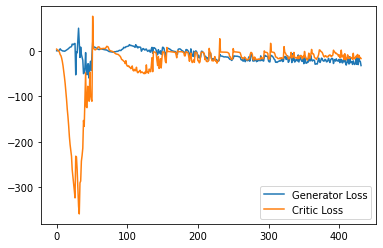

Step 8700: Generator loss: -22.919061098098755, critic loss: -15.968931614875794


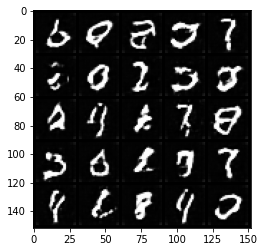

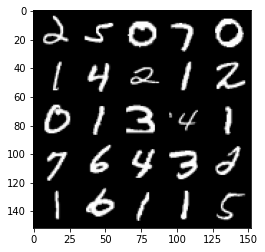

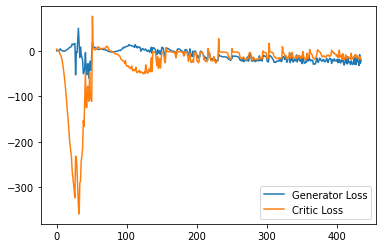

Step 8750: Generator loss: -20.996293754577636, critic loss: -12.219733667373657


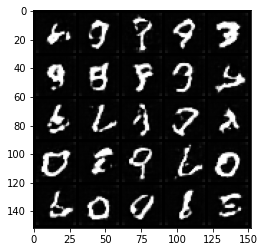

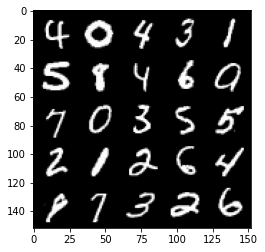

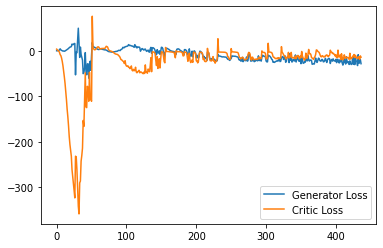

Step 8800: Generator loss: -28.76283829689026, critic loss: -16.676113221645355


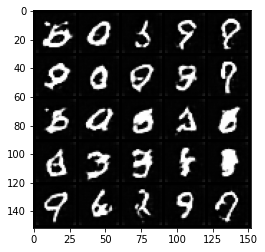

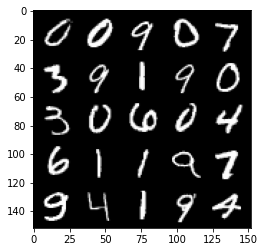

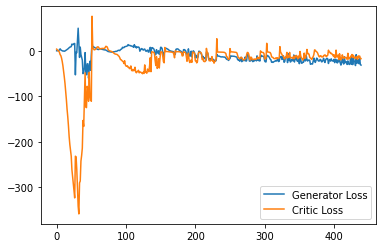

Step 8850: Generator loss: -28.264070653915404, critic loss: -19.09125722551346


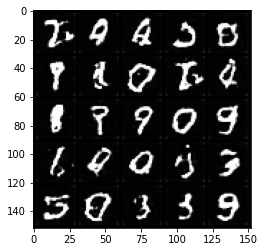

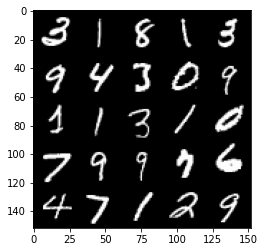

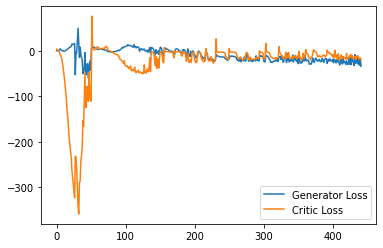

Step 8900: Generator loss: -27.433623914718627, critic loss: -11.840938250303266


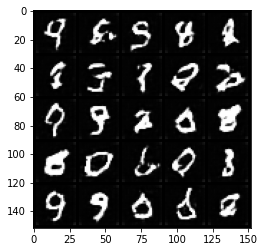

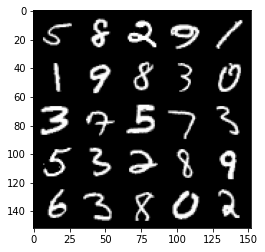

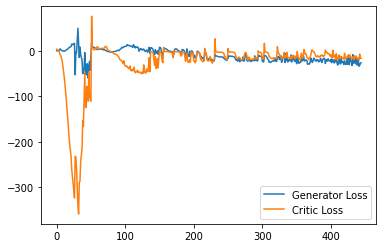

Step 8950: Generator loss: -21.853255121707917, critic loss: -14.212556923151014


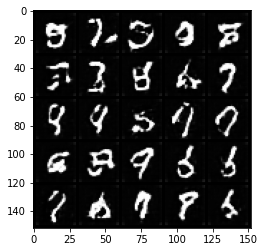

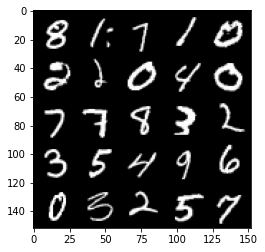

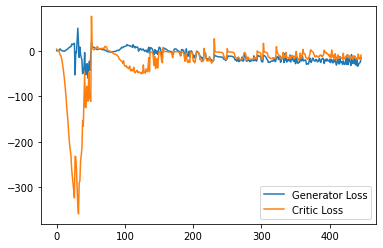

Step 9000: Generator loss: -21.559015871882437, critic loss: -10.609966406345366


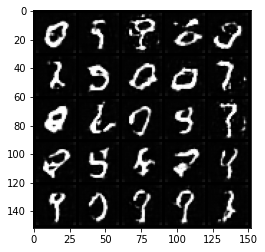

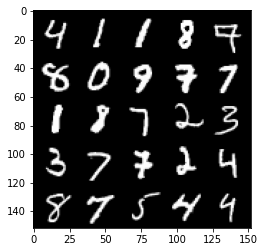

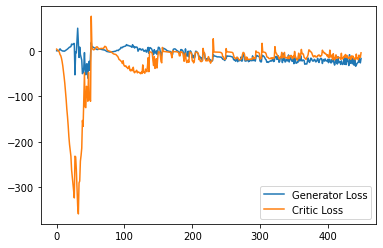

Step 9050: Generator loss: -25.90997234046459, critic loss: -14.114219579219819


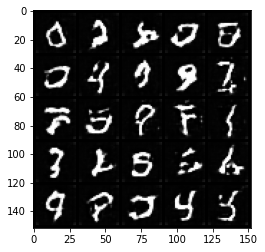

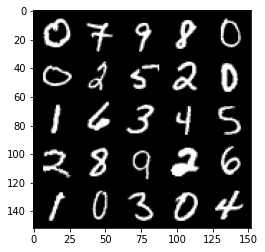

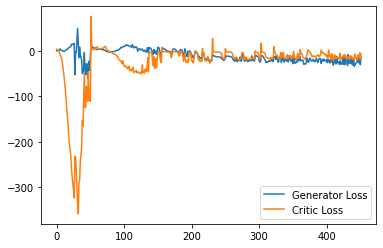

Step 9100: Generator loss: -27.399247349500655, critic loss: -16.743435873746872


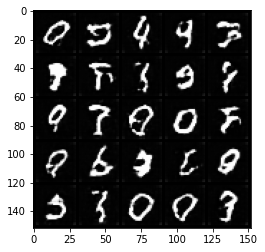

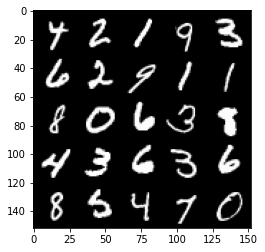

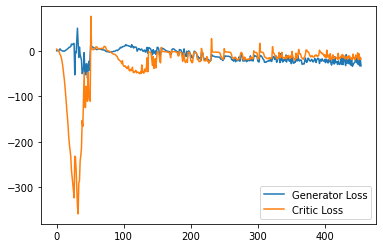

Step 9150: Generator loss: -23.17235153198242, critic loss: -11.652532920837402


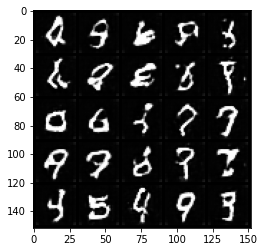

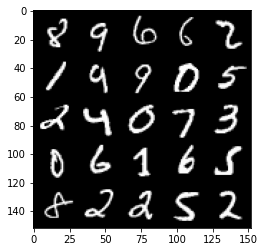

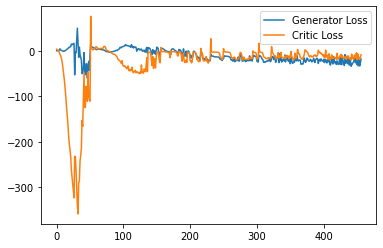

Step 9200: Generator loss: -35.80016361236572, critic loss: -20.112863488674165


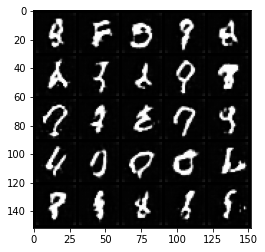

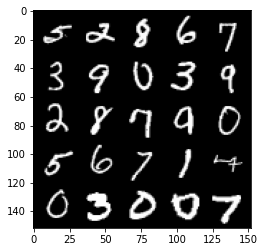

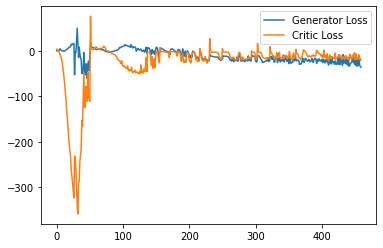

Step 9250: Generator loss: -26.97488981246948, critic loss: -13.799349976062775


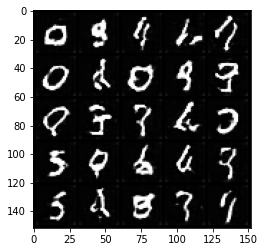

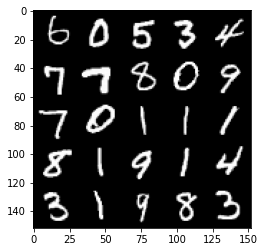

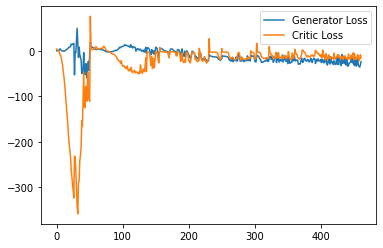

Step 9300: Generator loss: -22.621340069770813, critic loss: -15.49544161891938


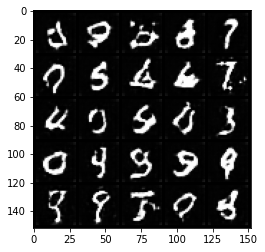

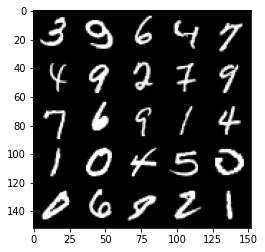

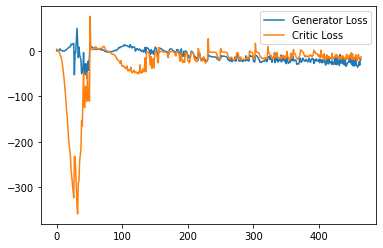

Step 9350: Generator loss: -26.194549464583396, critic loss: -13.743544682502746


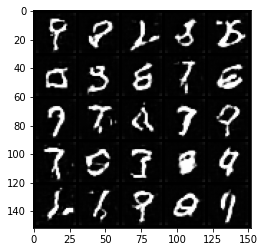

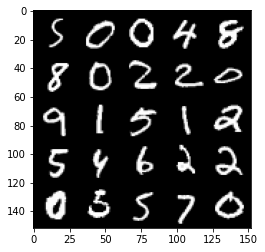

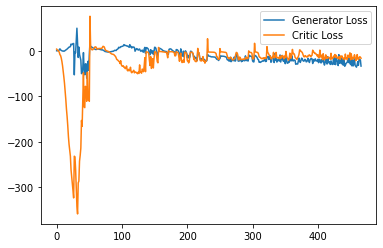

Step 9400: Generator loss: -20.895372838377952, critic loss: -12.912235236644747


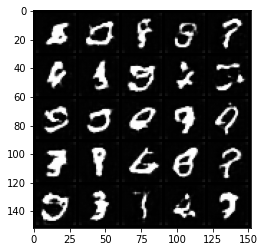

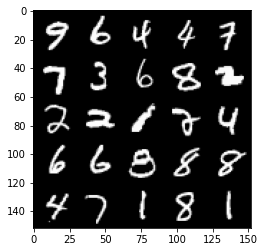

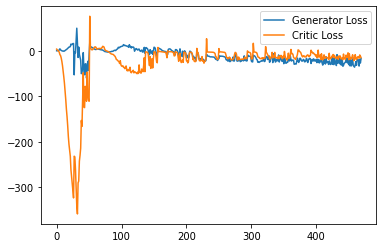

Step 9450: Generator loss: -30.901373672485352, critic loss: -17.445052611351013


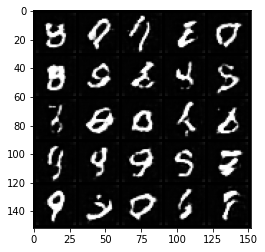

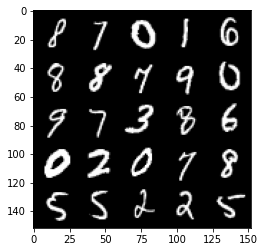

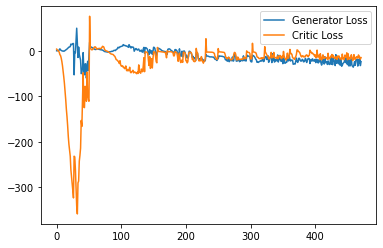

Step 9500: Generator loss: -24.142397100925447, critic loss: -16.149216482162473


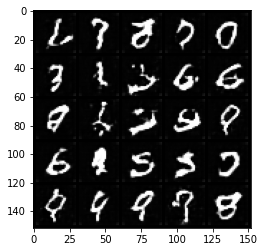

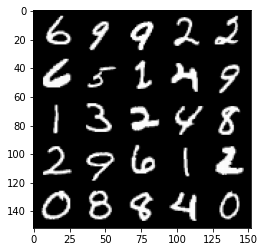

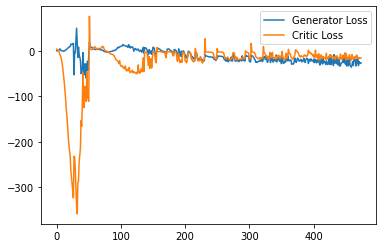

Step 9550: Generator loss: -33.16027139186859, critic loss: -17.686064704418175


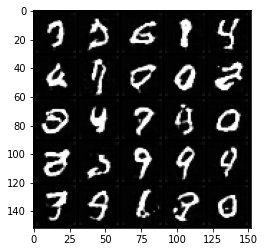

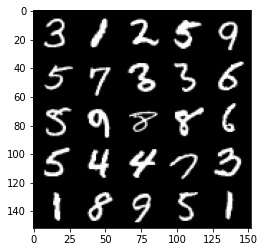

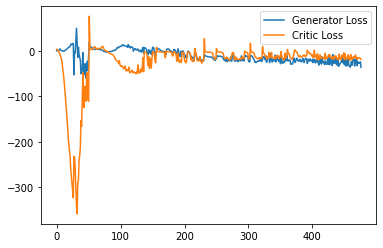

Step 9600: Generator loss: -28.917998465299608, critic loss: -16.535910757064823


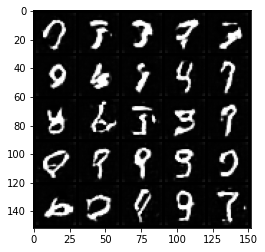

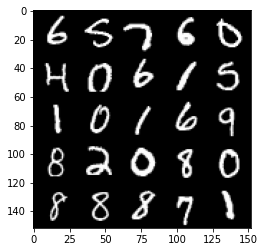

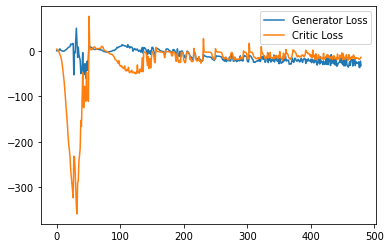

Step 9650: Generator loss: -31.92042980194092, critic loss: -14.085614399909971


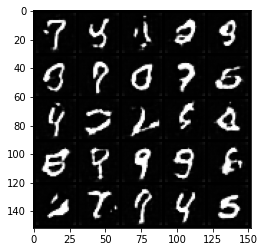

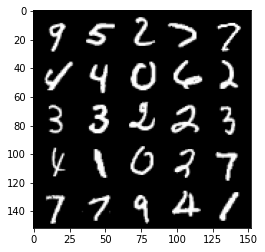

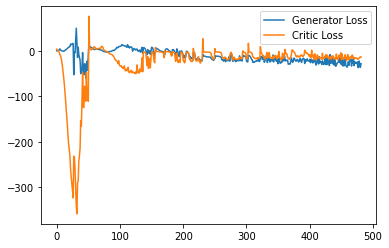

Step 9700: Generator loss: -25.640038046836853, critic loss: -13.480732494950297


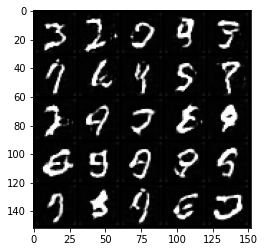

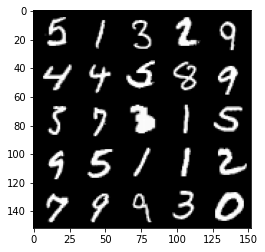

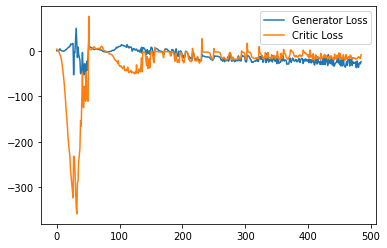

Step 9750: Generator loss: -35.580710563659665, critic loss: -20.292226917505268


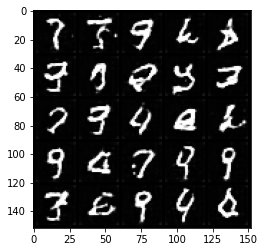

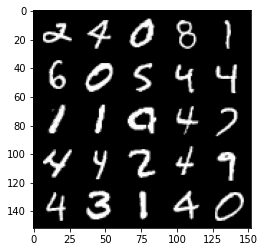

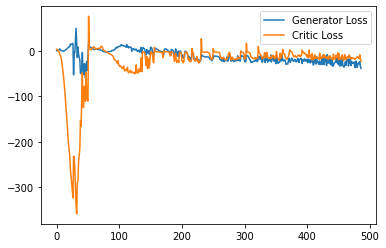

Step 9800: Generator loss: -26.75439561843872, critic loss: -20.298571975708008


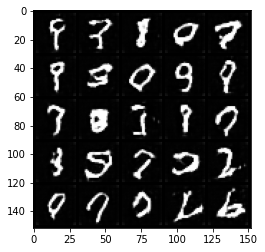

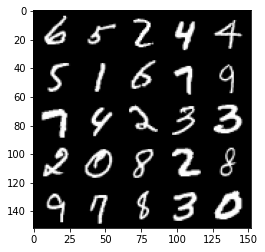

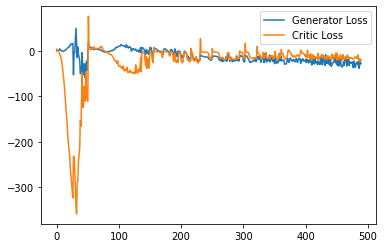

Step 9850: Generator loss: -31.238442268371582, critic loss: -16.586508578777313


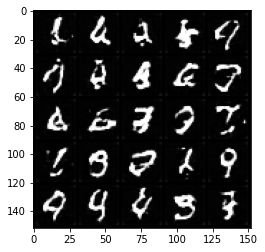

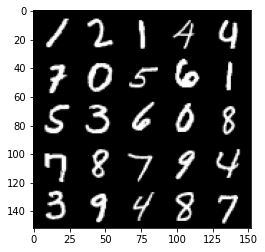

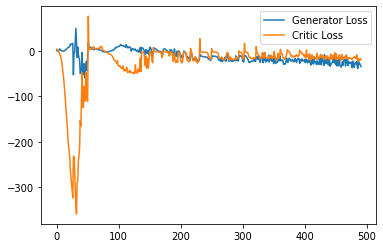

Step 9900: Generator loss: -33.47117610454559, critic loss: -19.236973808288575


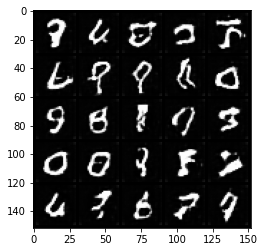

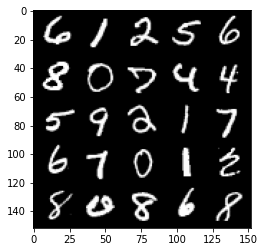

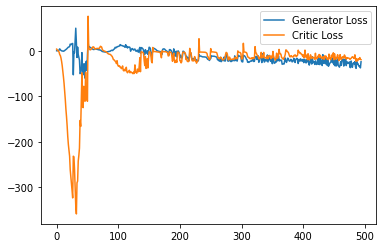

Step 9950: Generator loss: -28.13958480834961, critic loss: 5.230721596717835


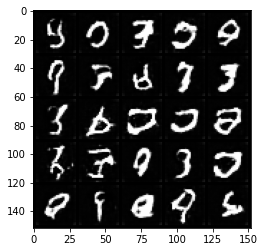

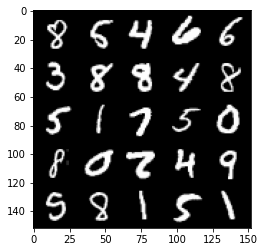

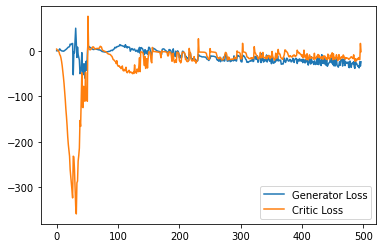

Step 10000: Generator loss: -24.621388511657713, critic loss: -2.7690827174186707


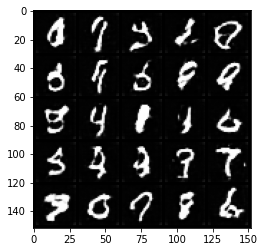

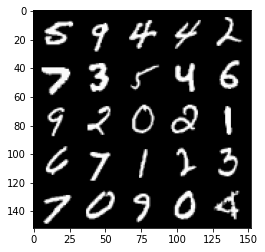

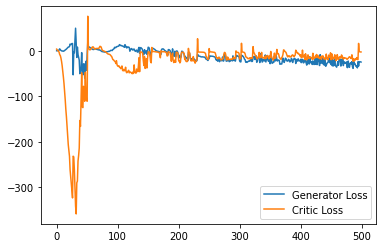

Step 10050: Generator loss: -26.33749111175537, critic loss: -2.981525413513184


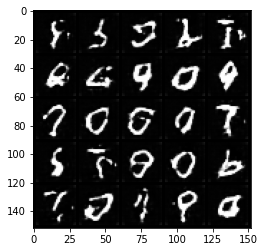

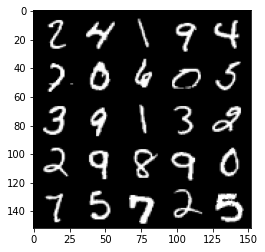

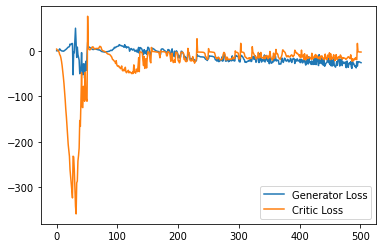

Step 10100: Generator loss: -30.08473628997803, critic loss: -3.6838192882537832


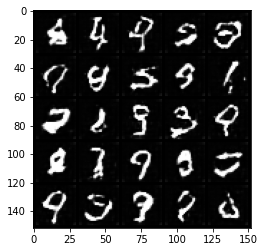

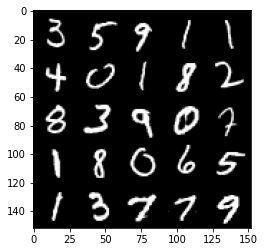

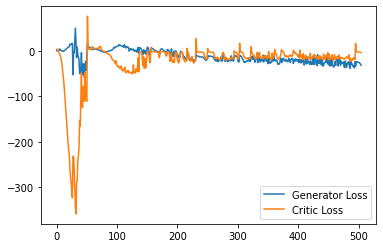

Step 10150: Generator loss: -31.071983833312988, critic loss: -9.599649327993394


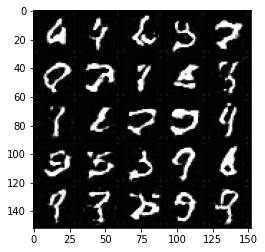

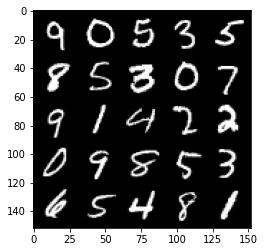

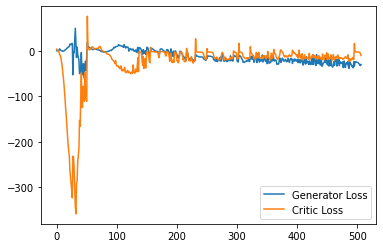

Step 10200: Generator loss: -30.95548900604248, critic loss: -11.047825210571284


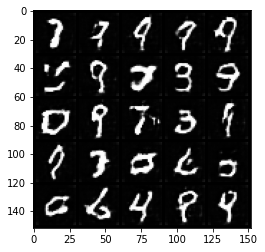

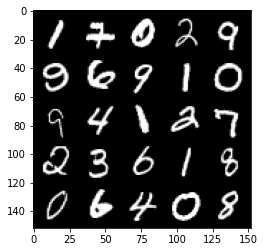

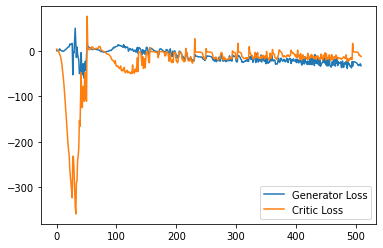

Step 10250: Generator loss: -39.802876987457275, critic loss: -18.476521391868587


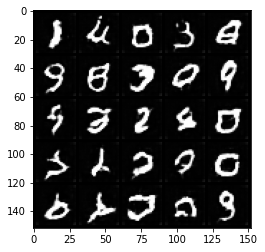

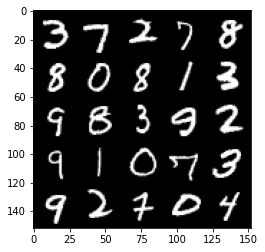

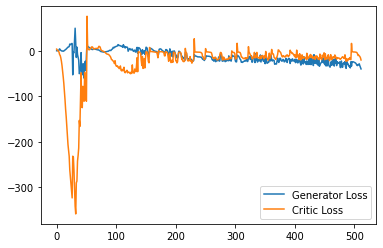

Step 10300: Generator loss: -30.47004167556763, critic loss: -17.417092555046082


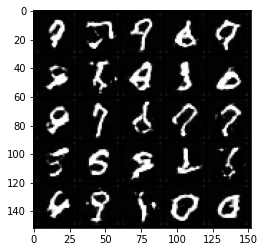

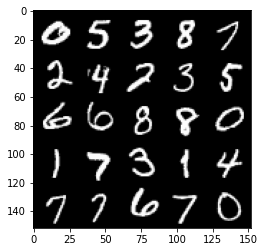

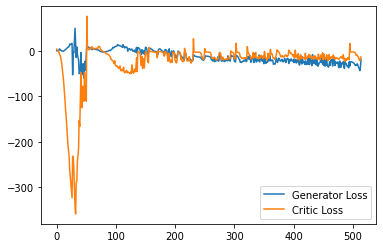

Step 10350: Generator loss: -36.30658382892609, critic loss: -18.901484559059146


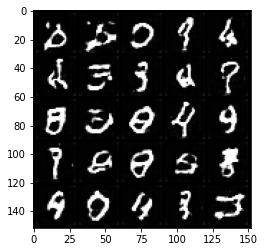

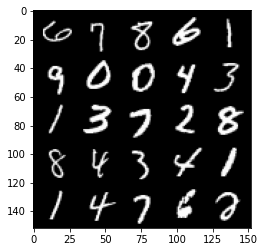

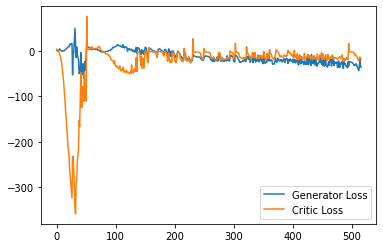

Step 10400: Generator loss: -30.620686092376708, critic loss: -7.0660690164565985


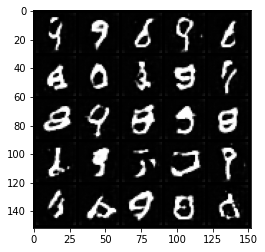

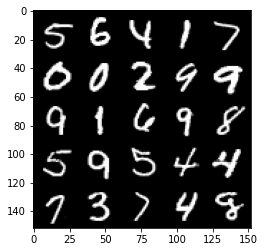

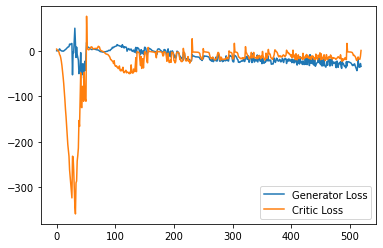

Step 10450: Generator loss: -26.666477737426757, critic loss: -4.398596762657165


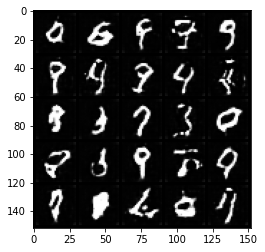

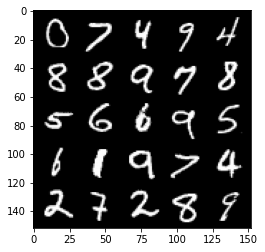

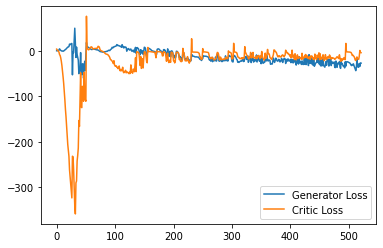

Step 10500: Generator loss: -33.20928792953491, critic loss: -11.013108075618739


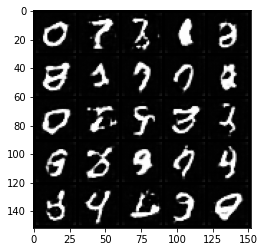

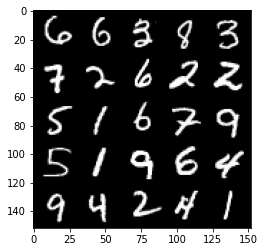

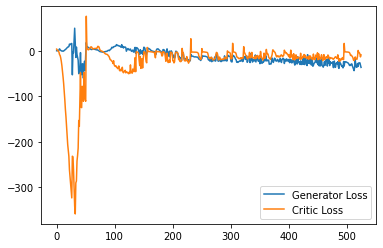

Step 10550: Generator loss: -33.457515468597414, critic loss: -17.79115356826782


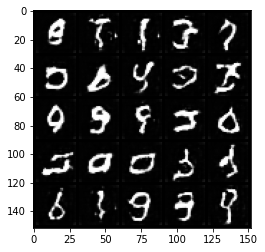

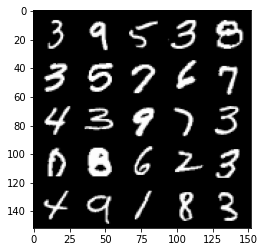

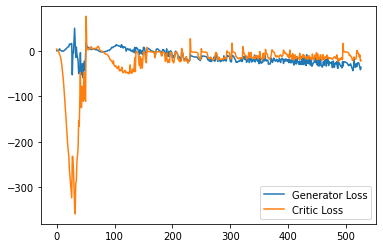

Step 10600: Generator loss: -36.80909351348877, critic loss: -17.80176168918609


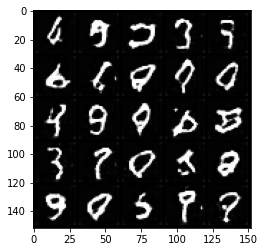

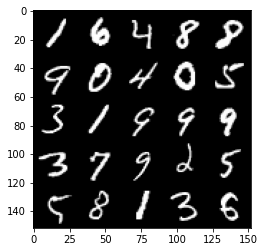

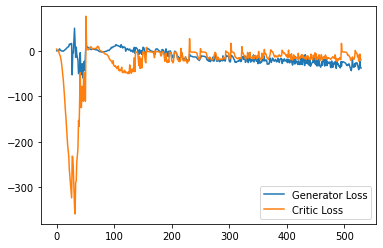

Step 10650: Generator loss: -33.65450700759888, critic loss: -16.686953914642334


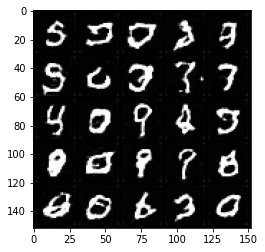

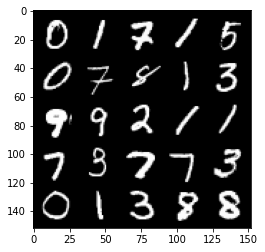

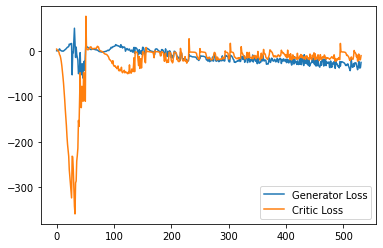

Step 10700: Generator loss: -36.31243812561035, critic loss: -19.103260629177097


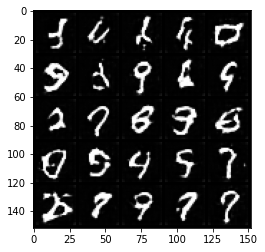

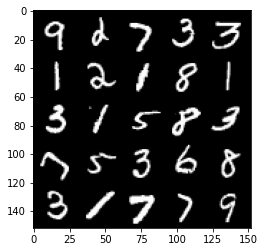

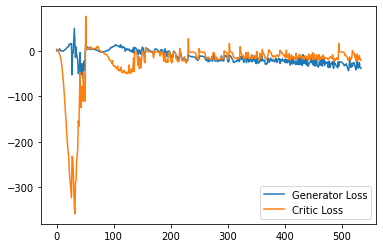

Step 10750: Generator loss: -31.482067244052885, critic loss: -15.836462461471555


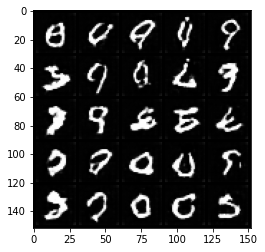

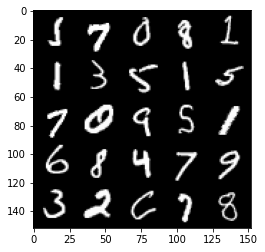

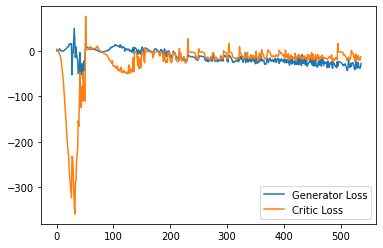

Step 10800: Generator loss: -37.25047178268433, critic loss: -12.553235349655148


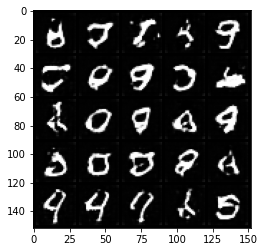

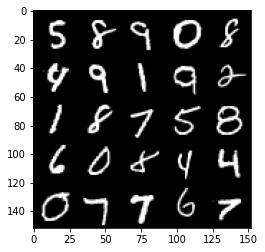

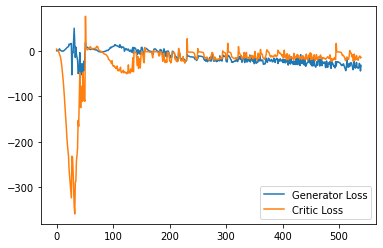

Step 10850: Generator loss: -34.08163701057434, critic loss: -17.40291578722


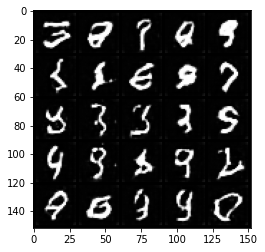

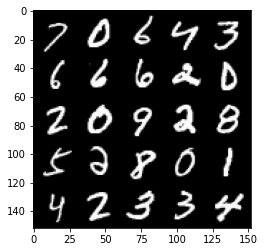

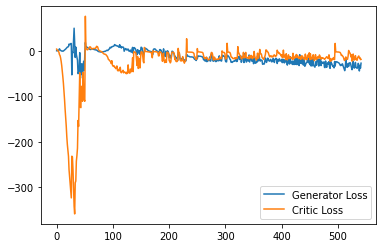

Step 10900: Generator loss: -38.82741510391235, critic loss: -15.99729023456573


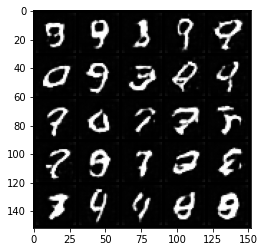

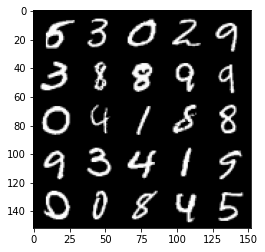

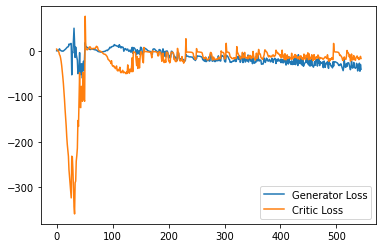

Step 10950: Generator loss: -35.01066179275513, critic loss: -10.840238802909855


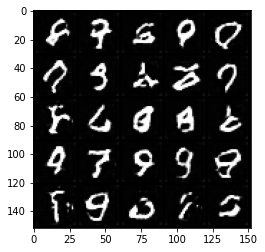

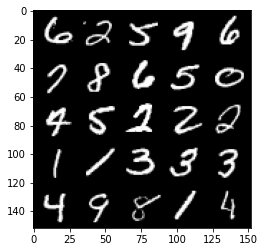

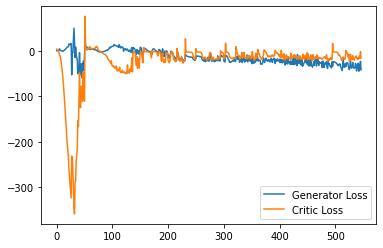

Step 11000: Generator loss: -41.54361316680908, critic loss: -21.311957788944245


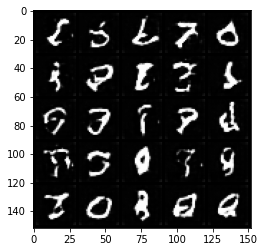

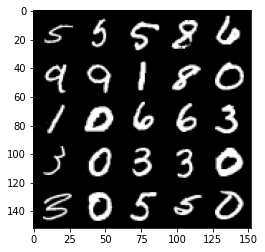

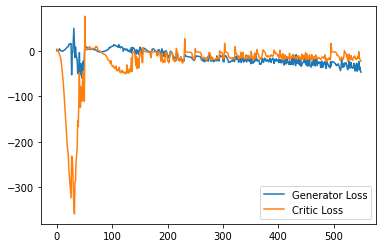

Step 11050: Generator loss: -34.07668535232544, critic loss: -16.954051476955417


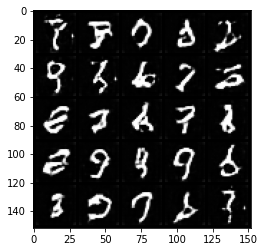

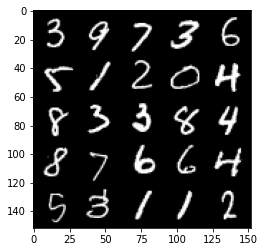

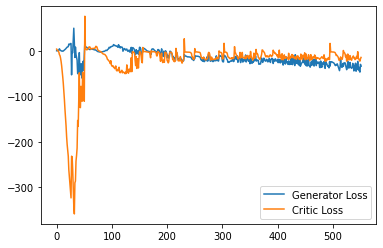

Step 11100: Generator loss: -38.13592622756958, critic loss: -11.20268936729431


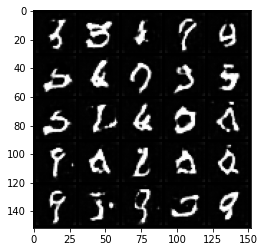

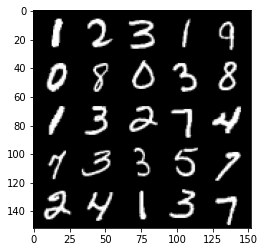

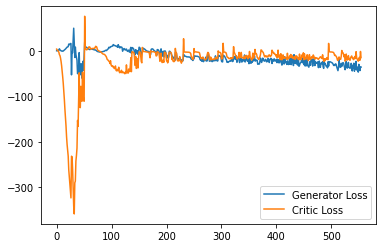

Step 11150: Generator loss: -33.58639881134033, critic loss: -15.158151978492736


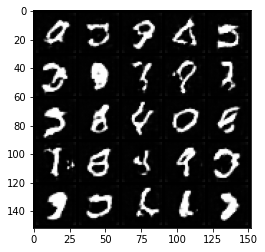

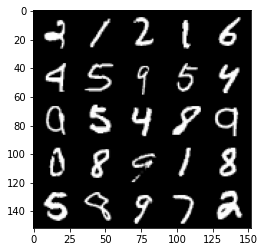

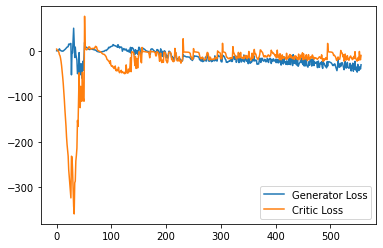

Step 11200: Generator loss: -44.6981224822998, critic loss: -21.513941875696183


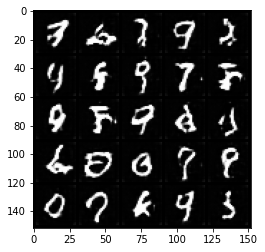

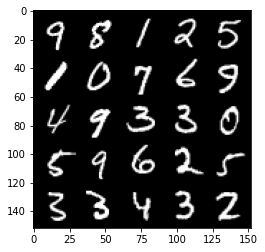

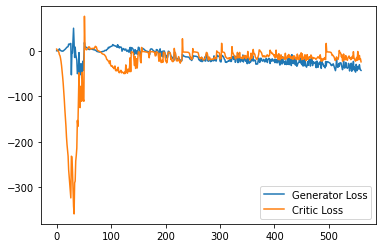

Step 11250: Generator loss: -41.173077774047854, critic loss: -18.386895146846772


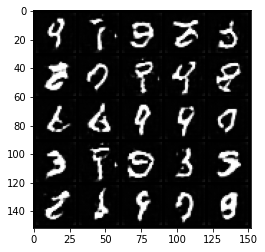

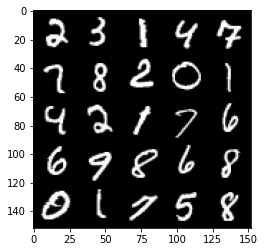

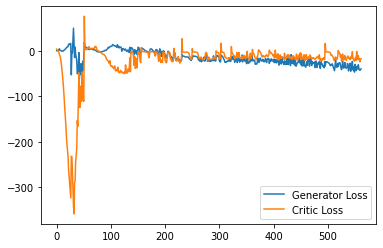

Step 11300: Generator loss: -32.29272224187851, critic loss: -17.42972158193588


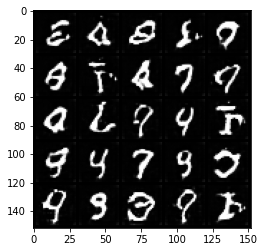

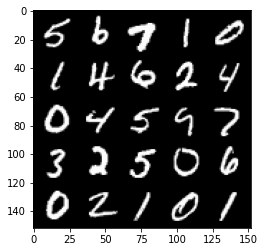

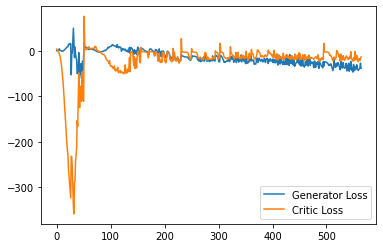

Step 11350: Generator loss: -39.6008570098877, critic loss: -16.351941508531574


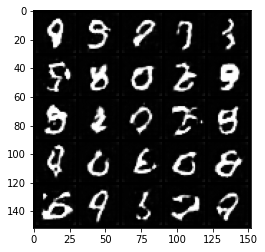

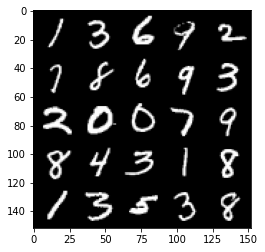

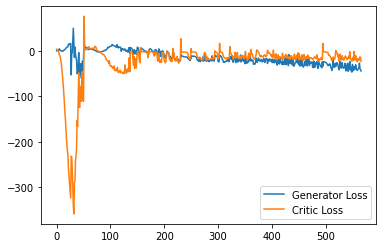

Step 11400: Generator loss: -41.50556001186371, critic loss: -21.03634162139893


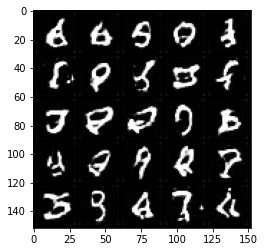

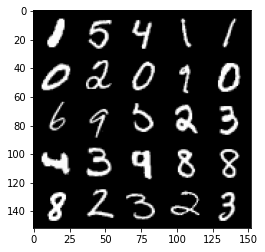

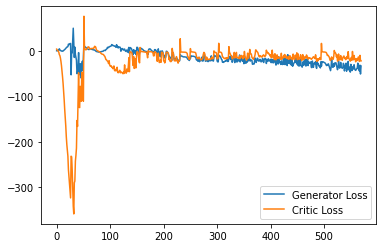

Step 11450: Generator loss: -40.24141654968262, critic loss: -19.85381004333496


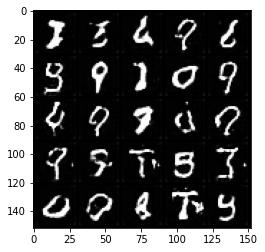

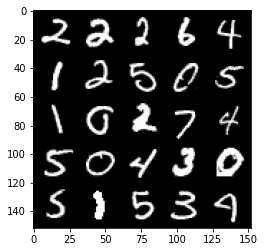

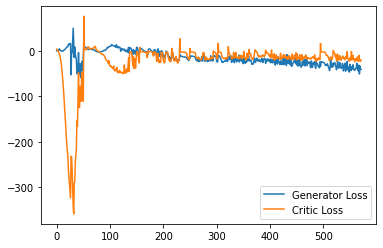

Step 11500: Generator loss: -31.337387039661408, critic loss: -13.289774836540216


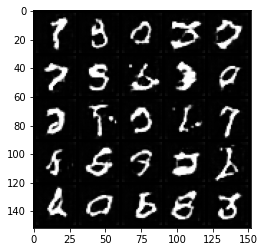

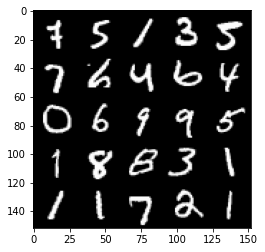

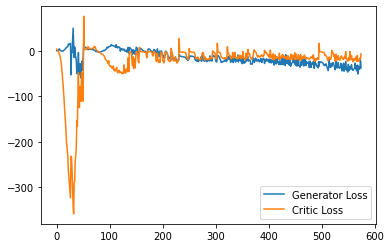

Step 11550: Generator loss: -37.66008760452271, critic loss: -14.620949520111084


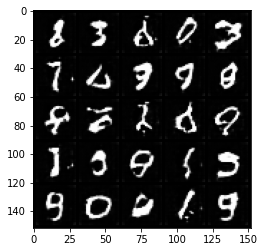

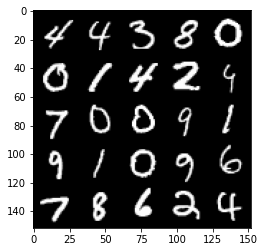

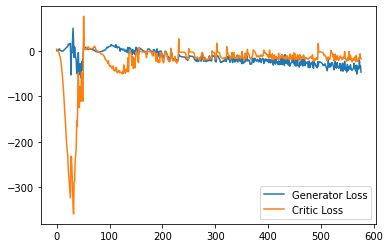

Step 11600: Generator loss: -39.07830999374389, critic loss: -16.060804348468782


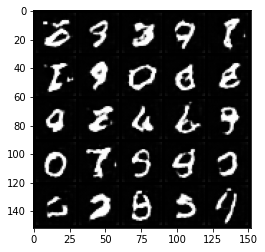

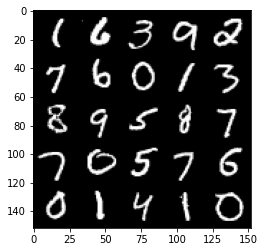

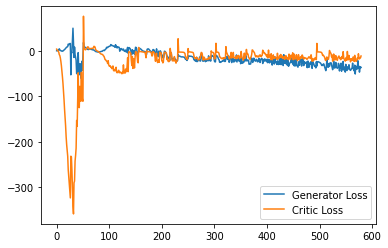

Step 11650: Generator loss: -43.213624496459964, critic loss: -17.573088476181027


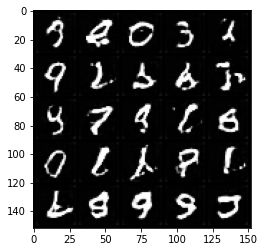

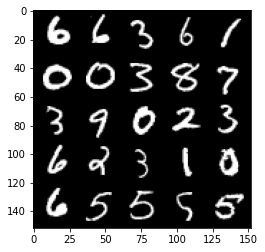

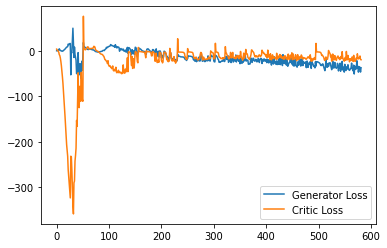

Step 11700: Generator loss: -39.19647762298584, critic loss: -18.08961256790161


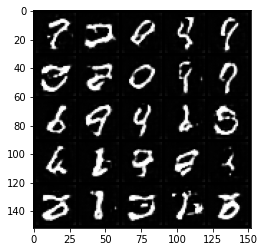

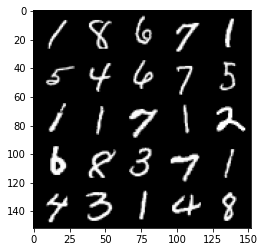

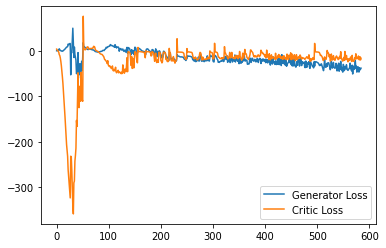

Step 11750: Generator loss: -39.70390856742859, critic loss: -20.108843852996827


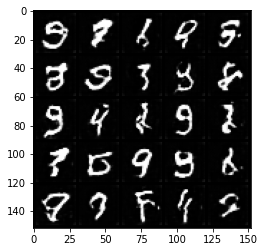

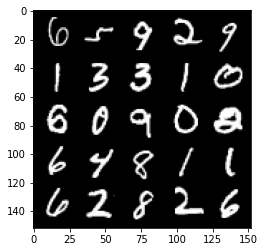

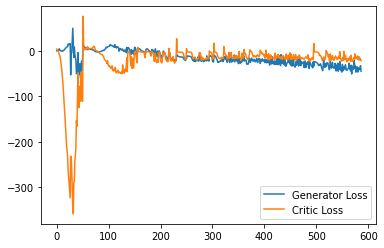

Step 11800: Generator loss: -39.086277656555175, critic loss: -16.796395565986632


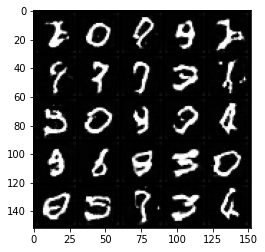

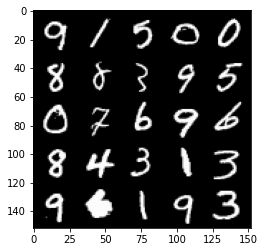

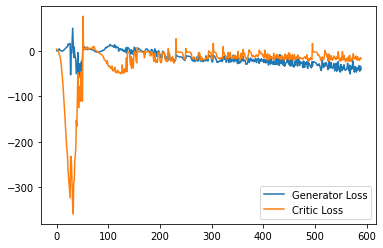

Step 11850: Generator loss: -47.61902587890625, critic loss: -21.964933931350707


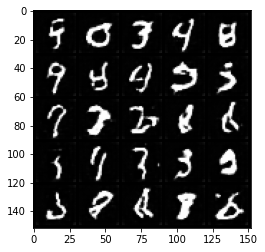

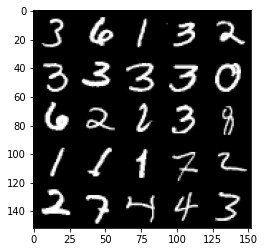

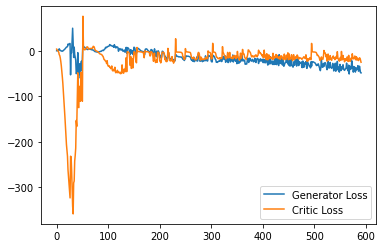

Step 11900: Generator loss: -36.528889961242676, critic loss: -16.485087779998775


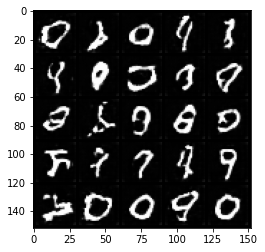

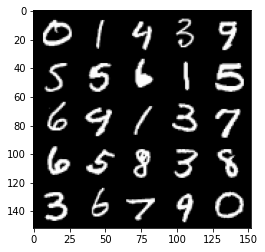

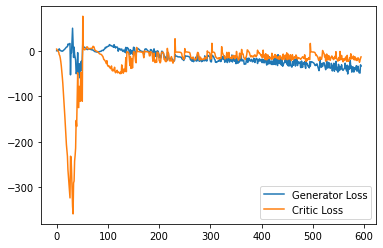

Step 11950: Generator loss: -44.1973405456543, critic loss: -17.06095817375183


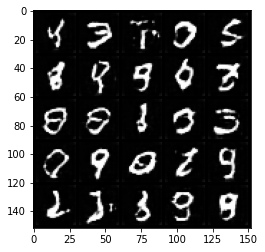

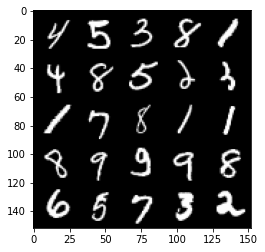

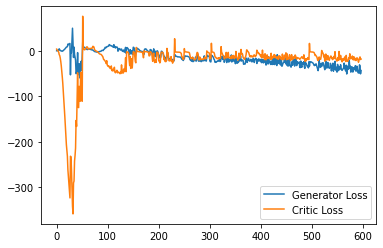

Step 12000: Generator loss: -41.65763601303101, critic loss: -6.236299339771271


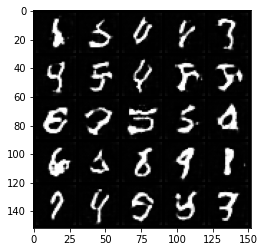

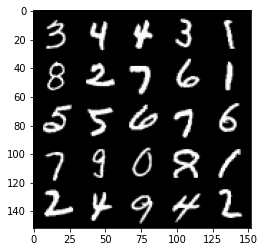

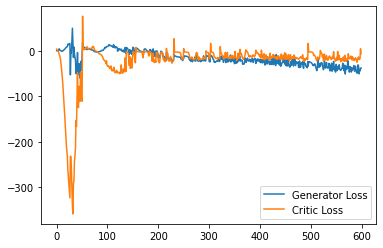

Step 12050: Generator loss: -38.76918394088745, critic loss: -13.801740966558455


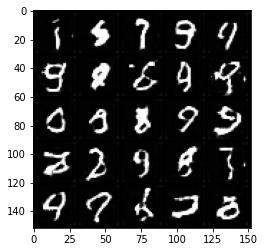

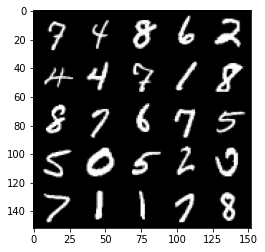

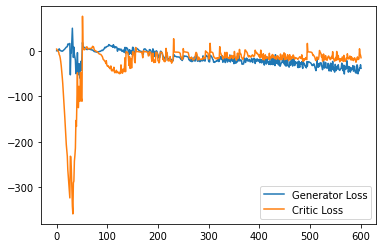

Step 12100: Generator loss: -45.511779975891116, critic loss: -21.153958525657654


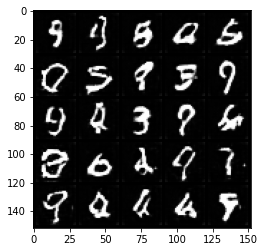

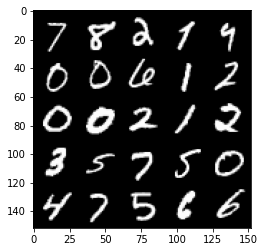

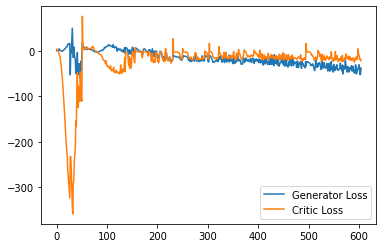

Step 12150: Generator loss: -44.84067178726196, critic loss: -16.025257495403288


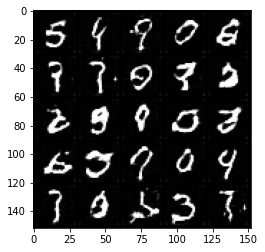

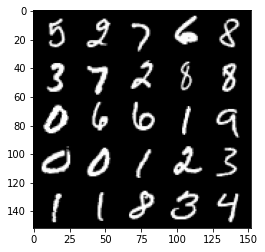

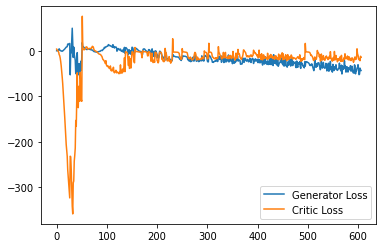

Step 12200: Generator loss: -39.660789766311645, critic loss: -16.95424764728546


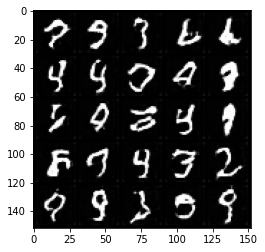

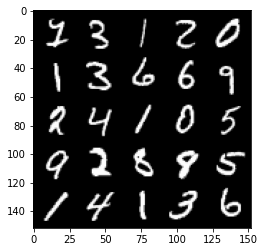

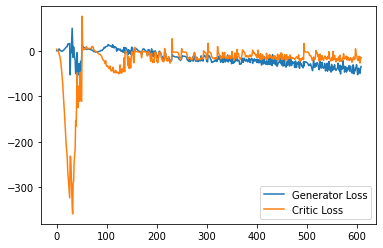

Step 12250: Generator loss: -41.64541378974914, critic loss: -14.8900621213913


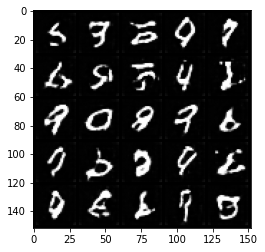

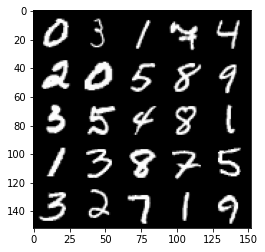

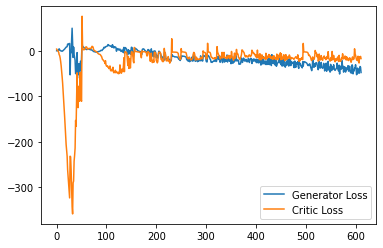

Step 12300: Generator loss: -40.27384663581848, critic loss: -15.157568540811543


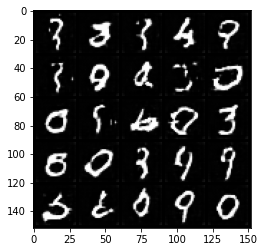

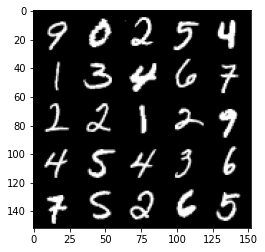

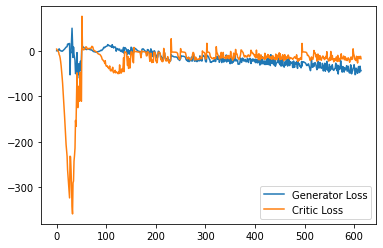

Step 12350: Generator loss: -41.129984817504884, critic loss: -10.72353318929672


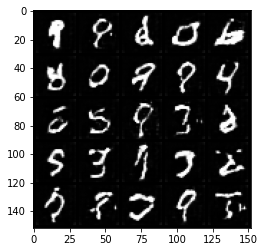

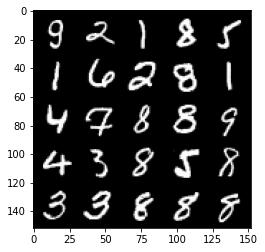

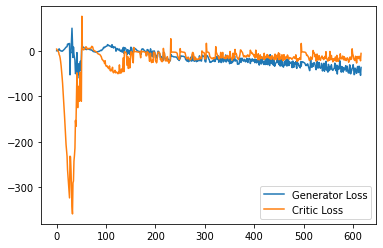

Step 12400: Generator loss: -41.28859285354614, critic loss: -16.79267130708695


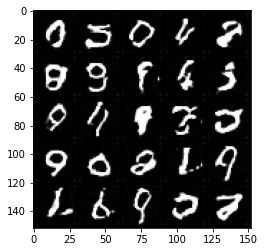

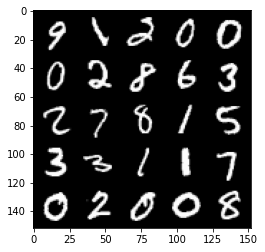

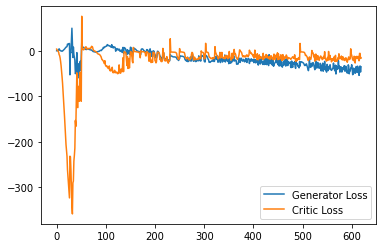

Step 12450: Generator loss: -44.27821492314339, critic loss: -21.751008549213406


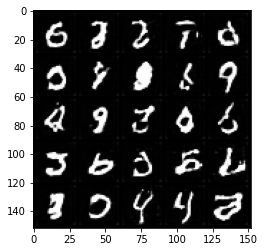

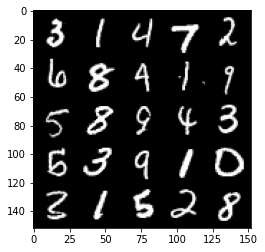

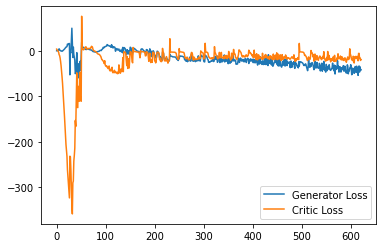

Step 12500: Generator loss: -45.341750831604, critic loss: -21.118127011299137


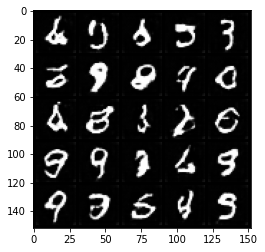

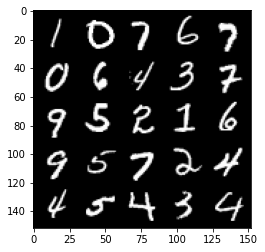

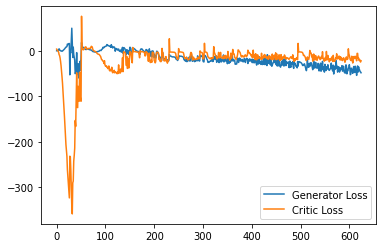

Step 12550: Generator loss: -42.96696352005005, critic loss: -21.363063971042635


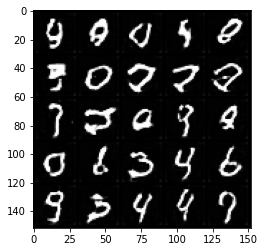

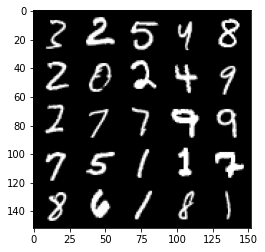

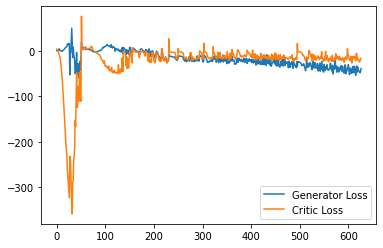

Step 12600: Generator loss: -42.921370315551755, critic loss: -15.59663057637215


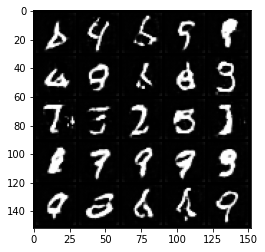

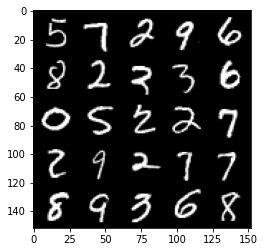

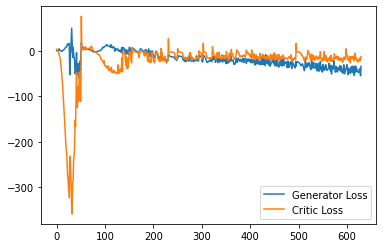

Step 12650: Generator loss: -48.32563777923584, critic loss: -21.168261360645303


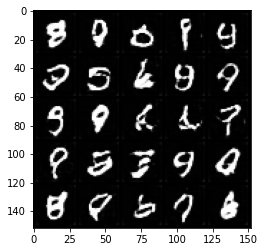

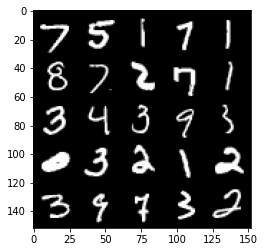

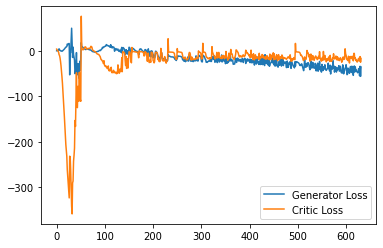

Step 12700: Generator loss: -43.39995098114014, critic loss: -13.008271535396576


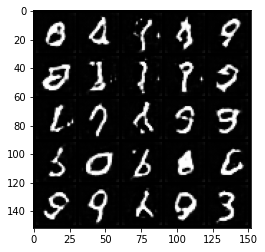

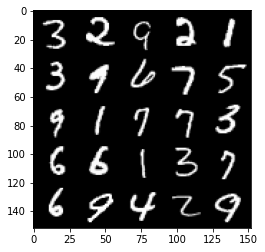

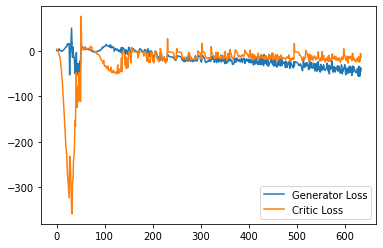

Step 12750: Generator loss: -37.200384845733645, critic loss: -10.274076287269592


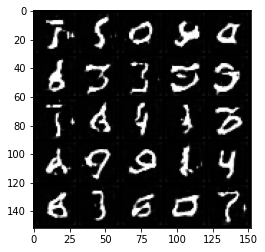

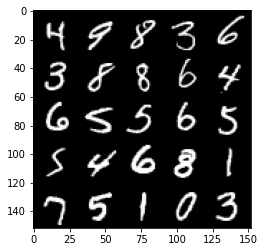

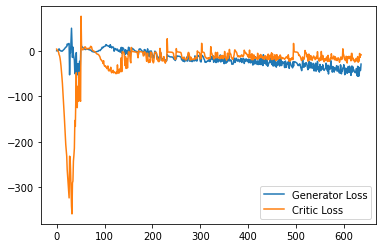

Step 12800: Generator loss: -49.303608360290525, critic loss: -16.635218059062957


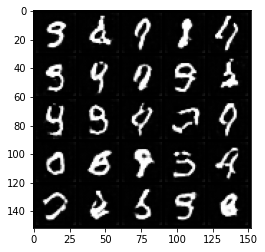

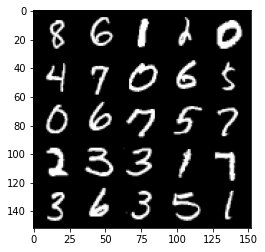

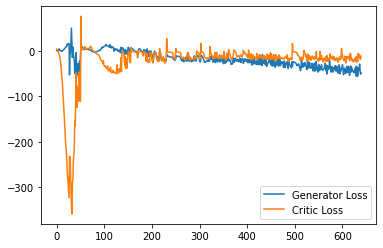

Step 12850: Generator loss: -43.4445384979248, critic loss: -13.828314127445223


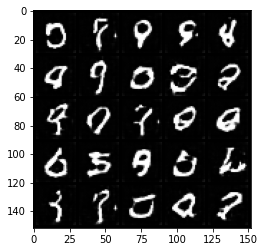

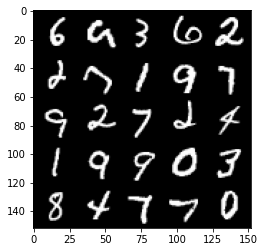

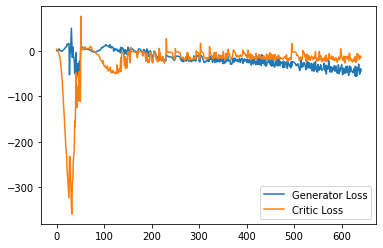

Step 12900: Generator loss: -34.01096580088139, critic loss: -16.99305280303955


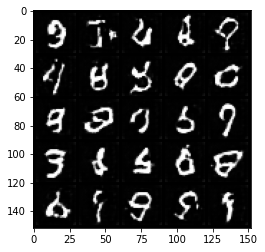

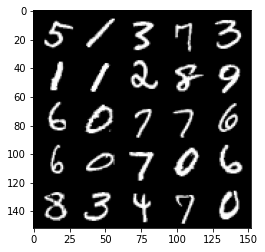

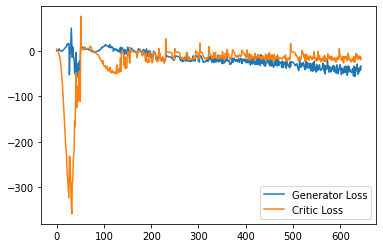

Step 12950: Generator loss: -49.60564079284668, critic loss: -19.797161523342133


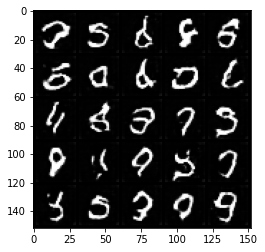

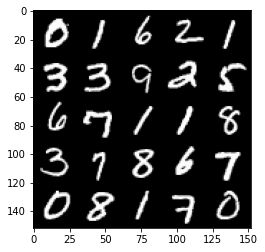

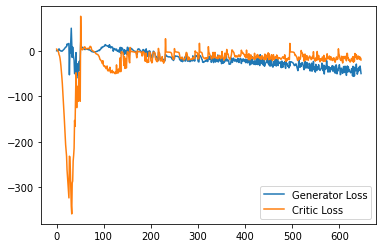

Step 13000: Generator loss: -46.24864580154419, critic loss: -19.122303540706636


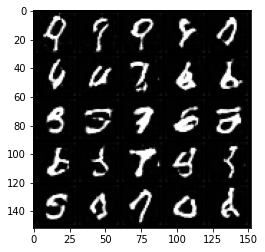

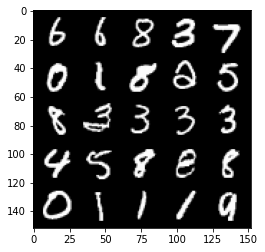

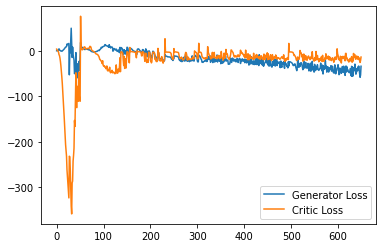

Step 13050: Generator loss: -36.434847869873046, critic loss: -13.713242490768435


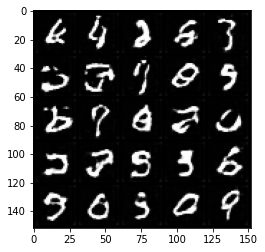

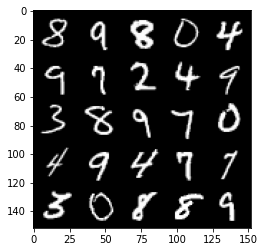

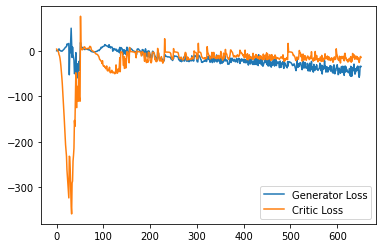

Step 13100: Generator loss: -52.707727661132814, critic loss: -20.93225591564179


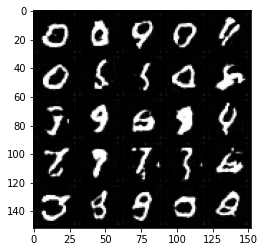

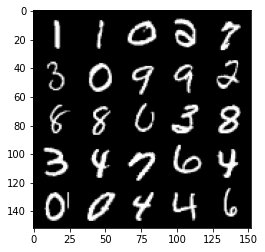

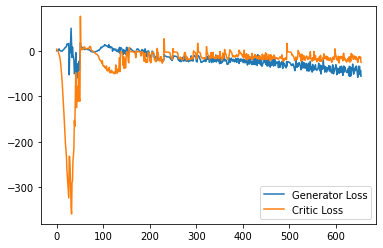

Step 13150: Generator loss: -46.267135910987854, critic loss: -20.008186622142787


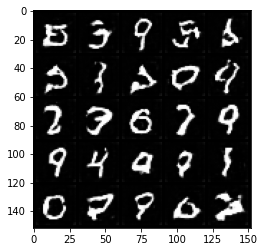

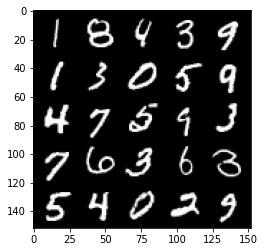

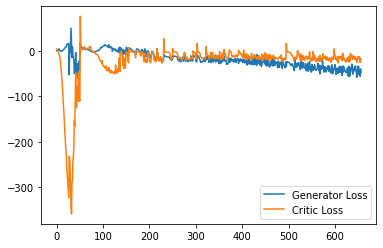

Step 13200: Generator loss: -47.360007228851316, critic loss: -13.729004408836364


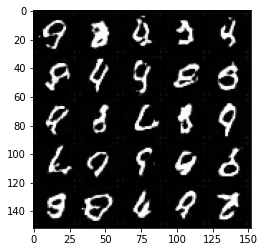

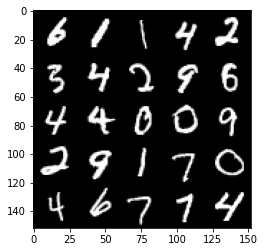

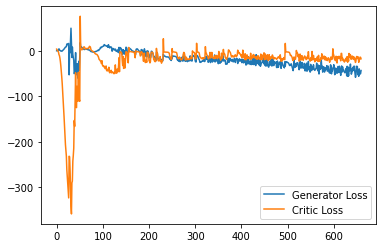

Step 13250: Generator loss: -45.20169450759888, critic loss: -18.027135639905936


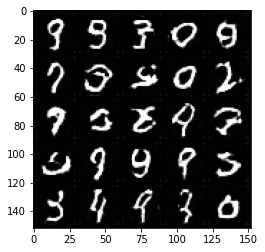

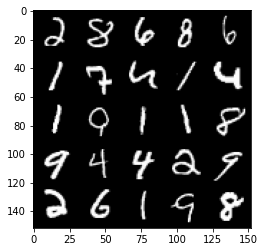

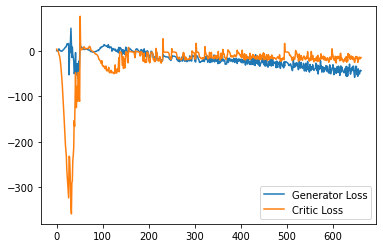

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
